# Afriat

In [1]:
scan=0.2

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{0.1}"
)

vae.save(
    dir_path,
    overwrite=True,
)

CUDA backend failed to initialize: Unable to load CUDA. Is it installed? (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_figures
ID: 3tqsqdyy
Name: balmy-universe-115
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_figures/runs/3tqsqdyy
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240503_111641-3tqsqdyy/files



GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "
SLURM auto-requeueing enabled. Setting signal handlers.


Training:   0%|                                                                                                                                                                                                                                | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|                                                                                                                                                                                                                             | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2532,3277,9434
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2532,2592,1708,3451,1640,3320
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4445,10798
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 673,832,2305
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 673,610,400,839,409,879
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1139,2671
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|▎                                                                                                                                                                                                                  | 1/600 [00:27<4:33:24, 27.39s/it]

Epoch 1/600:   0%|▎                                                                                                                                                       | 1/600 [00:27<4:33:24, 27.39s/it, v_num=yy_1, total_loss_train=3.69e+3, kl_local_train=41.2]

Epoch 2/600:   0%|▎                                                                                                                                                       | 1/600 [00:27<4:33:24, 27.39s/it, v_num=yy_1, total_loss_train=3.69e+3, kl_local_train=41.2]

Epoch 2/600:   0%|▌                                                                                                                                                       | 2/600 [00:50<4:05:43, 24.66s/it, v_num=yy_1, total_loss_train=3.69e+3, kl_local_train=41.2]

Epoch 2/600:   0%|▌                                                                                                                                                         | 2/600 [00:50<4:05:43, 24.66s/it, v_num=yy_1, total_loss_train=3.21e+3, kl_local_train=55]

Epoch 3/600:   0%|▌                                                                                                                                                         | 2/600 [00:50<4:05:43, 24.66s/it, v_num=yy_1, total_loss_train=3.21e+3, kl_local_train=55]

Epoch 3/600:   0%|▊                                                                                                                                                         | 3/600 [01:12<3:52:59, 23.42s/it, v_num=yy_1, total_loss_train=3.21e+3, kl_local_train=55]

Epoch 3/600:   0%|▊                                                                                                                                                       | 3/600 [01:12<3:52:59, 23.42s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=53.6]

Epoch 4/600:   0%|▊                                                                                                                                                       | 3/600 [01:12<3:52:59, 23.42s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=53.6]

Epoch 4/600:   1%|█                                                                                                                                                       | 4/600 [01:30<3:33:35, 21.50s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=53.6]

Epoch 4/600:   1%|█                                                                                                                                                       | 4/600 [01:30<3:33:35, 21.50s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=49.8]

Epoch 5/600:   1%|█                                                                                                                                                       | 4/600 [01:30<3:33:35, 21.50s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=49.8]

Epoch 5/600:   1%|█▎                                                                                                                                                      | 5/600 [01:49<3:23:28, 20.52s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=49.8]

Epoch 5/600:   1%|█▎                                                                                                                                                      | 5/600 [01:49<3:23:28, 20.52s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=44.1]

Epoch 6/600:   1%|█▎                                                                                                                                                      | 5/600 [01:50<3:23:28, 20.52s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=44.1]

Epoch 6/600:   1%|█▌                                                                                                                                                      | 6/600 [02:08<3:19:04, 20.11s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=44.1]

Epoch 6/600:   1%|▏                   | 6/600 [02:08<3:19:04, 20.11s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0189, metric_mi|zone_train=0.00747, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0352]

Epoch 7/600:   1%|▏                   | 6/600 [02:08<3:19:04, 20.11s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0189, metric_mi|zone_train=0.00747, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0352]

Epoch 7/600:   1%|▏                   | 7/600 [02:27<3:13:51, 19.61s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0189, metric_mi|zone_train=0.00747, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0352]

Epoch 7/600:   1%|▏                   | 7/600 [02:27<3:13:51, 19.61s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=29.3, metric_mi|status_control_train=0.0189, metric_mi|zone_train=0.00747, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0352]

Epoch 8/600:   1%|▏                   | 7/600 [02:27<3:13:51, 19.61s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=29.3, metric_mi|status_control_train=0.0189, metric_mi|zone_train=0.00747, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0352]

Epoch 8/600:   1%|▎                   | 8/600 [02:45<3:10:02, 19.26s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=29.3, metric_mi|status_control_train=0.0189, metric_mi|zone_train=0.00747, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0352]

Epoch 8/600:   1%|▎                   | 8/600 [02:45<3:10:02, 19.26s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=21.9, metric_mi|status_control_train=0.0189, metric_mi|zone_train=0.00747, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0352]

Epoch 9/600:   1%|▎                   | 8/600 [02:45<3:10:02, 19.26s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=21.9, metric_mi|status_control_train=0.0189, metric_mi|zone_train=0.00747, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0352]

Epoch 9/600:   2%|▎                   | 9/600 [03:03<3:05:36, 18.84s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=21.9, metric_mi|status_control_train=0.0189, metric_mi|zone_train=0.00747, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0352]

Epoch 9/600:   2%|▎                   | 9/600 [03:03<3:05:36, 18.84s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=22.2, metric_mi|status_control_train=0.0189, metric_mi|zone_train=0.00747, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0352]

Epoch 10/600:   2%|▎                  | 9/600 [03:03<3:05:36, 18.84s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=22.2, metric_mi|status_control_train=0.0189, metric_mi|zone_train=0.00747, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0352]

Epoch 10/600:   2%|▎                 | 10/600 [03:21<3:02:51, 18.60s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=22.2, metric_mi|status_control_train=0.0189, metric_mi|zone_train=0.00747, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0352]

Epoch 10/600:   2%|▎                 | 10/600 [03:21<3:02:51, 18.60s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=25.9, metric_mi|status_control_train=0.0189, metric_mi|zone_train=0.00747, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0352]

Epoch 11/600:   2%|▎                 | 10/600 [03:22<3:02:51, 18.60s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=25.9, metric_mi|status_control_train=0.0189, metric_mi|zone_train=0.00747, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0352]

Epoch 11/600:   2%|▎                 | 11/600 [03:41<3:07:11, 19.07s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=25.9, metric_mi|status_control_train=0.0189, metric_mi|zone_train=0.00747, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0352]

Epoch 11/600:   2%|▎                  | 11/600 [03:41<3:07:11, 19.07s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=35.9, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0476]

Epoch 12/600:   2%|▎                  | 11/600 [03:41<3:07:11, 19.07s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=35.9, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0476]

Epoch 12/600:   2%|▍                  | 12/600 [03:59<3:03:15, 18.70s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=35.9, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0476]

Epoch 12/600:   2%|▍                  | 12/600 [03:59<3:03:15, 18.70s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0476]

Epoch 13/600:   2%|▍                  | 12/600 [03:59<3:03:15, 18.70s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0476]

Epoch 13/600:   2%|▍                  | 13/600 [04:17<3:00:46, 18.48s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0476]

Epoch 13/600:   2%|▍                  | 13/600 [04:17<3:00:46, 18.48s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=55.6, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0476]

Epoch 14/600:   2%|▍                  | 13/600 [04:17<3:00:46, 18.48s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=55.6, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0476]

Epoch 14/600:   2%|▍                  | 14/600 [04:38<3:08:29, 19.30s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=55.6, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0476]

Epoch 14/600:   2%|▍                  | 14/600 [04:38<3:08:29, 19.30s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=65.3, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0476]

Epoch 15/600:   2%|▍                  | 14/600 [04:38<3:08:29, 19.30s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=65.3, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0476]

Epoch 15/600:   2%|▍                  | 15/600 [05:01<3:18:29, 20.36s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=65.3, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0476]

Epoch 15/600:   2%|▍                  | 15/600 [05:01<3:18:29, 20.36s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=72.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0476]

Epoch 16/600:   2%|▍                  | 15/600 [05:02<3:18:29, 20.36s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=72.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0476]

Epoch 16/600:   3%|▌                  | 16/600 [05:26<3:29:57, 21.57s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=72.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0476]

Epoch 16/600:   3%|▌                  | 16/600 [05:26<3:29:57, 21.57s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=82.2, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0834, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0811]

Epoch 17/600:   3%|▌                  | 16/600 [05:26<3:29:57, 21.57s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=82.2, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0834, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0811]

Epoch 17/600:   3%|▌                  | 17/600 [05:48<3:31:27, 21.76s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=82.2, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0834, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0811]

Epoch 17/600:   3%|▌                  | 17/600 [05:48<3:31:27, 21.76s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=94.1, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0834, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0811]

Epoch 18/600:   3%|▌                  | 17/600 [05:48<3:31:27, 21.76s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=94.1, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0834, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0811]

Epoch 18/600:   3%|▌                  | 18/600 [06:09<3:29:16, 21.57s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=94.1, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0834, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0811]

Epoch 18/600:   3%|▌                   | 18/600 [06:09<3:29:16, 21.57s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=104, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0834, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0811]

Epoch 19/600:   3%|▌                   | 18/600 [06:09<3:29:16, 21.57s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=104, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0834, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0811]

Epoch 19/600:   3%|▋                   | 19/600 [06:32<3:31:39, 21.86s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=104, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0834, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0811]

Epoch 19/600:   3%|▋                   | 19/600 [06:32<3:31:39, 21.86s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=111, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0834, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0811]

Epoch 20/600:   3%|▋                   | 19/600 [06:32<3:31:39, 21.86s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=111, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0834, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0811]

Epoch 20/600:   3%|▋                   | 20/600 [06:54<3:33:33, 22.09s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=111, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0834, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0811]

Epoch 20/600:   3%|▋                   | 20/600 [06:54<3:33:33, 22.09s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=117, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0834, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0811]

Epoch 21/600:   3%|▋                   | 20/600 [06:55<3:33:33, 22.09s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=117, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0834, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0811]

Epoch 21/600:   4%|▋                   | 21/600 [07:17<3:35:31, 22.33s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=117, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0834, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0811]

Epoch 21/600:   4%|▊                     | 21/600 [07:17<3:35:31, 22.33s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=120, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 22/600:   4%|▊                     | 21/600 [07:17<3:35:31, 22.33s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=120, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 22/600:   4%|▊                     | 22/600 [07:38<3:32:00, 22.01s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=120, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 22/600:   4%|▊                     | 22/600 [07:38<3:32:00, 22.01s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=122, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 23/600:   4%|▊                     | 22/600 [07:38<3:32:00, 22.01s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=122, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 23/600:   4%|▊                     | 23/600 [07:59<3:29:11, 21.75s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=122, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 23/600:   4%|▊                     | 23/600 [07:59<3:29:11, 21.75s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=118, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 24/600:   4%|▊                     | 23/600 [07:59<3:29:11, 21.75s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=118, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 24/600:   4%|▉                     | 24/600 [08:21<3:27:32, 21.62s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=118, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 24/600:   4%|▉                     | 24/600 [08:21<3:27:32, 21.62s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=118, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 25/600:   4%|▉                     | 24/600 [08:21<3:27:32, 21.62s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=118, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 25/600:   4%|▉                     | 25/600 [08:42<3:26:30, 21.55s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=118, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 25/600:   4%|▉                     | 25/600 [08:42<3:26:30, 21.55s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=116, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 26/600:   4%|▉                     | 25/600 [08:43<3:26:30, 21.55s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=116, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 26/600:   4%|▉                     | 26/600 [09:02<3:21:16, 21.04s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=116, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 26/600:   4%|█                       | 26/600 [09:02<3:21:16, 21.04s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=113, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 27/600:   4%|█                       | 26/600 [09:02<3:21:16, 21.04s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=113, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 27/600:   4%|█                       | 27/600 [09:23<3:20:28, 20.99s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=113, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 27/600:   4%|█                       | 27/600 [09:23<3:20:28, 20.99s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=112, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 28/600:   4%|█                       | 27/600 [09:23<3:20:28, 20.99s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=112, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 28/600:   5%|█                       | 28/600 [09:44<3:20:59, 21.08s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=112, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 28/600:   5%|█                       | 28/600 [09:44<3:20:59, 21.08s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=114, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 29/600:   5%|█                       | 28/600 [09:44<3:20:59, 21.08s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=114, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 29/600:   5%|█▏                      | 29/600 [10:05<3:20:51, 21.11s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=114, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 29/600:   5%|█▏                      | 29/600 [10:05<3:20:51, 21.11s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=111, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 30/600:   5%|█▏                      | 29/600 [10:05<3:20:51, 21.11s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=111, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 30/600:   5%|█▏                      | 30/600 [10:28<3:25:03, 21.58s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=111, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 30/600:   5%|█▏                      | 30/600 [10:28<3:25:03, 21.58s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=112, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 31/600:   5%|█▏                      | 30/600 [10:29<3:25:03, 21.58s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=112, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 31/600:   5%|█▏                      | 31/600 [10:52<3:32:14, 22.38s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=112, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 31/600:   5%|█▎                       | 31/600 [10:52<3:32:14, 22.38s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=113, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 32/600:   5%|█▎                       | 31/600 [10:52<3:32:14, 22.38s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=113, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 32/600:   5%|█▎                       | 32/600 [11:15<3:33:06, 22.51s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=113, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 32/600:   5%|█▎                       | 32/600 [11:15<3:33:06, 22.51s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 33/600:   5%|█▎                       | 32/600 [11:15<3:33:06, 22.51s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 33/600:   6%|█▍                       | 33/600 [11:38<3:33:40, 22.61s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 33/600:   6%|█▍                       | 33/600 [11:38<3:33:40, 22.61s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 34/600:   6%|█▍                       | 33/600 [11:38<3:33:40, 22.61s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 34/600:   6%|█▍                       | 34/600 [12:01<3:33:43, 22.66s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 34/600:   6%|█▍                       | 34/600 [12:01<3:33:43, 22.66s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 35/600:   6%|█▍                       | 34/600 [12:01<3:33:43, 22.66s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 35/600:   6%|█▍                       | 35/600 [12:23<3:33:35, 22.68s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 35/600:   6%|█▍                       | 35/600 [12:23<3:33:35, 22.68s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=117, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 36/600:   6%|█▍                       | 35/600 [12:25<3:33:35, 22.68s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=117, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 36/600:   6%|█▌                       | 36/600 [12:48<3:38:55, 23.29s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=117, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 36/600:   6%|█▌                       | 36/600 [12:48<3:38:55, 23.29s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=119, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.13]

Epoch 37/600:   6%|█▌                       | 36/600 [12:48<3:38:55, 23.29s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=119, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.13]

Epoch 37/600:   6%|█▌                       | 37/600 [13:11<3:37:07, 23.14s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=119, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.13]

Epoch 37/600:   6%|█▌                       | 37/600 [13:11<3:37:07, 23.14s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=122, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.13]

Epoch 38/600:   6%|█▌                       | 37/600 [13:11<3:37:07, 23.14s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=122, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.13]

Epoch 38/600:   6%|█▌                       | 38/600 [13:34<3:35:33, 23.01s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=122, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.13]

Epoch 38/600:   6%|█▌                       | 38/600 [13:34<3:35:33, 23.01s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=120, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.13]

Epoch 39/600:   6%|█▌                       | 38/600 [13:34<3:35:33, 23.01s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=120, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.13]

Epoch 39/600:   6%|█▋                       | 39/600 [13:56<3:34:24, 22.93s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=120, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.13]

Epoch 39/600:   6%|█▋                       | 39/600 [13:56<3:34:24, 22.93s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=119, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.13]

Epoch 40/600:   6%|█▋                       | 39/600 [13:56<3:34:24, 22.93s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=119, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.13]

Epoch 40/600:   7%|█▋                       | 40/600 [14:19<3:33:31, 22.88s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=119, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.13]

Epoch 40/600:   7%|█▋                       | 40/600 [14:19<3:33:31, 22.88s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=120, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.13]

Epoch 41/600:   7%|█▋                       | 40/600 [14:20<3:33:31, 22.88s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=120, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.13]

Epoch 41/600:   7%|█▋                       | 41/600 [14:39<3:24:24, 21.94s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=120, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.13]

Epoch 41/600:   7%|█▋                      | 41/600 [14:39<3:24:24, 21.94s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=119, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.133]

Epoch 42/600:   7%|█▋                      | 41/600 [14:39<3:24:24, 21.94s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=119, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.133]

Epoch 42/600:   7%|█▋                      | 42/600 [14:57<3:13:22, 20.79s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=119, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.133]

Epoch 42/600:   7%|█▋                      | 42/600 [14:57<3:13:22, 20.79s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=120, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.133]

Epoch 43/600:   7%|█▋                      | 42/600 [14:57<3:13:22, 20.79s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=120, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.133]

Epoch 43/600:   7%|█▋                      | 43/600 [15:15<3:05:32, 19.99s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=120, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.133]

Epoch 43/600:   7%|█▋                      | 43/600 [15:15<3:05:32, 19.99s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=119, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.133]

Epoch 44/600:   7%|█▋                      | 43/600 [15:15<3:05:32, 19.99s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=119, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.133]

Epoch 44/600:   7%|█▊                      | 44/600 [15:38<3:13:29, 20.88s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=119, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.133]

Epoch 44/600:   7%|█▊                      | 44/600 [15:38<3:13:29, 20.88s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=120, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.133]

Epoch 45/600:   7%|█▊                      | 44/600 [15:38<3:13:29, 20.88s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=120, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.133]

Epoch 45/600:   8%|█▊                      | 45/600 [16:01<3:19:37, 21.58s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=120, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.133]

Epoch 45/600:   8%|█▊                      | 45/600 [16:01<3:19:37, 21.58s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=119, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.133]

Epoch 46/600:   8%|█▊                      | 45/600 [16:02<3:19:37, 21.58s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=119, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.133]

Epoch 46/600:   8%|█▊                      | 46/600 [16:26<3:28:32, 22.58s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=119, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.133]

Epoch 46/600:   8%|█▉                        | 46/600 [16:26<3:28:32, 22.58s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=120, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.137]

Epoch 47/600:   8%|█▉                        | 46/600 [16:26<3:28:32, 22.58s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=120, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.137]

Epoch 47/600:   8%|██                        | 47/600 [16:49<3:29:47, 22.76s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=120, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.137]

Epoch 47/600:   8%|██                        | 47/600 [16:49<3:29:47, 22.76s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=119, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.137]

Epoch 48/600:   8%|██                        | 47/600 [16:49<3:29:47, 22.76s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=119, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.137]

Epoch 48/600:   8%|██                        | 48/600 [17:13<3:31:24, 22.98s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=119, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.137]

Epoch 48/600:   8%|██                        | 48/600 [17:13<3:31:24, 22.98s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=120, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.137]

Epoch 49/600:   8%|██                        | 48/600 [17:13<3:31:24, 22.98s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=120, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.137]

Epoch 49/600:   8%|██                        | 49/600 [17:36<3:31:03, 22.98s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=120, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.137]

Epoch 49/600:   8%|██                        | 49/600 [17:36<3:31:03, 22.98s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=121, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.137]

Epoch 50/600:   8%|██                        | 49/600 [17:36<3:31:03, 22.98s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=121, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.137]

Epoch 50/600:   8%|██▏                       | 50/600 [17:59<3:31:02, 23.02s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=121, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.137]

Epoch 50/600:   8%|██                       | 50/600 [17:59<3:31:02, 23.02s/it, v_num=yy_1, total_loss_train=3.21e+3, kl_local_train=120, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.137]

Epoch 51/600:   8%|██                       | 50/600 [18:00<3:31:02, 23.02s/it, v_num=yy_1, total_loss_train=3.21e+3, kl_local_train=120, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.137]

Epoch 51/600:   8%|██▏                      | 51/600 [18:21<3:27:30, 22.68s/it, v_num=yy_1, total_loss_train=3.21e+3, kl_local_train=120, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.137]

Epoch 51/600:   8%|██▏                      | 51/600 [18:21<3:27:30, 22.68s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=120, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.138]

Epoch 52/600:   8%|██▏                      | 51/600 [18:21<3:27:30, 22.68s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=120, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.138]

Epoch 52/600:   9%|██▏                      | 52/600 [18:40<3:17:08, 21.58s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=120, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.138]

Epoch 52/600:   9%|██▏                      | 52/600 [18:40<3:17:08, 21.58s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=119, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.138]

Epoch 53/600:   9%|██▏                      | 52/600 [18:40<3:17:08, 21.58s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=119, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.138]

Epoch 53/600:   9%|██▏                      | 53/600 [19:01<3:16:17, 21.53s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=119, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.138]

Epoch 53/600:   9%|██▏                      | 53/600 [19:01<3:16:17, 21.53s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=117, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.138]

Epoch 54/600:   9%|██▏                      | 53/600 [19:01<3:16:17, 21.53s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=117, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.138]

Epoch 54/600:   9%|██▎                      | 54/600 [19:21<3:10:03, 20.89s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=117, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.138]

Epoch 54/600:   9%|██▎                      | 54/600 [19:21<3:10:03, 20.89s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=116, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.138]

Epoch 55/600:   9%|██▎                      | 54/600 [19:21<3:10:03, 20.89s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=116, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.138]

Epoch 55/600:   9%|██▎                      | 55/600 [19:43<3:14:13, 21.38s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=116, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.138]

Epoch 55/600:   9%|██▎                      | 55/600 [19:43<3:14:13, 21.38s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=116, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.138]

Epoch 56/600:   9%|██▎                      | 55/600 [19:44<3:14:13, 21.38s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=116, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.138]

Epoch 56/600:   9%|██▎                      | 56/600 [20:07<3:20:50, 22.15s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=116, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.138]

Epoch 56/600:   9%|██▎                      | 56/600 [20:07<3:20:50, 22.15s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=115, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.137]

Epoch 57/600:   9%|██▎                      | 56/600 [20:07<3:20:50, 22.15s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=115, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.137]

Epoch 57/600:  10%|██▍                      | 57/600 [20:30<3:21:47, 22.30s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=115, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.137]

Epoch 57/600:  10%|██▍                      | 57/600 [20:30<3:21:47, 22.30s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=114, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.137]

Epoch 58/600:  10%|██▍                      | 57/600 [20:30<3:21:47, 22.30s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=114, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.137]

Epoch 58/600:  10%|██▍                      | 58/600 [20:52<3:21:08, 22.27s/it, v_num=yy_1, total_loss_train=3.2e+3, kl_local_train=114, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.137]

Epoch 58/600:  10%|██▎                     | 58/600 [20:52<3:21:08, 22.27s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.137]

Epoch 59/600:  10%|██▎                     | 58/600 [20:52<3:21:08, 22.27s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.137]

Epoch 59/600:  10%|██▎                     | 59/600 [21:17<3:27:18, 22.99s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.137]

Epoch 59/600:  10%|██▎                     | 59/600 [21:17<3:27:18, 22.99s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.137]

Epoch 60/600:  10%|██▎                     | 59/600 [21:17<3:27:18, 22.99s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.137]

Epoch 60/600:  10%|██▍                     | 60/600 [21:40<3:28:12, 23.14s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.137]

Epoch 60/600:  10%|██▍                     | 60/600 [21:40<3:28:12, 23.14s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.137]

Epoch 61/600:  10%|██▍                     | 60/600 [21:41<3:28:12, 23.14s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.137]

Epoch 61/600:  10%|██▍                     | 61/600 [22:04<3:29:10, 23.29s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.137]

Epoch 61/600:  10%|██▍                     | 61/600 [22:04<3:29:10, 23.29s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=110, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.136]

Epoch 62/600:  10%|██▍                     | 61/600 [22:04<3:29:10, 23.29s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=110, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.136]

Epoch 62/600:  10%|██▍                     | 62/600 [22:22<3:15:17, 21.78s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=110, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.136]

Epoch 62/600:  10%|██▍                     | 62/600 [22:22<3:15:17, 21.78s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=109, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.136]

Epoch 63/600:  10%|██▍                     | 62/600 [22:22<3:15:17, 21.78s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=109, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.136]

Epoch 63/600:  10%|██▌                     | 63/600 [22:45<3:18:02, 22.13s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=109, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.136]

Epoch 63/600:  10%|██▌                     | 63/600 [22:45<3:18:02, 22.13s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=109, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.136]

Epoch 64/600:  10%|██▌                     | 63/600 [22:45<3:18:02, 22.13s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=109, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.136]

Epoch 64/600:  11%|██▌                     | 64/600 [23:08<3:18:53, 22.26s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=109, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.136]

Epoch 64/600:  11%|██▌                     | 64/600 [23:08<3:18:53, 22.26s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=108, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.136]

Epoch 65/600:  11%|██▌                     | 64/600 [23:08<3:18:53, 22.26s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=108, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.136]

Epoch 65/600:  11%|██▌                     | 65/600 [23:31<3:21:43, 22.62s/it, v_num=yy_1, total_loss_train=3.19e+3, kl_local_train=108, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.136]

Epoch 65/600:  11%|██▌                     | 65/600 [23:31<3:21:43, 22.62s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.136]

Epoch 66/600:  11%|██▌                     | 65/600 [23:32<3:21:43, 22.62s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.136]

Epoch 66/600:  11%|██▋                     | 66/600 [23:55<3:24:01, 22.92s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.136]

Epoch 66/600:  11%|██▋                     | 66/600 [23:55<3:24:01, 22.92s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=106, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.136]

Epoch 67/600:  11%|██▋                     | 66/600 [23:55<3:24:01, 22.92s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=106, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.136]

Epoch 67/600:  11%|██▋                     | 67/600 [24:14<3:14:40, 21.91s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=106, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.136]

Epoch 67/600:  11%|██▋                     | 67/600 [24:14<3:14:40, 21.91s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=106, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.136]

Epoch 68/600:  11%|██▋                     | 67/600 [24:14<3:14:40, 21.91s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=106, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.136]

Epoch 68/600:  11%|██▋                     | 68/600 [24:37<3:17:53, 22.32s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=106, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.136]

Epoch 68/600:  11%|██▋                     | 68/600 [24:37<3:17:53, 22.32s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.136]

Epoch 69/600:  11%|██▋                     | 68/600 [24:38<3:17:53, 22.32s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.136]

Epoch 69/600:  12%|██▊                     | 69/600 [25:01<3:19:56, 22.59s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.136]

Epoch 69/600:  12%|██▊                     | 69/600 [25:01<3:19:56, 22.59s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.136]

Epoch 70/600:  12%|██▊                     | 69/600 [25:01<3:19:56, 22.59s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.136]

Epoch 70/600:  12%|██▊                     | 70/600 [25:24<3:21:17, 22.79s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.136]

Epoch 70/600:  12%|██▊                     | 70/600 [25:24<3:21:17, 22.79s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=103, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.136]

Epoch 71/600:  12%|██▊                     | 70/600 [25:25<3:21:17, 22.79s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=103, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.136]

Epoch 71/600:  12%|██▊                     | 71/600 [25:44<3:14:04, 22.01s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=103, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.136]

Epoch 71/600:  12%|██▊                     | 71/600 [25:44<3:14:04, 22.01s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=103, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.137]

Epoch 72/600:  12%|██▊                     | 71/600 [25:44<3:14:04, 22.01s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=103, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.137]

Epoch 72/600:  12%|██▉                     | 72/600 [26:06<3:13:19, 21.97s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=103, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.137]

Epoch 72/600:  12%|██▉                     | 72/600 [26:06<3:13:19, 21.97s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.137]

Epoch 73/600:  12%|██▉                     | 72/600 [26:06<3:13:19, 21.97s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.137]

Epoch 73/600:  12%|██▉                     | 73/600 [26:25<3:04:07, 20.96s/it, v_num=yy_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.137]

Epoch 73/600:  12%|██▉                     | 73/600 [26:25<3:04:07, 20.96s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=100, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.137]

Epoch 74/600:  12%|██▉                     | 73/600 [26:25<3:04:07, 20.96s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=100, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.137]

Epoch 74/600:  12%|██▉                     | 74/600 [26:46<3:04:05, 21.00s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=100, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.137]

Epoch 74/600:  12%|██▊                    | 74/600 [26:46<3:04:05, 21.00s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=99.7, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.137]

Epoch 75/600:  12%|██▊                    | 74/600 [26:46<3:04:05, 21.00s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=99.7, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.137]

Epoch 75/600:  12%|██▉                    | 75/600 [27:08<3:06:17, 21.29s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=99.7, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.137]

Epoch 75/600:  12%|██▉                    | 75/600 [27:08<3:06:17, 21.29s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=98.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.137]

Epoch 76/600:  12%|██▉                    | 75/600 [27:09<3:06:17, 21.29s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=98.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.137]

Epoch 76/600:  13%|██▉                    | 76/600 [27:31<3:11:56, 21.98s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=98.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.137]

Epoch 76/600:  13%|██▉                    | 76/600 [27:31<3:11:56, 21.98s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=98.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.138]

Epoch 77/600:  13%|██▉                    | 76/600 [27:31<3:11:56, 21.98s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=98.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.138]

Epoch 77/600:  13%|██▉                    | 77/600 [27:53<3:11:31, 21.97s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=98.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.138]

Epoch 77/600:  13%|██▉                    | 77/600 [27:53<3:11:31, 21.97s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=97.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.138]

Epoch 78/600:  13%|██▉                    | 77/600 [27:53<3:11:31, 21.97s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=97.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.138]

Epoch 78/600:  13%|██▉                    | 78/600 [28:15<3:11:19, 21.99s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=97.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.138]

Epoch 78/600:  13%|██▉                    | 78/600 [28:15<3:11:19, 21.99s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=96.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.138]

Epoch 79/600:  13%|██▉                    | 78/600 [28:15<3:11:19, 21.99s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=96.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.138]

Epoch 79/600:  13%|███                    | 79/600 [28:37<3:11:02, 22.00s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=96.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.138]

Epoch 79/600:  13%|███                    | 79/600 [28:37<3:11:02, 22.00s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=94.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.138]

Epoch 80/600:  13%|███                    | 79/600 [28:37<3:11:02, 22.00s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=94.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.138]

Epoch 80/600:  13%|███                    | 80/600 [28:59<3:08:56, 21.80s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=94.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.138]

Epoch 80/600:  13%|███                    | 80/600 [28:59<3:08:56, 21.80s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=94.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.138]

Epoch 81/600:  13%|███                    | 80/600 [29:00<3:08:56, 21.80s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=94.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.138]

Epoch 81/600:  14%|███                    | 81/600 [29:23<3:14:18, 22.46s/it, v_num=yy_1, total_loss_train=3.17e+3, kl_local_train=94.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.138]

Epoch 81/600:  14%|███                    | 81/600 [29:23<3:14:18, 22.46s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=93.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.135]

Epoch 82/600:  14%|███                    | 81/600 [29:23<3:14:18, 22.46s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=93.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.135]

Epoch 82/600:  14%|███▏                   | 82/600 [29:46<3:15:04, 22.59s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=93.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.135]

Epoch 82/600:  14%|███▏                   | 82/600 [29:46<3:15:04, 22.59s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=92.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.135]

Epoch 83/600:  14%|███▏                   | 82/600 [29:46<3:15:04, 22.59s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=92.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.135]

Epoch 83/600:  14%|███▏                   | 83/600 [30:08<3:15:21, 22.67s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=92.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.135]

Epoch 83/600:  14%|███▏                   | 83/600 [30:08<3:15:21, 22.67s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=92.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.135]

Epoch 84/600:  14%|███▏                   | 83/600 [30:08<3:15:21, 22.67s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=92.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.135]

Epoch 84/600:  14%|███▏                   | 84/600 [30:32<3:16:09, 22.81s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=92.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.135]

Epoch 84/600:  14%|███▏                   | 84/600 [30:32<3:16:09, 22.81s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=92.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.135]

Epoch 85/600:  14%|███▏                   | 84/600 [30:32<3:16:09, 22.81s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=92.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.135]

Epoch 85/600:  14%|███▎                   | 85/600 [30:53<3:11:59, 22.37s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=92.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.135]

Epoch 85/600:  14%|███▎                   | 85/600 [30:53<3:11:59, 22.37s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=92.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.135]

Epoch 86/600:  14%|███▎                   | 85/600 [30:54<3:11:59, 22.37s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=92.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.135]

Epoch 86/600:  14%|███▎                   | 86/600 [31:17<3:16:29, 22.94s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=92.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.135]

Epoch 86/600:  14%|███▎                   | 86/600 [31:17<3:16:29, 22.94s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=91.6, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 87/600:  14%|███▎                   | 86/600 [31:17<3:16:29, 22.94s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=91.6, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 87/600:  14%|███▎                   | 87/600 [31:35<3:03:39, 21.48s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=91.6, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 87/600:  14%|███▎                   | 87/600 [31:35<3:03:39, 21.48s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=90.7, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 88/600:  14%|███▎                   | 87/600 [31:35<3:03:39, 21.48s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=90.7, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 88/600:  15%|███▎                   | 88/600 [31:55<2:58:08, 20.88s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=90.7, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 88/600:  15%|███▋                     | 88/600 [31:55<2:58:08, 20.88s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=90, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 89/600:  15%|███▋                     | 88/600 [31:55<2:58:08, 20.88s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=90, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 89/600:  15%|███▋                     | 89/600 [32:15<2:55:44, 20.64s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=90, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 89/600:  15%|███▍                   | 89/600 [32:15<2:55:44, 20.64s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=89.5, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 90/600:  15%|███▍                   | 89/600 [32:15<2:55:44, 20.64s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=89.5, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 90/600:  15%|███▍                   | 90/600 [32:33<2:48:54, 19.87s/it, v_num=yy_1, total_loss_train=3.16e+3, kl_local_train=89.5, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 90/600:  15%|███▍                   | 90/600 [32:33<2:48:54, 19.87s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=88.7, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 91/600:  15%|███▍                   | 90/600 [32:34<2:48:54, 19.87s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=88.7, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 91/600:  15%|███▍                   | 91/600 [32:56<2:55:39, 20.71s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=88.7, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 91/600:  15%|███▍                   | 91/600 [32:56<2:55:39, 20.71s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=87.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.132]

Epoch 92/600:  15%|███▍                   | 91/600 [32:56<2:55:39, 20.71s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=87.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.132]

Epoch 92/600:  15%|███▌                   | 92/600 [33:17<2:58:19, 21.06s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=87.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.132]

Epoch 92/600:  15%|███▊                     | 92/600 [33:17<2:58:19, 21.06s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=87, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.132]

Epoch 93/600:  15%|███▊                     | 92/600 [33:17<2:58:19, 21.06s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=87, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.132]

Epoch 93/600:  16%|███▉                     | 93/600 [33:39<3:00:06, 21.31s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=87, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.132]

Epoch 93/600:  16%|███▉                     | 93/600 [33:39<3:00:06, 21.31s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=87, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.132]

Epoch 94/600:  16%|███▉                     | 93/600 [33:39<3:00:06, 21.31s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=87, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.132]

Epoch 94/600:  16%|███▉                     | 94/600 [34:01<3:01:29, 21.52s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=87, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.132]

Epoch 94/600:  16%|███▌                   | 94/600 [34:01<3:01:29, 21.52s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=86.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.132]

Epoch 95/600:  16%|███▌                   | 94/600 [34:01<3:01:29, 21.52s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=86.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.132]

Epoch 95/600:  16%|███▋                   | 95/600 [34:23<3:02:10, 21.64s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=86.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.132]

Epoch 95/600:  16%|███▋                   | 95/600 [34:23<3:02:10, 21.64s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=86.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.132]

Epoch 96/600:  16%|███▋                   | 95/600 [34:25<3:02:10, 21.64s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=86.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.132]

Epoch 96/600:  16%|███▋                   | 96/600 [34:49<3:10:59, 22.74s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=86.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.132]

Epoch 96/600:  16%|███▊                    | 96/600 [34:49<3:10:59, 22.74s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=85.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.13]

Epoch 97/600:  16%|███▊                    | 96/600 [34:49<3:10:59, 22.74s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=85.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.13]

Epoch 97/600:  16%|███▉                    | 97/600 [35:12<3:12:19, 22.94s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=85.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.13]

Epoch 97/600:  16%|███▉                    | 97/600 [35:12<3:12:19, 22.94s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=85.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.13]

Epoch 98/600:  16%|███▉                    | 97/600 [35:12<3:12:19, 22.94s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=85.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.13]

Epoch 98/600:  16%|███▉                    | 98/600 [35:30<2:59:36, 21.47s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=85.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.13]

Epoch 98/600:  16%|███▉                    | 98/600 [35:30<2:59:36, 21.47s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=84.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.13]

Epoch 99/600:  16%|███▉                    | 98/600 [35:30<2:59:36, 21.47s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=84.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.13]

Epoch 99/600:  16%|███▉                    | 99/600 [35:50<2:55:57, 21.07s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=84.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.13]

Epoch 99/600:  16%|███▉                    | 99/600 [35:50<2:55:57, 21.07s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=84.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.13]

Epoch 100/600:  16%|███▊                   | 99/600 [35:50<2:55:57, 21.07s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=84.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.13]

Epoch 100/600:  17%|███▋                  | 100/600 [36:10<2:51:26, 20.57s/it, v_num=yy_1, total_loss_train=3.15e+3, kl_local_train=84.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.13]

Epoch 100/600:  17%|███▋                  | 100/600 [36:10<2:51:26, 20.57s/it, v_num=yy_1, total_loss_train=3.14e+3, kl_local_train=83.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.13]

Epoch 101/600:  17%|███▋                  | 100/600 [36:11<2:51:26, 20.57s/it, v_num=yy_1, total_loss_train=3.14e+3, kl_local_train=83.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.13]

Epoch 101/600:  17%|███▋                  | 101/600 [36:31<2:53:40, 20.88s/it, v_num=yy_1, total_loss_train=3.14e+3, kl_local_train=83.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.13]

Epoch 101/600:  17%|███▌                 | 101/600 [36:31<2:53:40, 20.88s/it, v_num=yy_1, total_loss_train=3.14e+3, kl_local_train=83.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 102/600:  17%|███▌                 | 101/600 [36:31<2:53:40, 20.88s/it, v_num=yy_1, total_loss_train=3.14e+3, kl_local_train=83.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 102/600:  17%|███▌                 | 102/600 [36:53<2:56:43, 21.29s/it, v_num=yy_1, total_loss_train=3.14e+3, kl_local_train=83.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 102/600:  17%|███▌                 | 102/600 [36:53<2:56:43, 21.29s/it, v_num=yy_1, total_loss_train=3.14e+3, kl_local_train=82.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 103/600:  17%|███▌                 | 102/600 [36:53<2:56:43, 21.29s/it, v_num=yy_1, total_loss_train=3.14e+3, kl_local_train=82.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 103/600:  17%|███▌                 | 103/600 [37:13<2:52:40, 20.85s/it, v_num=yy_1, total_loss_train=3.14e+3, kl_local_train=82.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 103/600:  17%|███▌                 | 103/600 [37:13<2:52:40, 20.85s/it, v_num=yy_1, total_loss_train=3.14e+3, kl_local_train=82.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 104/600:  17%|███▌                 | 103/600 [37:13<2:52:40, 20.85s/it, v_num=yy_1, total_loss_train=3.14e+3, kl_local_train=82.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 104/600:  17%|███▋                 | 104/600 [37:34<2:51:57, 20.80s/it, v_num=yy_1, total_loss_train=3.14e+3, kl_local_train=82.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 104/600:  17%|███▋                 | 104/600 [37:34<2:51:57, 20.80s/it, v_num=yy_1, total_loss_train=3.14e+3, kl_local_train=81.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 105/600:  17%|███▋                 | 104/600 [37:34<2:51:57, 20.80s/it, v_num=yy_1, total_loss_train=3.14e+3, kl_local_train=81.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 105/600:  18%|███▋                 | 105/600 [37:56<2:55:09, 21.23s/it, v_num=yy_1, total_loss_train=3.14e+3, kl_local_train=81.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 105/600:  18%|███▋                 | 105/600 [37:56<2:55:09, 21.23s/it, v_num=yy_1, total_loss_train=3.14e+3, kl_local_train=81.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 106/600:  18%|███▋                 | 105/600 [37:57<2:55:09, 21.23s/it, v_num=yy_1, total_loss_train=3.14e+3, kl_local_train=81.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 106/600:  18%|███▋                 | 106/600 [38:20<3:01:13, 22.01s/it, v_num=yy_1, total_loss_train=3.14e+3, kl_local_train=81.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 106/600:  18%|███▋                 | 106/600 [38:20<3:01:13, 22.01s/it, v_num=yy_1, total_loss_train=3.14e+3, kl_local_train=80.8, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.124]

Epoch 107/600:  18%|███▋                 | 106/600 [38:20<3:01:13, 22.01s/it, v_num=yy_1, total_loss_train=3.14e+3, kl_local_train=80.8, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.124]

Epoch 107/600:  18%|███▋                 | 107/600 [38:42<3:01:17, 22.06s/it, v_num=yy_1, total_loss_train=3.14e+3, kl_local_train=80.8, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.124]

Epoch 107/600:  18%|███▋                 | 107/600 [38:42<3:01:17, 22.06s/it, v_num=yy_1, total_loss_train=3.14e+3, kl_local_train=80.4, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.124]

Epoch 108/600:  18%|███▋                 | 107/600 [38:42<3:01:17, 22.06s/it, v_num=yy_1, total_loss_train=3.14e+3, kl_local_train=80.4, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.124]

Epoch 108/600:  18%|███▊                 | 108/600 [39:04<3:01:08, 22.09s/it, v_num=yy_1, total_loss_train=3.14e+3, kl_local_train=80.4, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.124]

Epoch 108/600:  18%|███▊                 | 108/600 [39:04<3:01:08, 22.09s/it, v_num=yy_1, total_loss_train=3.14e+3, kl_local_train=79.8, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.124]

Epoch 109/600:  18%|███▊                 | 108/600 [39:04<3:01:08, 22.09s/it, v_num=yy_1, total_loss_train=3.14e+3, kl_local_train=79.8, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.124]

Epoch 109/600:  18%|███▊                 | 109/600 [39:27<3:01:28, 22.18s/it, v_num=yy_1, total_loss_train=3.14e+3, kl_local_train=79.8, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.124]

Epoch 109/600:  18%|███▊                 | 109/600 [39:27<3:01:28, 22.18s/it, v_num=yy_1, total_loss_train=3.14e+3, kl_local_train=80.3, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.124]

Epoch 110/600:  18%|███▊                 | 109/600 [39:27<3:01:28, 22.18s/it, v_num=yy_1, total_loss_train=3.14e+3, kl_local_train=80.3, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.124]

Epoch 110/600:  18%|███▊                 | 110/600 [39:50<3:04:51, 22.64s/it, v_num=yy_1, total_loss_train=3.14e+3, kl_local_train=80.3, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.124]

Epoch 110/600:  18%|███▊                 | 110/600 [39:50<3:04:51, 22.64s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=79.3, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.124]

Epoch 111/600:  18%|███▊                 | 110/600 [39:51<3:04:51, 22.64s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=79.3, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.124]

Epoch 111/600:  18%|███▉                 | 111/600 [40:14<3:07:27, 23.00s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=79.3, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.124]

Epoch 111/600:  18%|████                  | 111/600 [40:14<3:07:27, 23.00s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=79.1, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 112/600:  18%|████                  | 111/600 [40:14<3:07:27, 23.00s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=79.1, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 112/600:  19%|████                  | 112/600 [40:36<3:04:59, 22.74s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=79.1, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 112/600:  19%|████                  | 112/600 [40:36<3:04:59, 22.74s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=78.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 113/600:  19%|████                  | 112/600 [40:36<3:04:59, 22.74s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=78.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 113/600:  19%|████▏                 | 113/600 [40:59<3:04:29, 22.73s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=78.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 113/600:  19%|████▏                 | 113/600 [40:59<3:04:29, 22.73s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=78.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 114/600:  19%|████▏                 | 113/600 [40:59<3:04:29, 22.73s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=78.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 114/600:  19%|████▏                 | 114/600 [41:23<3:06:20, 23.00s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=78.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 114/600:  19%|████▏                 | 114/600 [41:23<3:06:20, 23.00s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=77.1, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 115/600:  19%|████▏                 | 114/600 [41:23<3:06:20, 23.00s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=77.1, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 115/600:  19%|████▏                 | 115/600 [41:47<3:08:13, 23.28s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=77.1, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 115/600:  19%|████▏                 | 115/600 [41:47<3:08:13, 23.28s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=77.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 116/600:  19%|████▏                 | 115/600 [41:48<3:08:13, 23.28s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=77.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 116/600:  19%|████▎                 | 116/600 [42:12<3:14:00, 24.05s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=77.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 116/600:  19%|████▋                   | 116/600 [42:12<3:14:00, 24.05s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=77.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.121]

Epoch 117/600:  19%|████▋                   | 116/600 [42:12<3:14:00, 24.05s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=77.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.121]

Epoch 117/600:  20%|████▋                   | 117/600 [42:36<3:13:18, 24.01s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=77.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.121]

Epoch 117/600:  20%|█████                     | 117/600 [42:36<3:13:18, 24.01s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=77, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.121]

Epoch 118/600:  20%|█████                     | 117/600 [42:36<3:13:18, 24.01s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=77, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.121]

Epoch 118/600:  20%|█████                     | 118/600 [43:00<3:11:59, 23.90s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=77, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.121]

Epoch 118/600:  20%|████▋                   | 118/600 [43:00<3:11:59, 23.90s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=76.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.121]

Epoch 119/600:  20%|████▋                   | 118/600 [43:00<3:11:59, 23.90s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=76.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.121]

Epoch 119/600:  20%|████▊                   | 119/600 [43:22<3:07:26, 23.38s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=76.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.121]

Epoch 119/600:  20%|████▊                   | 119/600 [43:22<3:07:26, 23.38s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=76.5, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.121]

Epoch 120/600:  20%|████▊                   | 119/600 [43:22<3:07:26, 23.38s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=76.5, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.121]

Epoch 120/600:  20%|████▊                   | 120/600 [43:40<2:53:46, 21.72s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=76.5, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.121]

Epoch 120/600:  20%|████▊                   | 120/600 [43:40<2:53:46, 21.72s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=75.7, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.121]

Epoch 121/600:  20%|████▊                   | 120/600 [43:41<2:53:46, 21.72s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=75.7, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.121]

Epoch 121/600:  20%|████▊                   | 121/600 [44:01<2:51:20, 21.46s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=75.7, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.121]

Epoch 121/600:  20%|████▍                 | 121/600 [44:01<2:51:20, 21.46s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=75.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.124]

Epoch 122/600:  20%|████▍                 | 121/600 [44:01<2:51:20, 21.46s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=75.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.124]

Epoch 122/600:  20%|████▍                 | 122/600 [44:25<2:56:28, 22.15s/it, v_num=yy_1, total_loss_train=3.13e+3, kl_local_train=75.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.124]

Epoch 122/600:  20%|████▍                 | 122/600 [44:25<2:56:28, 22.15s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=75.4, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.124]

Epoch 123/600:  20%|████▍                 | 122/600 [44:25<2:56:28, 22.15s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=75.4, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.124]

Epoch 123/600:  20%|████▌                 | 123/600 [44:48<2:59:25, 22.57s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=75.4, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.124]

Epoch 123/600:  20%|████▌                 | 123/600 [44:48<2:59:25, 22.57s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=75.2, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.124]

Epoch 124/600:  20%|████▌                 | 123/600 [44:48<2:59:25, 22.57s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=75.2, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.124]

Epoch 124/600:  21%|████▌                 | 124/600 [45:12<3:01:26, 22.87s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=75.2, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.124]

Epoch 124/600:  21%|████▌                 | 124/600 [45:12<3:01:26, 22.87s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=74.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.124]

Epoch 125/600:  21%|████▌                 | 124/600 [45:12<3:01:26, 22.87s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=74.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.124]

Epoch 125/600:  21%|████▌                 | 125/600 [45:35<3:02:54, 23.10s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=74.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.124]

Epoch 125/600:  21%|████▌                 | 125/600 [45:35<3:02:54, 23.10s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=74.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.124]

Epoch 126/600:  21%|████▌                 | 125/600 [45:37<3:02:54, 23.10s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=74.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.124]

Epoch 126/600:  21%|████▌                 | 126/600 [45:56<2:56:04, 22.29s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=74.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.124]

Epoch 126/600:  21%|████▌                 | 126/600 [45:56<2:56:04, 22.29s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=74.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.125]

Epoch 127/600:  21%|████▌                 | 126/600 [45:56<2:56:04, 22.29s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=74.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.125]

Epoch 127/600:  21%|████▋                 | 127/600 [46:17<2:52:18, 21.86s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=74.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.125]

Epoch 127/600:  21%|████▋                 | 127/600 [46:17<2:52:18, 21.86s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=74.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.125]

Epoch 128/600:  21%|████▋                 | 127/600 [46:17<2:52:18, 21.86s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=74.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.125]

Epoch 128/600:  21%|████▋                 | 128/600 [46:34<2:42:18, 20.63s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=74.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.125]

Epoch 128/600:  21%|████▋                 | 128/600 [46:34<2:42:18, 20.63s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=73.7, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.125]

Epoch 129/600:  21%|████▋                 | 128/600 [46:34<2:42:18, 20.63s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=73.7, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.125]

Epoch 129/600:  22%|████▋                 | 129/600 [46:53<2:35:53, 19.86s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=73.7, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.125]

Epoch 129/600:  22%|████▋                 | 129/600 [46:53<2:35:53, 19.86s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=73.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.125]

Epoch 130/600:  22%|████▋                 | 129/600 [46:53<2:35:53, 19.86s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=73.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.125]

Epoch 130/600:  22%|████▊                 | 130/600 [47:10<2:30:33, 19.22s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=73.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.125]

Epoch 130/600:  22%|████▊                 | 130/600 [47:10<2:30:33, 19.22s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=73.5, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.125]

Epoch 131/600:  22%|████▊                 | 130/600 [47:11<2:30:33, 19.22s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=73.5, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.125]

Epoch 131/600:  22%|████▊                 | 131/600 [47:30<2:30:37, 19.27s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=73.5, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.125]

Epoch 131/600:  22%|████▌                | 131/600 [47:30<2:30:37, 19.27s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=73.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 132/600:  22%|████▌                | 131/600 [47:30<2:30:37, 19.27s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=73.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 132/600:  22%|████▌                | 132/600 [47:48<2:29:07, 19.12s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=73.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 132/600:  22%|█████                  | 132/600 [47:48<2:29:07, 19.12s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=73, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 133/600:  22%|█████                  | 132/600 [47:48<2:29:07, 19.12s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=73, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 133/600:  22%|█████                  | 133/600 [48:09<2:31:41, 19.49s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=73, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 133/600:  22%|████▋                | 133/600 [48:09<2:31:41, 19.49s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=72.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 134/600:  22%|████▋                | 133/600 [48:09<2:31:41, 19.49s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=72.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 134/600:  22%|████▋                | 134/600 [48:28<2:30:53, 19.43s/it, v_num=yy_1, total_loss_train=3.12e+3, kl_local_train=72.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 134/600:  22%|████▋                | 134/600 [48:28<2:30:53, 19.43s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=72.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 135/600:  22%|████▋                | 134/600 [48:28<2:30:53, 19.43s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=72.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 135/600:  22%|████▋                | 135/600 [48:49<2:33:40, 19.83s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=72.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 135/600:  22%|█████▏                 | 135/600 [48:49<2:33:40, 19.83s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=72, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 136/600:  22%|█████▏                 | 135/600 [48:50<2:33:40, 19.83s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=72, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 136/600:  23%|█████▏                 | 136/600 [49:13<2:44:15, 21.24s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=72, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 136/600:  23%|████▉                 | 136/600 [49:13<2:44:15, 21.24s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=71.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 137/600:  23%|████▉                 | 136/600 [49:13<2:44:15, 21.24s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=71.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 137/600:  23%|█████                 | 137/600 [49:36<2:47:33, 21.71s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=71.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 137/600:  23%|█████                 | 137/600 [49:36<2:47:33, 21.71s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=71.6, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 138/600:  23%|█████                 | 137/600 [49:36<2:47:33, 21.71s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=71.6, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 138/600:  23%|█████                 | 138/600 [49:59<2:49:43, 22.04s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=71.6, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 138/600:  23%|█████                 | 138/600 [49:59<2:49:43, 22.04s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=71.2, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 139/600:  23%|█████                 | 138/600 [49:59<2:49:43, 22.04s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=71.2, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 139/600:  23%|█████                 | 139/600 [50:22<2:51:11, 22.28s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=71.2, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 139/600:  23%|█████                 | 139/600 [50:22<2:51:11, 22.28s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=71.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 140/600:  23%|█████                 | 139/600 [50:22<2:51:11, 22.28s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=71.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 140/600:  23%|█████▏                | 140/600 [50:45<2:52:26, 22.49s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=71.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 140/600:  23%|█████▏                | 140/600 [50:45<2:52:26, 22.49s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=70.9, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 141/600:  23%|█████▏                | 140/600 [50:46<2:52:26, 22.49s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=70.9, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 141/600:  24%|█████▏                | 141/600 [51:08<2:53:23, 22.67s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=70.9, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 141/600:  24%|█████▏                | 141/600 [51:08<2:53:23, 22.67s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=70.6, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 142/600:  24%|█████▏                | 141/600 [51:08<2:53:23, 22.67s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=70.6, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 142/600:  24%|█████▏                | 142/600 [51:29<2:49:51, 22.25s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=70.6, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 142/600:  24%|█████▏                | 142/600 [51:29<2:49:51, 22.25s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=70.1, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 143/600:  24%|█████▏                | 142/600 [51:29<2:49:51, 22.25s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=70.1, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 143/600:  24%|█████▏                | 143/600 [51:51<2:47:45, 22.03s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=70.1, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 143/600:  24%|█████▋                  | 143/600 [51:51<2:47:45, 22.03s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=70, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 144/600:  24%|█████▋                  | 143/600 [51:51<2:47:45, 22.03s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=70, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 144/600:  24%|█████▊                  | 144/600 [52:12<2:46:03, 21.85s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=70, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 144/600:  24%|█████▊                  | 144/600 [52:12<2:46:03, 21.85s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=70, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 145/600:  24%|█████▊                  | 144/600 [52:12<2:46:03, 21.85s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=70, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 145/600:  24%|█████▊                  | 145/600 [52:33<2:44:29, 21.69s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=70, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 145/600:  24%|█████▎                | 145/600 [52:33<2:44:29, 21.69s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=69.5, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 146/600:  24%|█████▎                | 145/600 [52:34<2:44:29, 21.69s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=69.5, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 146/600:  24%|█████▎                | 146/600 [52:58<2:50:20, 22.51s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=69.5, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 146/600:  24%|█████                | 146/600 [52:58<2:50:20, 22.51s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=69.3, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.118]

Epoch 147/600:  24%|█████                | 146/600 [52:58<2:50:20, 22.51s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=69.3, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.118]

Epoch 147/600:  24%|█████▏               | 147/600 [53:21<2:50:42, 22.61s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=69.3, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.118]

Epoch 147/600:  24%|█████▏               | 147/600 [53:21<2:50:42, 22.61s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=69.6, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.118]

Epoch 148/600:  24%|█████▏               | 147/600 [53:21<2:50:42, 22.61s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=69.6, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.118]

Epoch 148/600:  25%|█████▏               | 148/600 [53:43<2:50:42, 22.66s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=69.6, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.118]

Epoch 148/600:  25%|█████▏               | 148/600 [53:43<2:50:42, 22.66s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=68.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.118]

Epoch 149/600:  25%|█████▏               | 148/600 [53:43<2:50:42, 22.66s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=68.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.118]

Epoch 149/600:  25%|█████▏               | 149/600 [54:06<2:50:57, 22.74s/it, v_num=yy_1, total_loss_train=3.11e+3, kl_local_train=68.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.118]

Epoch 149/600:  25%|█████▍                | 149/600 [54:06<2:50:57, 22.74s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=68.6, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.118]

Epoch 150/600:  25%|█████▍                | 149/600 [54:06<2:50:57, 22.74s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=68.6, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.118]

Epoch 150/600:  25%|█████▌                | 150/600 [54:30<2:51:38, 22.89s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=68.6, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.118]

Epoch 150/600:  25%|█████▌                | 150/600 [54:30<2:51:38, 22.89s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=68.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.118]

Epoch 151/600:  25%|█████▌                | 150/600 [54:31<2:51:38, 22.89s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=68.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.118]

Epoch 151/600:  25%|█████▌                | 151/600 [54:56<3:00:08, 24.07s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=68.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.118]

Epoch 151/600:  25%|█████▌                | 151/600 [54:56<3:00:08, 24.07s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=68.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.116]

Epoch 152/600:  25%|█████▌                | 151/600 [54:56<3:00:08, 24.07s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=68.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.116]

Epoch 152/600:  25%|█████▌                | 152/600 [55:22<3:02:06, 24.39s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=68.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.116]

Epoch 152/600:  25%|█████▌                | 152/600 [55:22<3:02:06, 24.39s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=68.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.116]

Epoch 153/600:  25%|█████▌                | 152/600 [55:22<3:02:06, 24.39s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=68.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.116]

Epoch 153/600:  26%|█████▌                | 153/600 [55:46<3:01:30, 24.36s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=68.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.116]

Epoch 153/600:  26%|██████                  | 153/600 [55:46<3:01:30, 24.36s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=68, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.116]

Epoch 154/600:  26%|██████                  | 153/600 [55:46<3:01:30, 24.36s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=68, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.116]

Epoch 154/600:  26%|██████▏                 | 154/600 [56:05<2:49:41, 22.83s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=68, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.116]

Epoch 154/600:  26%|█████▋                | 154/600 [56:05<2:49:41, 22.83s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=67.9, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.116]

Epoch 155/600:  26%|█████▋                | 154/600 [56:05<2:49:41, 22.83s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=67.9, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.116]

Epoch 155/600:  26%|█████▋                | 155/600 [56:28<2:50:15, 22.96s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=67.9, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.116]

Epoch 155/600:  26%|█████▋                | 155/600 [56:28<2:50:15, 22.96s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=67.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.116]

Epoch 156/600:  26%|█████▋                | 155/600 [56:30<2:50:15, 22.96s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=67.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.116]

Epoch 156/600:  26%|█████▋                | 156/600 [56:52<2:51:54, 23.23s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=67.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.116]

Epoch 156/600:  26%|█████▋                | 156/600 [56:52<2:51:54, 23.23s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=67.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.114]

Epoch 157/600:  26%|█████▋                | 156/600 [56:52<2:51:54, 23.23s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=67.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.114]

Epoch 157/600:  26%|█████▊                | 157/600 [57:10<2:40:04, 21.68s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=67.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.114]

Epoch 157/600:  26%|█████▊                | 157/600 [57:10<2:40:04, 21.68s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=67.3, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.114]

Epoch 158/600:  26%|█████▊                | 157/600 [57:10<2:40:04, 21.68s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=67.3, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.114]

Epoch 158/600:  26%|█████▊                | 158/600 [57:29<2:33:38, 20.86s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=67.3, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.114]

Epoch 158/600:  26%|█████▊                | 158/600 [57:29<2:33:38, 20.86s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=67.2, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.114]

Epoch 159/600:  26%|█████▊                | 158/600 [57:29<2:33:38, 20.86s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=67.2, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.114]

Epoch 159/600:  26%|█████▊                | 159/600 [57:53<2:38:38, 21.58s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=67.2, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.114]

Epoch 159/600:  26%|█████▊                | 159/600 [57:53<2:38:38, 21.58s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=66.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.114]

Epoch 160/600:  26%|█████▊                | 159/600 [57:53<2:38:38, 21.58s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=66.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.114]

Epoch 160/600:  27%|█████▊                | 160/600 [58:16<2:41:43, 22.05s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=66.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.114]

Epoch 160/600:  27%|██████▍                 | 160/600 [58:16<2:41:43, 22.05s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=67, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.114]

Epoch 161/600:  27%|██████▍                 | 160/600 [58:17<2:41:43, 22.05s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=67, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.114]

Epoch 161/600:  27%|██████▍                 | 161/600 [58:39<2:44:38, 22.50s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=67, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.114]

Epoch 161/600:  27%|█████▉                | 161/600 [58:39<2:44:38, 22.50s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=66.6, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 162/600:  27%|█████▉                | 161/600 [58:39<2:44:38, 22.50s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=66.6, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 162/600:  27%|█████▉                | 162/600 [59:01<2:42:19, 22.24s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=66.6, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 162/600:  27%|█████▉                | 162/600 [59:01<2:42:19, 22.24s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=66.7, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 163/600:  27%|█████▉                | 162/600 [59:01<2:42:19, 22.24s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=66.7, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 163/600:  27%|█████▉                | 163/600 [59:23<2:41:07, 22.12s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=66.7, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 163/600:  27%|█████▉                | 163/600 [59:23<2:41:07, 22.12s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=66.4, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 164/600:  27%|█████▉                | 163/600 [59:23<2:41:07, 22.12s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=66.4, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 164/600:  27%|██████                | 164/600 [59:45<2:40:15, 22.05s/it, v_num=yy_1, total_loss_train=3.1e+3, kl_local_train=66.4, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 164/600:  27%|█████▋               | 164/600 [59:45<2:40:15, 22.05s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=66.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 165/600:  27%|█████▋               | 164/600 [59:45<2:40:15, 22.05s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=66.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 165/600:  28%|█████▏             | 165/600 [1:00:06<2:39:20, 21.98s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=66.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 165/600:  28%|█████▏             | 165/600 [1:00:06<2:39:20, 21.98s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=65.8, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 166/600:  28%|█████▏             | 165/600 [1:00:08<2:39:20, 21.98s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=65.8, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 166/600:  28%|█████▎             | 166/600 [1:00:31<2:45:39, 22.90s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=65.8, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 166/600:  28%|█████▎             | 166/600 [1:00:31<2:45:39, 22.90s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=65.7, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 167/600:  28%|█████▎             | 166/600 [1:00:31<2:45:39, 22.90s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=65.7, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 167/600:  28%|█████▎             | 167/600 [1:00:53<2:43:14, 22.62s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=65.7, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 167/600:  28%|█████▎             | 167/600 [1:00:53<2:43:14, 22.62s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=65.9, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 168/600:  28%|█████▎             | 167/600 [1:00:53<2:43:14, 22.62s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=65.9, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 168/600:  28%|█████▎             | 168/600 [1:01:13<2:37:24, 21.86s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=65.9, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 168/600:  28%|█████▎             | 168/600 [1:01:14<2:37:24, 21.86s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=65.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 169/600:  28%|█████▎             | 168/600 [1:01:14<2:37:24, 21.86s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=65.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 169/600:  28%|█████▎             | 169/600 [1:01:32<2:28:44, 20.71s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=65.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 169/600:  28%|█████▎             | 169/600 [1:01:32<2:28:44, 20.71s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=65.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 170/600:  28%|█████▎             | 169/600 [1:01:32<2:28:44, 20.71s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=65.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 170/600:  28%|█████▍             | 170/600 [1:01:50<2:24:34, 20.17s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=65.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 170/600:  28%|█████▍             | 170/600 [1:01:50<2:24:34, 20.17s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=65.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 171/600:  28%|█████▍             | 170/600 [1:01:52<2:24:34, 20.17s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=65.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 171/600:  28%|█████▍             | 171/600 [1:02:10<2:21:57, 19.85s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=65.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 171/600:  28%|█████▍             | 171/600 [1:02:10<2:21:57, 19.85s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=65.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 172/600:  28%|█████▍             | 171/600 [1:02:10<2:21:57, 19.85s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=65.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 172/600:  29%|█████▍             | 172/600 [1:02:27<2:17:10, 19.23s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=65.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 172/600:  29%|█████▍             | 172/600 [1:02:27<2:17:10, 19.23s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=64.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 173/600:  29%|█████▍             | 172/600 [1:02:27<2:17:10, 19.23s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=64.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 173/600:  29%|█████▍             | 173/600 [1:02:45<2:13:28, 18.76s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=64.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 173/600:  29%|█████▍             | 173/600 [1:02:45<2:13:28, 18.76s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=64.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 174/600:  29%|█████▍             | 173/600 [1:02:45<2:13:28, 18.76s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=64.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 174/600:  29%|█████▌             | 174/600 [1:03:03<2:10:44, 18.42s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=64.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 174/600:  29%|█████▌             | 174/600 [1:03:03<2:10:44, 18.42s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=64.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 175/600:  29%|█████▌             | 174/600 [1:03:03<2:10:44, 18.42s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=64.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 175/600:  29%|█████▌             | 175/600 [1:03:20<2:08:50, 18.19s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=64.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 175/600:  29%|█████▌             | 175/600 [1:03:20<2:08:50, 18.19s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=64.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 176/600:  29%|█████▌             | 175/600 [1:03:21<2:08:50, 18.19s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=64.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 176/600:  29%|█████▌             | 176/600 [1:03:41<2:13:03, 18.83s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=64.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 176/600:  29%|█████▊              | 176/600 [1:03:41<2:13:03, 18.83s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=64.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 177/600:  29%|█████▊              | 176/600 [1:03:41<2:13:03, 18.83s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=64.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 177/600:  30%|█████▉              | 177/600 [1:04:02<2:18:39, 19.67s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=64.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 177/600:  30%|█████▉              | 177/600 [1:04:02<2:18:39, 19.67s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=64.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 178/600:  30%|█████▉              | 177/600 [1:04:02<2:18:39, 19.67s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=64.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 178/600:  30%|█████▉              | 178/600 [1:04:22<2:18:24, 19.68s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=64.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 178/600:  30%|██████▌               | 178/600 [1:04:22<2:18:24, 19.68s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=64, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 179/600:  30%|██████▌               | 178/600 [1:04:22<2:18:24, 19.68s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=64, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 179/600:  30%|██████▌               | 179/600 [1:04:40<2:14:39, 19.19s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=64, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 179/600:  30%|█████▉              | 179/600 [1:04:40<2:14:39, 19.19s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=63.9, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 180/600:  30%|█████▉              | 179/600 [1:04:40<2:14:39, 19.19s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=63.9, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 180/600:  30%|██████              | 180/600 [1:04:59<2:13:33, 19.08s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=63.9, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 180/600:  30%|██████              | 180/600 [1:04:59<2:13:33, 19.08s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=63.7, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 181/600:  30%|██████              | 180/600 [1:05:00<2:13:33, 19.08s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=63.7, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 181/600:  30%|██████              | 181/600 [1:05:18<2:14:15, 19.23s/it, v_num=yy_1, total_loss_train=3.09e+3, kl_local_train=63.7, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 181/600:  30%|█████▋             | 181/600 [1:05:18<2:14:15, 19.23s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=63.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 182/600:  30%|█████▋             | 181/600 [1:05:18<2:14:15, 19.23s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=63.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 182/600:  30%|█████▊             | 182/600 [1:05:36<2:11:18, 18.85s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=63.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 182/600:  30%|█████▊             | 182/600 [1:05:36<2:11:18, 18.85s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=63.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 183/600:  30%|█████▊             | 182/600 [1:05:36<2:11:18, 18.85s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=63.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 183/600:  30%|█████▊             | 183/600 [1:05:54<2:09:08, 18.58s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=63.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 183/600:  30%|█████▊             | 183/600 [1:05:54<2:09:08, 18.58s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=63.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 184/600:  30%|█████▊             | 183/600 [1:05:54<2:09:08, 18.58s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=63.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 184/600:  31%|█████▊             | 184/600 [1:06:12<2:07:33, 18.40s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=63.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 184/600:  31%|█████▊             | 184/600 [1:06:12<2:07:33, 18.40s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=63.4, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 185/600:  31%|█████▊             | 184/600 [1:06:12<2:07:33, 18.40s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=63.4, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 185/600:  31%|█████▊             | 185/600 [1:06:31<2:08:33, 18.59s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=63.4, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 185/600:  31%|█████▊             | 185/600 [1:06:31<2:08:33, 18.59s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=63.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 186/600:  31%|█████▊             | 185/600 [1:06:32<2:08:33, 18.59s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=63.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 186/600:  31%|█████▉             | 186/600 [1:06:55<2:18:39, 20.10s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=63.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 186/600:  31%|██████▏             | 186/600 [1:06:55<2:18:39, 20.10s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=63.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 187/600:  31%|██████▏             | 186/600 [1:06:55<2:18:39, 20.10s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=63.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 187/600:  31%|██████▏             | 187/600 [1:07:13<2:13:42, 19.43s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=63.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 187/600:  31%|██████▊               | 187/600 [1:07:13<2:13:42, 19.43s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=63, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 188/600:  31%|██████▊               | 187/600 [1:07:13<2:13:42, 19.43s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=63, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 188/600:  31%|██████▉               | 188/600 [1:07:33<2:15:00, 19.66s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=63, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 188/600:  31%|██████▎             | 188/600 [1:07:33<2:15:00, 19.66s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=63.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 189/600:  31%|██████▎             | 188/600 [1:07:33<2:15:00, 19.66s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=63.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 189/600:  32%|██████▎             | 189/600 [1:07:56<2:21:29, 20.66s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=63.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 189/600:  32%|██████▎             | 189/600 [1:07:56<2:21:29, 20.66s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=62.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 190/600:  32%|██████▎             | 189/600 [1:07:56<2:21:29, 20.66s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=62.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 190/600:  32%|██████▎             | 190/600 [1:08:17<2:21:27, 20.70s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=62.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 190/600:  32%|██████▎             | 190/600 [1:08:17<2:21:27, 20.70s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=62.6, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 191/600:  32%|██████▎             | 190/600 [1:08:18<2:21:27, 20.70s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=62.6, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 191/600:  32%|██████▎             | 191/600 [1:08:37<2:19:17, 20.43s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=62.6, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 191/600:  32%|██████             | 191/600 [1:08:37<2:19:17, 20.43s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=62.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 192/600:  32%|██████             | 191/600 [1:08:37<2:19:17, 20.43s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=62.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 192/600:  32%|██████             | 192/600 [1:08:59<2:22:24, 20.94s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=62.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 192/600:  32%|██████             | 192/600 [1:08:59<2:22:24, 20.94s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=62.6, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 193/600:  32%|██████             | 192/600 [1:08:59<2:22:24, 20.94s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=62.6, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 193/600:  32%|██████             | 193/600 [1:09:22<2:26:38, 21.62s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=62.6, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 193/600:  32%|██████             | 193/600 [1:09:22<2:26:38, 21.62s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=62.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 194/600:  32%|██████             | 193/600 [1:09:22<2:26:38, 21.62s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=62.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 194/600:  32%|██████▏            | 194/600 [1:09:45<2:29:28, 22.09s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=62.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 194/600:  32%|██████▏            | 194/600 [1:09:45<2:29:28, 22.09s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=62.5, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 195/600:  32%|██████▏            | 194/600 [1:09:45<2:29:28, 22.09s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=62.5, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 195/600:  32%|██████▏            | 195/600 [1:10:08<2:31:11, 22.40s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=62.5, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 195/600:  32%|██████▏            | 195/600 [1:10:08<2:31:11, 22.40s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=62.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 196/600:  32%|██████▏            | 195/600 [1:10:09<2:31:11, 22.40s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=62.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 196/600:  33%|██████▏            | 196/600 [1:10:32<2:32:55, 22.71s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=62.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 196/600:  33%|███████▏              | 196/600 [1:10:32<2:32:55, 22.71s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=62, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 197/600:  33%|███████▏              | 196/600 [1:10:32<2:32:55, 22.71s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=62, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 197/600:  33%|███████▏              | 197/600 [1:10:53<2:30:50, 22.46s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=62, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 197/600:  33%|██████▌             | 197/600 [1:10:54<2:30:50, 22.46s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=61.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 198/600:  33%|██████▌             | 197/600 [1:10:54<2:30:50, 22.46s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=61.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 198/600:  33%|██████▌             | 198/600 [1:11:15<2:29:32, 22.32s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=61.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 198/600:  33%|██████▌             | 198/600 [1:11:15<2:29:32, 22.32s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=61.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 199/600:  33%|██████▌             | 198/600 [1:11:16<2:29:32, 22.32s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=61.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 199/600:  33%|██████▋             | 199/600 [1:11:35<2:24:17, 21.59s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=61.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 199/600:  33%|██████▋             | 199/600 [1:11:35<2:24:17, 21.59s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=61.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 200/600:  33%|██████▋             | 199/600 [1:11:35<2:24:17, 21.59s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=61.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 200/600:  33%|██████▋             | 200/600 [1:11:55<2:20:11, 21.03s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=61.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 200/600:  33%|██████▋             | 200/600 [1:11:55<2:20:11, 21.03s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=61.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 201/600:  33%|██████▋             | 200/600 [1:11:56<2:20:11, 21.03s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=61.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 201/600:  34%|██████▋             | 201/600 [1:12:21<2:28:45, 22.37s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=61.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 201/600:  34%|██████▋             | 201/600 [1:12:21<2:28:45, 22.37s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=61.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 202/600:  34%|██████▋             | 201/600 [1:12:21<2:28:45, 22.37s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=61.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 202/600:  34%|██████▋             | 202/600 [1:12:44<2:31:15, 22.80s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=61.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 202/600:  34%|██████▋             | 202/600 [1:12:44<2:31:15, 22.80s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=61.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 203/600:  34%|██████▋             | 202/600 [1:12:44<2:31:15, 22.80s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=61.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 203/600:  34%|██████▊             | 203/600 [1:13:08<2:32:33, 23.06s/it, v_num=yy_1, total_loss_train=3.08e+3, kl_local_train=61.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 203/600:  34%|██████▊             | 203/600 [1:13:08<2:32:33, 23.06s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=61.5, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 204/600:  34%|██████▊             | 203/600 [1:13:08<2:32:33, 23.06s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=61.5, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 204/600:  34%|██████▊             | 204/600 [1:13:32<2:33:18, 23.23s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=61.5, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 204/600:  34%|██████▊             | 204/600 [1:13:32<2:33:18, 23.23s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=61.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 205/600:  34%|██████▊             | 204/600 [1:13:32<2:33:18, 23.23s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=61.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 205/600:  34%|██████▊             | 205/600 [1:13:55<2:33:34, 23.33s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=61.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 205/600:  34%|██████▊             | 205/600 [1:13:55<2:33:34, 23.33s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=61.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 206/600:  34%|██████▊             | 205/600 [1:13:56<2:33:34, 23.33s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=61.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 206/600:  34%|██████▊             | 206/600 [1:14:22<2:39:02, 24.22s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=61.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 206/600:  34%|██████▌            | 206/600 [1:14:22<2:39:02, 24.22s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=61.1, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 207/600:  34%|██████▌            | 206/600 [1:14:22<2:39:02, 24.22s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=61.1, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 207/600:  34%|██████▌            | 207/600 [1:14:45<2:37:21, 24.02s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=61.1, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 207/600:  34%|██████▌            | 207/600 [1:14:45<2:37:21, 24.02s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=61.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 208/600:  34%|██████▌            | 207/600 [1:14:45<2:37:21, 24.02s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=61.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 208/600:  35%|██████▌            | 208/600 [1:15:09<2:36:07, 23.90s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=61.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 208/600:  35%|██████▌            | 208/600 [1:15:09<2:36:07, 23.90s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=61.1, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 209/600:  35%|██████▌            | 208/600 [1:15:09<2:36:07, 23.90s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=61.1, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 209/600:  35%|██████▌            | 209/600 [1:15:32<2:35:20, 23.84s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=61.1, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 209/600:  35%|██████▌            | 209/600 [1:15:32<2:35:20, 23.84s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 210/600:  35%|██████▌            | 209/600 [1:15:32<2:35:20, 23.84s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 210/600:  35%|██████▋            | 210/600 [1:15:56<2:34:39, 23.79s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 210/600:  35%|██████▋            | 210/600 [1:15:56<2:34:39, 23.79s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 211/600:  35%|██████▋            | 210/600 [1:15:57<2:34:39, 23.79s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 211/600:  35%|██████▋            | 211/600 [1:16:21<2:37:00, 24.22s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 211/600:  35%|██████▋            | 211/600 [1:16:21<2:37:00, 24.22s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 212/600:  35%|██████▋            | 211/600 [1:16:21<2:37:00, 24.22s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 212/600:  35%|██████▋            | 212/600 [1:16:45<2:35:54, 24.11s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 212/600:  35%|██████▋            | 212/600 [1:16:45<2:35:54, 24.11s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 213/600:  35%|██████▋            | 212/600 [1:16:45<2:35:54, 24.11s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 213/600:  36%|██████▋            | 213/600 [1:17:08<2:32:08, 23.59s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 213/600:  36%|██████▋            | 213/600 [1:17:08<2:32:08, 23.59s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 214/600:  36%|██████▋            | 213/600 [1:17:08<2:32:08, 23.59s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 214/600:  36%|██████▊            | 214/600 [1:17:31<2:31:32, 23.56s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 214/600:  36%|██████▊            | 214/600 [1:17:31<2:31:32, 23.56s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 215/600:  36%|██████▊            | 214/600 [1:17:31<2:31:32, 23.56s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 215/600:  36%|██████▊            | 215/600 [1:17:56<2:33:25, 23.91s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 215/600:  36%|██████▊            | 215/600 [1:17:56<2:33:25, 23.91s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 216/600:  36%|██████▊            | 215/600 [1:17:57<2:33:25, 23.91s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 216/600:  36%|██████▊            | 216/600 [1:18:21<2:36:29, 24.45s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 216/600:  36%|███████▏            | 216/600 [1:18:21<2:36:29, 24.45s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 217/600:  36%|███████▏            | 216/600 [1:18:21<2:36:29, 24.45s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 217/600:  36%|███████▏            | 217/600 [1:18:46<2:35:45, 24.40s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 217/600:  36%|███████▏            | 217/600 [1:18:46<2:35:45, 24.40s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 218/600:  36%|███████▏            | 217/600 [1:18:46<2:35:45, 24.40s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 218/600:  36%|███████▎            | 218/600 [1:19:10<2:35:12, 24.38s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 218/600:  36%|███████▉              | 218/600 [1:19:10<2:35:12, 24.38s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 219/600:  36%|███████▉              | 218/600 [1:19:10<2:35:12, 24.38s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 219/600:  36%|████████              | 219/600 [1:19:35<2:36:23, 24.63s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 219/600:  36%|███████▎            | 219/600 [1:19:35<2:36:23, 24.63s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.5, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 220/600:  36%|███████▎            | 219/600 [1:19:35<2:36:23, 24.63s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.5, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 220/600:  37%|███████▎            | 220/600 [1:20:00<2:35:33, 24.56s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.5, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 220/600:  37%|███████▎            | 220/600 [1:20:00<2:35:33, 24.56s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 221/600:  37%|███████▎            | 220/600 [1:20:01<2:35:33, 24.56s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 221/600:  37%|███████▎            | 221/600 [1:20:26<2:38:07, 25.03s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 221/600:  37%|███████▋             | 221/600 [1:20:26<2:38:07, 25.03s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=59.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 222/600:  37%|███████▋             | 221/600 [1:20:26<2:38:07, 25.03s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=59.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 222/600:  37%|███████▊             | 222/600 [1:20:50<2:36:54, 24.91s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=59.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 222/600:  37%|███████▊             | 222/600 [1:20:50<2:36:54, 24.91s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 223/600:  37%|███████▊             | 222/600 [1:20:50<2:36:54, 24.91s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 223/600:  37%|███████▊             | 223/600 [1:21:13<2:32:55, 24.34s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 223/600:  37%|███████▊             | 223/600 [1:21:13<2:32:55, 24.34s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=59.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 224/600:  37%|███████▊             | 223/600 [1:21:13<2:32:55, 24.34s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=59.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 224/600:  37%|███████▊             | 224/600 [1:21:35<2:27:47, 23.58s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=59.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 224/600:  37%|███████▊             | 224/600 [1:21:35<2:27:47, 23.58s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 225/600:  37%|███████▊             | 224/600 [1:21:35<2:27:47, 23.58s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 225/600:  38%|███████▉             | 225/600 [1:21:58<2:25:20, 23.26s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=60.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 225/600:  38%|███████▉             | 225/600 [1:21:58<2:25:20, 23.26s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=59.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 226/600:  38%|███████▉             | 225/600 [1:21:59<2:25:20, 23.26s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=59.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 226/600:  38%|███████▉             | 226/600 [1:22:23<2:28:49, 23.88s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=59.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 226/600:  38%|███████▌            | 226/600 [1:22:23<2:28:49, 23.88s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=59.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 227/600:  38%|███████▌            | 226/600 [1:22:23<2:28:49, 23.88s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=59.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 227/600:  38%|███████▌            | 227/600 [1:22:47<2:27:44, 23.77s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=59.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 227/600:  38%|███████▌            | 227/600 [1:22:47<2:27:44, 23.77s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 228/600:  38%|███████▌            | 227/600 [1:22:47<2:27:44, 23.77s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 228/600:  38%|███████▌            | 228/600 [1:23:12<2:30:09, 24.22s/it, v_num=yy_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 228/600:  38%|███████▌            | 228/600 [1:23:12<2:30:09, 24.22s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 229/600:  38%|███████▌            | 228/600 [1:23:12<2:30:09, 24.22s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 229/600:  38%|███████▋            | 229/600 [1:23:35<2:28:28, 24.01s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 229/600:  38%|███████▋            | 229/600 [1:23:35<2:28:28, 24.01s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 230/600:  38%|███████▋            | 229/600 [1:23:35<2:28:28, 24.01s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 230/600:  38%|███████▋            | 230/600 [1:23:57<2:24:21, 23.41s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 230/600:  38%|███████▋            | 230/600 [1:23:57<2:24:21, 23.41s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 231/600:  38%|███████▋            | 230/600 [1:23:59<2:24:21, 23.41s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 231/600:  38%|███████▋            | 231/600 [1:24:23<2:27:20, 23.96s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 231/600:  38%|███████▋            | 231/600 [1:24:23<2:27:20, 23.96s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 232/600:  38%|███████▋            | 231/600 [1:24:23<2:27:20, 23.96s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 232/600:  39%|███████▋            | 232/600 [1:24:47<2:28:10, 24.16s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 232/600:  39%|███████▋            | 232/600 [1:24:47<2:28:10, 24.16s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 233/600:  39%|███████▋            | 232/600 [1:24:47<2:28:10, 24.16s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 233/600:  39%|███████▊            | 233/600 [1:25:12<2:28:27, 24.27s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 233/600:  39%|███████▊            | 233/600 [1:25:12<2:28:27, 24.27s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 234/600:  39%|███████▊            | 233/600 [1:25:12<2:28:27, 24.27s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 234/600:  39%|███████▊            | 234/600 [1:25:36<2:28:45, 24.39s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 234/600:  39%|███████▊            | 234/600 [1:25:36<2:28:45, 24.39s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 235/600:  39%|███████▊            | 234/600 [1:25:36<2:28:45, 24.39s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 235/600:  39%|███████▊            | 235/600 [1:26:01<2:29:20, 24.55s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 235/600:  39%|███████▊            | 235/600 [1:26:01<2:29:20, 24.55s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 236/600:  39%|███████▊            | 235/600 [1:26:03<2:29:20, 24.55s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 236/600:  39%|███████▊            | 236/600 [1:26:28<2:32:00, 25.06s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 236/600:  39%|███████▍           | 236/600 [1:26:28<2:32:00, 25.06s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.3, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 237/600:  39%|███████▍           | 236/600 [1:26:28<2:32:00, 25.06s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.3, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 237/600:  40%|███████▌           | 237/600 [1:26:47<2:21:21, 23.36s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.3, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 237/600:  40%|███████▌           | 237/600 [1:26:47<2:21:21, 23.36s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 238/600:  40%|███████▌           | 237/600 [1:26:47<2:21:21, 23.36s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 238/600:  40%|███████▌           | 238/600 [1:27:12<2:23:33, 23.80s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 238/600:  40%|███████▌           | 238/600 [1:27:12<2:23:33, 23.80s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.3, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 239/600:  40%|███████▌           | 238/600 [1:27:12<2:23:33, 23.80s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.3, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 239/600:  40%|███████▌           | 239/600 [1:27:35<2:22:48, 23.74s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.3, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 239/600:  40%|███████▌           | 239/600 [1:27:35<2:22:48, 23.74s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 240/600:  40%|███████▌           | 239/600 [1:27:35<2:22:48, 23.74s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 240/600:  40%|███████▌           | 240/600 [1:27:58<2:20:12, 23.37s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=59.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 240/600:  40%|███████▌           | 240/600 [1:27:58<2:20:12, 23.37s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.9, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 241/600:  40%|███████▌           | 240/600 [1:27:59<2:20:12, 23.37s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.9, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 241/600:  40%|███████▋           | 241/600 [1:28:19<2:14:49, 22.53s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.9, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 241/600:  40%|███████▋           | 241/600 [1:28:19<2:14:49, 22.53s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 242/600:  40%|███████▋           | 241/600 [1:28:19<2:14:49, 22.53s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 242/600:  40%|███████▋           | 242/600 [1:28:36<2:05:55, 21.10s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 242/600:  40%|███████▋           | 242/600 [1:28:36<2:05:55, 21.10s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.7, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 243/600:  40%|███████▋           | 242/600 [1:28:36<2:05:55, 21.10s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.7, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 243/600:  40%|███████▋           | 243/600 [1:28:54<1:59:41, 20.12s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.7, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 243/600:  40%|███████▋           | 243/600 [1:28:54<1:59:41, 20.12s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 244/600:  40%|███████▋           | 243/600 [1:28:54<1:59:41, 20.12s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 244/600:  41%|███████▋           | 244/600 [1:29:12<1:55:10, 19.41s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 244/600:  41%|███████▋           | 244/600 [1:29:12<1:55:10, 19.41s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 245/600:  41%|███████▋           | 244/600 [1:29:12<1:55:10, 19.41s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 245/600:  41%|███████▊           | 245/600 [1:29:31<1:54:41, 19.39s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 245/600:  41%|███████▊           | 245/600 [1:29:31<1:54:41, 19.39s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 246/600:  41%|███████▊           | 245/600 [1:29:32<1:54:41, 19.39s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 246/600:  41%|███████▊           | 246/600 [1:29:51<1:54:11, 19.35s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 246/600:  41%|███████▊           | 246/600 [1:29:51<1:54:11, 19.35s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 247/600:  41%|███████▊           | 246/600 [1:29:51<1:54:11, 19.35s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 247/600:  41%|███████▊           | 247/600 [1:30:08<1:51:04, 18.88s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 247/600:  41%|███████▊           | 247/600 [1:30:08<1:51:04, 18.88s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 248/600:  41%|███████▊           | 247/600 [1:30:08<1:51:04, 18.88s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 248/600:  41%|███████▊           | 248/600 [1:30:26<1:48:42, 18.53s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 248/600:  41%|███████▊           | 248/600 [1:30:26<1:48:42, 18.53s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 249/600:  41%|███████▊           | 248/600 [1:30:26<1:48:42, 18.53s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 249/600:  42%|███████▉           | 249/600 [1:30:44<1:46:59, 18.29s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 249/600:  42%|███████▉           | 249/600 [1:30:44<1:46:59, 18.29s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 250/600:  42%|███████▉           | 249/600 [1:30:44<1:46:59, 18.29s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 250/600:  42%|███████▉           | 250/600 [1:31:01<1:45:40, 18.12s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 250/600:  42%|███████▉           | 250/600 [1:31:01<1:45:40, 18.12s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 251/600:  42%|███████▉           | 250/600 [1:31:03<1:45:40, 18.12s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 251/600:  42%|███████▉           | 251/600 [1:31:21<1:47:20, 18.45s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 251/600:  42%|████████▊            | 251/600 [1:31:21<1:47:20, 18.45s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 252/600:  42%|████████▊            | 251/600 [1:31:21<1:47:20, 18.45s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 252/600:  42%|████████▊            | 252/600 [1:31:38<1:45:41, 18.22s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 252/600:  42%|████████▊            | 252/600 [1:31:38<1:45:41, 18.22s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 253/600:  42%|████████▊            | 252/600 [1:31:38<1:45:41, 18.22s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 253/600:  42%|████████▊            | 253/600 [1:31:56<1:44:42, 18.11s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 253/600:  42%|████████▊            | 253/600 [1:31:56<1:44:42, 18.11s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 254/600:  42%|████████▊            | 253/600 [1:31:56<1:44:42, 18.11s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 254/600:  42%|████████▉            | 254/600 [1:32:14<1:43:53, 18.02s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 254/600:  42%|████████▉            | 254/600 [1:32:14<1:43:53, 18.02s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 255/600:  42%|████████▉            | 254/600 [1:32:14<1:43:53, 18.02s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 255/600:  42%|████████▉            | 255/600 [1:32:33<1:45:25, 18.34s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 255/600:  42%|████████▉            | 255/600 [1:32:33<1:45:25, 18.34s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 256/600:  42%|████████▉            | 255/600 [1:32:34<1:45:25, 18.34s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 256/600:  43%|████████▉            | 256/600 [1:32:53<1:47:11, 18.70s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 256/600:  43%|████████           | 256/600 [1:32:53<1:47:11, 18.70s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.102]

Epoch 257/600:  43%|████████           | 256/600 [1:32:53<1:47:11, 18.70s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.102]

Epoch 257/600:  43%|████████▏          | 257/600 [1:33:10<1:45:12, 18.40s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.102]

Epoch 257/600:  43%|████████▏          | 257/600 [1:33:10<1:45:12, 18.40s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.102]

Epoch 258/600:  43%|████████▏          | 257/600 [1:33:10<1:45:12, 18.40s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.102]

Epoch 258/600:  43%|████████▏          | 258/600 [1:33:28<1:43:48, 18.21s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.102]

Epoch 258/600:  43%|████████▏          | 258/600 [1:33:28<1:43:48, 18.21s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.102]

Epoch 259/600:  43%|████████▏          | 258/600 [1:33:28<1:43:48, 18.21s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.102]

Epoch 259/600:  43%|████████▏          | 259/600 [1:33:47<1:44:16, 18.35s/it, v_num=yy_1, total_loss_train=3.06e+3, kl_local_train=58.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.102]

Epoch 259/600:  43%|████████▏          | 259/600 [1:33:47<1:44:16, 18.35s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=58.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.102]

Epoch 260/600:  43%|████████▏          | 259/600 [1:33:47<1:44:16, 18.35s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=58.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.102]

Epoch 260/600:  43%|████████▏          | 260/600 [1:34:04<1:42:53, 18.16s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=58.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.102]

Epoch 260/600:  43%|████████▏          | 260/600 [1:34:04<1:42:53, 18.16s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.102]

Epoch 261/600:  43%|████████▏          | 260/600 [1:34:06<1:42:53, 18.16s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.102]

Epoch 261/600:  44%|████████▎          | 261/600 [1:34:24<1:44:29, 18.50s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.102]

Epoch 261/600:  44%|███████▍         | 261/600 [1:34:24<1:44:29, 18.50s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=58.2, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0998]

Epoch 262/600:  44%|███████▍         | 261/600 [1:34:24<1:44:29, 18.50s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=58.2, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0998]

Epoch 262/600:  44%|███████▍         | 262/600 [1:34:42<1:43:02, 18.29s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=58.2, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0998]

Epoch 262/600:  44%|███████▍         | 262/600 [1:34:42<1:43:02, 18.29s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0998]

Epoch 263/600:  44%|███████▍         | 262/600 [1:34:42<1:43:02, 18.29s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0998]

Epoch 263/600:  44%|███████▍         | 263/600 [1:35:00<1:42:23, 18.23s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0998]

Epoch 263/600:  44%|███████▍         | 263/600 [1:35:00<1:42:23, 18.23s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=58.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0998]

Epoch 264/600:  44%|███████▍         | 263/600 [1:35:00<1:42:23, 18.23s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=58.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0998]

Epoch 264/600:  44%|███████▍         | 264/600 [1:35:20<1:46:22, 19.00s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=58.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0998]

Epoch 264/600:  44%|███████▍         | 264/600 [1:35:20<1:46:22, 19.00s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=58.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0998]

Epoch 265/600:  44%|███████▍         | 264/600 [1:35:20<1:46:22, 19.00s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=58.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0998]

Epoch 265/600:  44%|███████▌         | 265/600 [1:35:42<1:51:02, 19.89s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=58.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0998]

Epoch 265/600:  44%|███████▌         | 265/600 [1:35:42<1:51:02, 19.89s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0998]

Epoch 266/600:  44%|███████▌         | 265/600 [1:35:44<1:51:02, 19.89s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0998]

Epoch 266/600:  44%|███████▌         | 266/600 [1:36:08<2:00:55, 21.72s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0998]

Epoch 266/600:  44%|███████▌         | 266/600 [1:36:08<2:00:55, 21.72s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0974]

Epoch 267/600:  44%|███████▌         | 266/600 [1:36:08<2:00:55, 21.72s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0974]

Epoch 267/600:  44%|███████▌         | 267/600 [1:36:33<2:04:55, 22.51s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0974]

Epoch 267/600:  44%|████████▍          | 267/600 [1:36:33<2:04:55, 22.51s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=58, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0974]

Epoch 268/600:  44%|████████▍          | 267/600 [1:36:33<2:04:55, 22.51s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=58, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0974]

Epoch 268/600:  45%|████████▍          | 268/600 [1:36:57<2:07:04, 22.97s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=58, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0974]

Epoch 268/600:  45%|███████▌         | 268/600 [1:36:57<2:07:04, 22.97s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0974]

Epoch 269/600:  45%|███████▌         | 268/600 [1:36:57<2:07:04, 22.97s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0974]

Epoch 269/600:  45%|███████▌         | 269/600 [1:37:21<2:09:04, 23.40s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0974]

Epoch 269/600:  45%|███████▌         | 269/600 [1:37:21<2:09:04, 23.40s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0974]

Epoch 270/600:  45%|███████▌         | 269/600 [1:37:21<2:09:04, 23.40s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0974]

Epoch 270/600:  45%|███████▋         | 270/600 [1:37:46<2:10:14, 23.68s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0974]

Epoch 270/600:  45%|███████▋         | 270/600 [1:37:46<2:10:14, 23.68s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0974]

Epoch 271/600:  45%|███████▋         | 270/600 [1:37:47<2:10:14, 23.68s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0974]

Epoch 271/600:  45%|███████▋         | 271/600 [1:38:11<2:13:10, 24.29s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0974]

Epoch 271/600:  45%|███████▋         | 271/600 [1:38:11<2:13:10, 24.29s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0959]

Epoch 272/600:  45%|███████▋         | 271/600 [1:38:11<2:13:10, 24.29s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0959]

Epoch 272/600:  45%|███████▋         | 272/600 [1:38:36<2:12:45, 24.29s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0959]

Epoch 272/600:  45%|███████▋         | 272/600 [1:38:36<2:12:45, 24.29s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0959]

Epoch 273/600:  45%|███████▋         | 272/600 [1:38:36<2:12:45, 24.29s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0959]

Epoch 273/600:  46%|███████▋         | 273/600 [1:39:00<2:11:59, 24.22s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0959]

Epoch 273/600:  46%|███████▋         | 273/600 [1:39:00<2:11:59, 24.22s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0959]

Epoch 274/600:  46%|███████▋         | 273/600 [1:39:00<2:11:59, 24.22s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0959]

Epoch 274/600:  46%|███████▊         | 274/600 [1:39:20<2:05:10, 23.04s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0959]

Epoch 274/600:  46%|███████▊         | 274/600 [1:39:20<2:05:10, 23.04s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0959]

Epoch 275/600:  46%|███████▊         | 274/600 [1:39:20<2:05:10, 23.04s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0959]

Epoch 275/600:  46%|███████▊         | 275/600 [1:39:44<2:05:52, 23.24s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0959]

Epoch 275/600:  46%|███████▊         | 275/600 [1:39:44<2:05:52, 23.24s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0959]

Epoch 276/600:  46%|███████▊         | 275/600 [1:39:45<2:05:52, 23.24s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0959]

Epoch 276/600:  46%|███████▊         | 276/600 [1:40:08<2:07:26, 23.60s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0959]

Epoch 276/600:  46%|███████▊         | 276/600 [1:40:08<2:07:26, 23.60s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0868, metric_mi|mouse_train=0.0946]

Epoch 277/600:  46%|███████▊         | 276/600 [1:40:08<2:07:26, 23.60s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0868, metric_mi|mouse_train=0.0946]

Epoch 277/600:  46%|███████▊         | 277/600 [1:40:28<2:01:50, 22.63s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0868, metric_mi|mouse_train=0.0946]

Epoch 277/600:  46%|███████▊         | 277/600 [1:40:28<2:01:50, 22.63s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.8, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0868, metric_mi|mouse_train=0.0946]

Epoch 278/600:  46%|███████▊         | 277/600 [1:40:28<2:01:50, 22.63s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.8, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0868, metric_mi|mouse_train=0.0946]

Epoch 278/600:  46%|███████▉         | 278/600 [1:40:46<1:53:57, 21.24s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.8, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0868, metric_mi|mouse_train=0.0946]

Epoch 278/600:  46%|███████▉         | 278/600 [1:40:46<1:53:57, 21.24s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0868, metric_mi|mouse_train=0.0946]

Epoch 279/600:  46%|███████▉         | 278/600 [1:40:46<1:53:57, 21.24s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0868, metric_mi|mouse_train=0.0946]

Epoch 279/600:  46%|███████▉         | 279/600 [1:41:04<1:48:21, 20.25s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0868, metric_mi|mouse_train=0.0946]

Epoch 279/600:  46%|███████▉         | 279/600 [1:41:04<1:48:21, 20.25s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0868, metric_mi|mouse_train=0.0946]

Epoch 280/600:  46%|███████▉         | 279/600 [1:41:04<1:48:21, 20.25s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0868, metric_mi|mouse_train=0.0946]

Epoch 280/600:  47%|███████▉         | 280/600 [1:41:22<1:44:14, 19.54s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0868, metric_mi|mouse_train=0.0946]

Epoch 280/600:  47%|███████▉         | 280/600 [1:41:22<1:44:14, 19.54s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0868, metric_mi|mouse_train=0.0946]

Epoch 281/600:  47%|███████▉         | 280/600 [1:41:23<1:44:14, 19.54s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0868, metric_mi|mouse_train=0.0946]

Epoch 281/600:  47%|███████▉         | 281/600 [1:41:41<1:43:21, 19.44s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0868, metric_mi|mouse_train=0.0946]

Epoch 281/600:  47%|████████▍         | 281/600 [1:41:41<1:43:21, 19.44s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0947]

Epoch 282/600:  47%|████████▍         | 281/600 [1:41:41<1:43:21, 19.44s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0947]

Epoch 282/600:  47%|████████▍         | 282/600 [1:42:01<1:43:29, 19.53s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0947]

Epoch 282/600:  47%|████████▍         | 282/600 [1:42:01<1:43:29, 19.53s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0947]

Epoch 283/600:  47%|████████▍         | 282/600 [1:42:01<1:43:29, 19.53s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0947]

Epoch 283/600:  47%|████████▍         | 283/600 [1:42:23<1:46:48, 20.22s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0947]

Epoch 283/600:  47%|████████▍         | 283/600 [1:42:23<1:46:48, 20.22s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0947]

Epoch 284/600:  47%|████████▍         | 283/600 [1:42:23<1:46:48, 20.22s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0947]

Epoch 284/600:  47%|████████▌         | 284/600 [1:42:41<1:42:51, 19.53s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0947]

Epoch 284/600:  47%|████████▌         | 284/600 [1:42:41<1:42:51, 19.53s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0947]

Epoch 285/600:  47%|████████▌         | 284/600 [1:42:41<1:42:51, 19.53s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0947]

Epoch 285/600:  48%|████████▌         | 285/600 [1:43:00<1:42:08, 19.46s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0947]

Epoch 285/600:  48%|████████▌         | 285/600 [1:43:00<1:42:08, 19.46s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0947]

Epoch 286/600:  48%|████████▌         | 285/600 [1:43:01<1:42:08, 19.46s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0947]

Epoch 286/600:  48%|████████▌         | 286/600 [1:43:23<1:47:14, 20.49s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0947]

Epoch 286/600:  48%|████████         | 286/600 [1:43:23<1:47:14, 20.49s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0952]

Epoch 287/600:  48%|████████         | 286/600 [1:43:23<1:47:14, 20.49s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0952]

Epoch 287/600:  48%|████████▏        | 287/600 [1:43:46<1:51:04, 21.29s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0952]

Epoch 287/600:  48%|████████▏        | 287/600 [1:43:46<1:51:04, 21.29s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0952]

Epoch 288/600:  48%|████████▏        | 287/600 [1:43:46<1:51:04, 21.29s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0952]

Epoch 288/600:  48%|████████▏        | 288/600 [1:44:09<1:53:30, 21.83s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0952]

Epoch 288/600:  48%|████████▏        | 288/600 [1:44:09<1:53:30, 21.83s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=56.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0952]

Epoch 289/600:  48%|████████▏        | 288/600 [1:44:09<1:53:30, 21.83s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=56.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0952]

Epoch 289/600:  48%|████████▏        | 289/600 [1:44:33<1:55:45, 22.33s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=56.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0952]

Epoch 289/600:  48%|████████▏        | 289/600 [1:44:33<1:55:45, 22.33s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0952]

Epoch 290/600:  48%|████████▏        | 289/600 [1:44:33<1:55:45, 22.33s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0952]

Epoch 290/600:  48%|████████▏        | 290/600 [1:44:56<1:56:59, 22.64s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0952]

Epoch 290/600:  48%|█████████▏         | 290/600 [1:44:56<1:56:59, 22.64s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0952]

Epoch 291/600:  48%|█████████▏         | 290/600 [1:44:57<1:56:59, 22.64s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0952]

Epoch 291/600:  48%|█████████▏         | 291/600 [1:45:20<1:57:47, 22.87s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0952]

Epoch 291/600:  48%|█████████▏         | 291/600 [1:45:20<1:57:47, 22.87s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0967]

Epoch 292/600:  48%|█████████▏         | 291/600 [1:45:20<1:57:47, 22.87s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0967]

Epoch 292/600:  49%|█████████▏         | 292/600 [1:45:41<1:55:32, 22.51s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0967]

Epoch 292/600:  49%|████████▎        | 292/600 [1:45:41<1:55:32, 22.51s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0967]

Epoch 293/600:  49%|████████▎        | 292/600 [1:45:41<1:55:32, 22.51s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0967]

Epoch 293/600:  49%|████████▎        | 293/600 [1:46:03<1:53:51, 22.25s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0967]

Epoch 293/600:  49%|████████▎        | 293/600 [1:46:03<1:53:51, 22.25s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=56.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0967]

Epoch 294/600:  49%|████████▎        | 293/600 [1:46:03<1:53:51, 22.25s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=56.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0967]

Epoch 294/600:  49%|████████▎        | 294/600 [1:46:25<1:52:33, 22.07s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=56.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0967]

Epoch 294/600:  49%|████████▎        | 294/600 [1:46:25<1:52:33, 22.07s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=56.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0967]

Epoch 295/600:  49%|████████▎        | 294/600 [1:46:25<1:52:33, 22.07s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=56.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0967]

Epoch 295/600:  49%|████████▎        | 295/600 [1:46:46<1:51:34, 21.95s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=56.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0967]

Epoch 295/600:  49%|████████▎        | 295/600 [1:46:46<1:51:34, 21.95s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=56.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0967]

Epoch 296/600:  49%|████████▎        | 295/600 [1:46:47<1:51:34, 21.95s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=56.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0967]

Epoch 296/600:  49%|████████▍        | 296/600 [1:47:13<1:58:57, 23.48s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=56.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0967]

Epoch 296/600:  49%|████████▍        | 296/600 [1:47:13<1:58:57, 23.48s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=56.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0974]

Epoch 297/600:  49%|████████▍        | 296/600 [1:47:13<1:58:57, 23.48s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=56.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0974]

Epoch 297/600:  50%|████████▍        | 297/600 [1:47:33<1:52:27, 22.27s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=56.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0974]

Epoch 297/600:  50%|█████████▍         | 297/600 [1:47:33<1:52:27, 22.27s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0974]

Epoch 298/600:  50%|█████████▍         | 297/600 [1:47:33<1:52:27, 22.27s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0974]

Epoch 298/600:  50%|█████████▍         | 298/600 [1:47:55<1:51:56, 22.24s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=57, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0974]

Epoch 298/600:  50%|████████▍        | 298/600 [1:47:55<1:51:56, 22.24s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=56.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0974]

Epoch 299/600:  50%|████████▍        | 298/600 [1:47:55<1:51:56, 22.24s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=56.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0974]

Epoch 299/600:  50%|████████▍        | 299/600 [1:48:13<1:45:27, 21.02s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=56.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0974]

Epoch 299/600:  50%|████████▍        | 299/600 [1:48:13<1:45:27, 21.02s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=56.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0974]

Epoch 300/600:  50%|████████▍        | 299/600 [1:48:13<1:45:27, 21.02s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=56.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0974]

Epoch 300/600:  50%|████████▌        | 300/600 [1:48:34<1:44:41, 20.94s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=56.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0974]

Epoch 300/600:  50%|████████▌        | 300/600 [1:48:34<1:44:41, 20.94s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=56.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0974]

Epoch 301/600:  50%|████████▌        | 300/600 [1:48:35<1:44:41, 20.94s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=56.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0974]

Epoch 301/600:  50%|████████▌        | 301/600 [1:48:56<1:46:42, 21.41s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=56.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0974]

Epoch 301/600:  50%|████████▌        | 301/600 [1:48:56<1:46:42, 21.41s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=56.6, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0953]

Epoch 302/600:  50%|████████▌        | 301/600 [1:48:56<1:46:42, 21.41s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=56.6, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0953]

Epoch 302/600:  50%|████████▌        | 302/600 [1:49:21<1:50:52, 22.32s/it, v_num=yy_1, total_loss_train=3.05e+3, kl_local_train=56.6, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0953]

Epoch 302/600:  50%|████████▌        | 302/600 [1:49:21<1:50:52, 22.32s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.7, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0953]

Epoch 303/600:  50%|████████▌        | 302/600 [1:49:21<1:50:52, 22.32s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.7, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0953]

Epoch 303/600:  50%|████████▌        | 303/600 [1:49:44<1:51:33, 22.54s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.7, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0953]

Epoch 303/600:  50%|████████▌        | 303/600 [1:49:44<1:51:33, 22.54s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.5, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0953]

Epoch 304/600:  50%|████████▌        | 303/600 [1:49:44<1:51:33, 22.54s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.5, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0953]

Epoch 304/600:  51%|████████▌        | 304/600 [1:50:08<1:54:01, 23.11s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.5, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0953]

Epoch 304/600:  51%|████████▌        | 304/600 [1:50:08<1:54:01, 23.11s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.7, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0953]

Epoch 305/600:  51%|████████▌        | 304/600 [1:50:08<1:54:01, 23.11s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.7, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0953]

Epoch 305/600:  51%|████████▋        | 305/600 [1:50:34<1:57:19, 23.86s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.7, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0953]

Epoch 305/600:  51%|████████▋        | 305/600 [1:50:34<1:57:19, 23.86s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.6, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0953]

Epoch 306/600:  51%|████████▋        | 305/600 [1:50:35<1:57:19, 23.86s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.6, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0953]

Epoch 306/600:  51%|████████▋        | 306/600 [1:51:00<1:59:52, 24.46s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.6, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0953]

Epoch 306/600:  51%|████████▋        | 306/600 [1:51:00<1:59:52, 24.46s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.7, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0849, metric_mi|mouse_train=0.0929]

Epoch 307/600:  51%|████████▋        | 306/600 [1:51:00<1:59:52, 24.46s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.7, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0849, metric_mi|mouse_train=0.0929]

Epoch 307/600:  51%|████████▋        | 307/600 [1:51:24<1:59:03, 24.38s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.7, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0849, metric_mi|mouse_train=0.0929]

Epoch 307/600:  51%|████████▋        | 307/600 [1:51:24<1:59:03, 24.38s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0849, metric_mi|mouse_train=0.0929]

Epoch 308/600:  51%|████████▋        | 307/600 [1:51:24<1:59:03, 24.38s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0849, metric_mi|mouse_train=0.0929]

Epoch 308/600:  51%|████████▋        | 308/600 [1:51:48<1:58:28, 24.34s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0849, metric_mi|mouse_train=0.0929]

Epoch 308/600:  51%|████████▋        | 308/600 [1:51:48<1:58:28, 24.34s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0849, metric_mi|mouse_train=0.0929]

Epoch 309/600:  51%|████████▋        | 308/600 [1:51:48<1:58:28, 24.34s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0849, metric_mi|mouse_train=0.0929]

Epoch 309/600:  52%|████████▊        | 309/600 [1:52:09<1:53:10, 23.34s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0849, metric_mi|mouse_train=0.0929]

Epoch 309/600:  52%|████████▊        | 309/600 [1:52:09<1:53:10, 23.34s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0849, metric_mi|mouse_train=0.0929]

Epoch 310/600:  52%|████████▊        | 309/600 [1:52:09<1:53:10, 23.34s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0849, metric_mi|mouse_train=0.0929]

Epoch 310/600:  52%|████████▊        | 310/600 [1:52:34<1:54:34, 23.70s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0849, metric_mi|mouse_train=0.0929]

Epoch 310/600:  52%|████████▊        | 310/600 [1:52:34<1:54:34, 23.70s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.5, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0849, metric_mi|mouse_train=0.0929]

Epoch 311/600:  52%|████████▊        | 310/600 [1:52:35<1:54:34, 23.70s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.5, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0849, metric_mi|mouse_train=0.0929]

Epoch 311/600:  52%|████████▊        | 311/600 [1:53:00<1:57:26, 24.38s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.5, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0849, metric_mi|mouse_train=0.0929]

Epoch 311/600:  52%|████████▊        | 311/600 [1:53:00<1:57:26, 24.38s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0917]

Epoch 312/600:  52%|████████▊        | 311/600 [1:53:00<1:57:26, 24.38s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0917]

Epoch 312/600:  52%|████████▊        | 312/600 [1:53:20<1:51:44, 23.28s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0917]

Epoch 312/600:  52%|████████▊        | 312/600 [1:53:20<1:51:44, 23.28s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.4, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0917]

Epoch 313/600:  52%|████████▊        | 312/600 [1:53:20<1:51:44, 23.28s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.4, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0917]

Epoch 313/600:  52%|████████▊        | 313/600 [1:53:39<1:44:02, 21.75s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.4, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0917]

Epoch 313/600:  52%|████████▊        | 313/600 [1:53:39<1:44:02, 21.75s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.4, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0917]

Epoch 314/600:  52%|████████▊        | 313/600 [1:53:39<1:44:02, 21.75s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.4, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0917]

Epoch 314/600:  52%|████████▉        | 314/600 [1:53:57<1:38:31, 20.67s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.4, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0917]

Epoch 314/600:  52%|████████▉        | 314/600 [1:53:57<1:38:31, 20.67s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0917]

Epoch 315/600:  52%|████████▉        | 314/600 [1:53:57<1:38:31, 20.67s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0917]

Epoch 315/600:  52%|████████▉        | 315/600 [1:54:15<1:34:30, 19.89s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0917]

Epoch 315/600:  52%|████████▉        | 315/600 [1:54:15<1:34:30, 19.89s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0917]

Epoch 316/600:  52%|████████▉        | 315/600 [1:54:16<1:34:30, 19.89s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0917]

Epoch 316/600:  53%|████████▉        | 316/600 [1:54:35<1:34:18, 19.92s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0917]

Epoch 316/600:  53%|█████████▍        | 316/600 [1:54:35<1:34:18, 19.92s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.3, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0909]

Epoch 317/600:  53%|█████████▍        | 316/600 [1:54:35<1:34:18, 19.92s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.3, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0909]

Epoch 317/600:  53%|█████████▌        | 317/600 [1:54:53<1:31:35, 19.42s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.3, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0909]

Epoch 317/600:  53%|█████████▌        | 317/600 [1:54:53<1:31:35, 19.42s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0909]

Epoch 318/600:  53%|█████████▌        | 317/600 [1:54:53<1:31:35, 19.42s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0909]

Epoch 318/600:  53%|█████████▌        | 318/600 [1:55:13<1:32:25, 19.66s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0909]

Epoch 318/600:  53%|█████████▌        | 318/600 [1:55:13<1:32:25, 19.66s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0909]

Epoch 319/600:  53%|█████████▌        | 318/600 [1:55:13<1:32:25, 19.66s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0909]

Epoch 319/600:  53%|█████████▌        | 319/600 [1:55:32<1:30:04, 19.23s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0909]

Epoch 319/600:  53%|█████████▌        | 319/600 [1:55:32<1:30:04, 19.23s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0909]

Epoch 320/600:  53%|█████████▌        | 319/600 [1:55:32<1:30:04, 19.23s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0909]

Epoch 320/600:  53%|█████████▌        | 320/600 [1:55:50<1:28:09, 18.89s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0909]

Epoch 320/600:  53%|█████████▌        | 320/600 [1:55:50<1:28:09, 18.89s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.3, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0909]

Epoch 321/600:  53%|█████████▌        | 320/600 [1:55:51<1:28:09, 18.89s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.3, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0909]

Epoch 321/600:  54%|█████████▋        | 321/600 [1:56:17<1:39:10, 21.33s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.3, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0909]

Epoch 321/600:  54%|█████████        | 321/600 [1:56:17<1:39:10, 21.33s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0813, metric_mi|mouse_train=0.0913]

Epoch 322/600:  54%|█████████        | 321/600 [1:56:17<1:39:10, 21.33s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0813, metric_mi|mouse_train=0.0913]

Epoch 322/600:  54%|█████████        | 322/600 [1:56:38<1:39:14, 21.42s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0813, metric_mi|mouse_train=0.0913]

Epoch 322/600:  54%|█████████        | 322/600 [1:56:38<1:39:14, 21.42s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0813, metric_mi|mouse_train=0.0913]

Epoch 323/600:  54%|█████████        | 322/600 [1:56:38<1:39:14, 21.42s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0813, metric_mi|mouse_train=0.0913]

Epoch 323/600:  54%|█████████▏       | 323/600 [1:57:02<1:41:26, 21.97s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0813, metric_mi|mouse_train=0.0913]

Epoch 323/600:  54%|█████████▏       | 323/600 [1:57:02<1:41:26, 21.97s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0813, metric_mi|mouse_train=0.0913]

Epoch 324/600:  54%|█████████▏       | 323/600 [1:57:02<1:41:26, 21.97s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0813, metric_mi|mouse_train=0.0913]

Epoch 324/600:  54%|█████████▏       | 324/600 [1:57:26<1:44:37, 22.74s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0813, metric_mi|mouse_train=0.0913]

Epoch 324/600:  54%|█████████▏       | 324/600 [1:57:26<1:44:37, 22.74s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0813, metric_mi|mouse_train=0.0913]

Epoch 325/600:  54%|█████████▏       | 324/600 [1:57:26<1:44:37, 22.74s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0813, metric_mi|mouse_train=0.0913]

Epoch 325/600:  54%|█████████▏       | 325/600 [1:57:48<1:43:06, 22.50s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0813, metric_mi|mouse_train=0.0913]

Epoch 325/600:  54%|██████████▎        | 325/600 [1:57:48<1:43:06, 22.50s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0813, metric_mi|mouse_train=0.0913]

Epoch 326/600:  54%|██████████▎        | 325/600 [1:57:49<1:43:06, 22.50s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0813, metric_mi|mouse_train=0.0913]

Epoch 326/600:  54%|██████████▎        | 326/600 [1:58:13<1:46:12, 23.26s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=56, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0813, metric_mi|mouse_train=0.0913]

Epoch 326/600:  54%|█████████▏       | 326/600 [1:58:13<1:46:12, 23.26s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.9, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0903]

Epoch 327/600:  54%|█████████▏       | 326/600 [1:58:13<1:46:12, 23.26s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.9, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0903]

Epoch 327/600:  55%|█████████▎       | 327/600 [1:58:36<1:45:53, 23.27s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.9, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0903]

Epoch 327/600:  55%|█████████▎       | 327/600 [1:58:36<1:45:53, 23.27s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.9, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0903]

Epoch 328/600:  55%|█████████▎       | 327/600 [1:58:36<1:45:53, 23.27s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.9, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0903]

Epoch 328/600:  55%|█████████▎       | 328/600 [1:59:00<1:45:29, 23.27s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.9, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0903]

Epoch 328/600:  55%|█████████▎       | 328/600 [1:59:00<1:45:29, 23.27s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0903]

Epoch 329/600:  55%|█████████▎       | 328/600 [1:59:00<1:45:29, 23.27s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0903]

Epoch 329/600:  55%|█████████▎       | 329/600 [1:59:23<1:45:08, 23.28s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0903]

Epoch 329/600:  55%|█████████▎       | 329/600 [1:59:23<1:45:08, 23.28s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0903]

Epoch 330/600:  55%|█████████▎       | 329/600 [1:59:23<1:45:08, 23.28s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0903]

Epoch 330/600:  55%|█████████▎       | 330/600 [1:59:46<1:44:37, 23.25s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0903]

Epoch 330/600:  55%|█████████▎       | 330/600 [1:59:46<1:44:37, 23.25s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0903]

Epoch 331/600:  55%|█████████▎       | 330/600 [1:59:47<1:44:37, 23.25s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0903]

Epoch 331/600:  55%|█████████▍       | 331/600 [2:00:10<1:44:33, 23.32s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0903]

Epoch 331/600:  55%|█████████▍       | 331/600 [2:00:10<1:44:33, 23.32s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0897]

Epoch 332/600:  55%|█████████▍       | 331/600 [2:00:10<1:44:33, 23.32s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0897]

Epoch 332/600:  55%|█████████▍       | 332/600 [2:00:31<1:42:06, 22.86s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0897]

Epoch 332/600:  55%|█████████▍       | 332/600 [2:00:31<1:42:06, 22.86s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0897]

Epoch 333/600:  55%|█████████▍       | 332/600 [2:00:31<1:42:06, 22.86s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0897]

Epoch 333/600:  56%|█████████▍       | 333/600 [2:00:53<1:39:48, 22.43s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0897]

Epoch 333/600:  56%|█████████▍       | 333/600 [2:00:53<1:39:48, 22.43s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0897]

Epoch 334/600:  56%|█████████▍       | 333/600 [2:00:53<1:39:48, 22.43s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0897]

Epoch 334/600:  56%|█████████▍       | 334/600 [2:01:13<1:36:28, 21.76s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0897]

Epoch 334/600:  56%|█████████▍       | 334/600 [2:01:13<1:36:28, 21.76s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0897]

Epoch 335/600:  56%|█████████▍       | 334/600 [2:01:13<1:36:28, 21.76s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0897]

Epoch 335/600:  56%|█████████▍       | 335/600 [2:01:35<1:35:56, 21.72s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0897]

Epoch 335/600:  56%|█████████▍       | 335/600 [2:01:35<1:35:56, 21.72s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0897]

Epoch 336/600:  56%|█████████▍       | 335/600 [2:01:36<1:35:56, 21.72s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0897]

Epoch 336/600:  56%|█████████▌       | 336/600 [2:01:58<1:37:54, 22.25s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0897]

Epoch 336/600:  56%|█████████▌       | 336/600 [2:01:58<1:37:54, 22.25s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0893]

Epoch 337/600:  56%|█████████▌       | 336/600 [2:01:58<1:37:54, 22.25s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0893]

Epoch 337/600:  56%|█████████▌       | 337/600 [2:02:20<1:36:30, 22.02s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0893]

Epoch 337/600:  56%|█████████▌       | 337/600 [2:02:20<1:36:30, 22.02s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0893]

Epoch 338/600:  56%|█████████▌       | 337/600 [2:02:20<1:36:30, 22.02s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0893]

Epoch 338/600:  56%|█████████▌       | 338/600 [2:02:42<1:36:06, 22.01s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0893]

Epoch 338/600:  56%|█████████▌       | 338/600 [2:02:42<1:36:06, 22.01s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0893]

Epoch 339/600:  56%|█████████▌       | 338/600 [2:02:42<1:36:06, 22.01s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0893]

Epoch 339/600:  56%|█████████▌       | 339/600 [2:03:00<1:31:01, 20.93s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0893]

Epoch 339/600:  56%|█████████▌       | 339/600 [2:03:00<1:31:01, 20.93s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0893]

Epoch 340/600:  56%|█████████▌       | 339/600 [2:03:00<1:31:01, 20.93s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0893]

Epoch 340/600:  57%|█████████▋       | 340/600 [2:03:18<1:26:42, 20.01s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0893]

Epoch 340/600:  57%|█████████▋       | 340/600 [2:03:18<1:26:42, 20.01s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0893]

Epoch 341/600:  57%|█████████▋       | 340/600 [2:03:19<1:26:42, 20.01s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0893]

Epoch 341/600:  57%|█████████▋       | 341/600 [2:03:37<1:25:46, 19.87s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0893]

Epoch 341/600:  57%|█████████▋       | 341/600 [2:03:37<1:25:46, 19.87s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0887]

Epoch 342/600:  57%|█████████▋       | 341/600 [2:03:37<1:25:46, 19.87s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0887]

Epoch 342/600:  57%|█████████▋       | 342/600 [2:03:55<1:22:59, 19.30s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0887]

Epoch 342/600:  57%|█████████▋       | 342/600 [2:03:55<1:22:59, 19.30s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0887]

Epoch 343/600:  57%|█████████▋       | 342/600 [2:03:55<1:22:59, 19.30s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0887]

Epoch 343/600:  57%|█████████▋       | 343/600 [2:04:13<1:20:55, 18.89s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0887]

Epoch 343/600:  57%|█████████▋       | 343/600 [2:04:13<1:20:55, 18.89s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0887]

Epoch 344/600:  57%|█████████▋       | 343/600 [2:04:13<1:20:55, 18.89s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0887]

Epoch 344/600:  57%|█████████▋       | 344/600 [2:04:31<1:19:21, 18.60s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0887]

Epoch 344/600:  57%|█████████▋       | 344/600 [2:04:31<1:19:21, 18.60s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0887]

Epoch 345/600:  57%|█████████▋       | 344/600 [2:04:31<1:19:21, 18.60s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0887]

Epoch 345/600:  57%|█████████▊       | 345/600 [2:04:51<1:20:58, 19.05s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0887]

Epoch 345/600:  57%|█████████▊       | 345/600 [2:04:51<1:20:58, 19.05s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0887]

Epoch 346/600:  57%|█████████▊       | 345/600 [2:04:53<1:20:58, 19.05s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0887]

Epoch 346/600:  58%|█████████▊       | 346/600 [2:05:16<1:28:20, 20.87s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0887]

Epoch 346/600:  58%|██████████▍       | 346/600 [2:05:16<1:28:20, 20.87s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.2, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0758, metric_mi|mouse_train=0.0875]

Epoch 347/600:  58%|██████████▍       | 346/600 [2:05:16<1:28:20, 20.87s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.2, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0758, metric_mi|mouse_train=0.0875]

Epoch 347/600:  58%|██████████▍       | 347/600 [2:05:42<1:33:22, 22.15s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.2, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0758, metric_mi|mouse_train=0.0875]

Epoch 347/600:  58%|██████████▍       | 347/600 [2:05:42<1:33:22, 22.15s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0758, metric_mi|mouse_train=0.0875]

Epoch 348/600:  58%|██████████▍       | 347/600 [2:05:42<1:33:22, 22.15s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0758, metric_mi|mouse_train=0.0875]

Epoch 348/600:  58%|██████████▍       | 348/600 [2:06:05<1:34:21, 22.47s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0758, metric_mi|mouse_train=0.0875]

Epoch 348/600:  58%|███████████▌        | 348/600 [2:06:05<1:34:21, 22.47s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0758, metric_mi|mouse_train=0.0875]

Epoch 349/600:  58%|███████████▌        | 348/600 [2:06:05<1:34:21, 22.47s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0758, metric_mi|mouse_train=0.0875]

Epoch 349/600:  58%|███████████▋        | 349/600 [2:06:31<1:39:01, 23.67s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0758, metric_mi|mouse_train=0.0875]

Epoch 349/600:  58%|██████████▍       | 349/600 [2:06:31<1:39:01, 23.67s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.1, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0758, metric_mi|mouse_train=0.0875]

Epoch 350/600:  58%|██████████▍       | 349/600 [2:06:31<1:39:01, 23.67s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.1, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0758, metric_mi|mouse_train=0.0875]

Epoch 350/600:  58%|██████████▌       | 350/600 [2:06:56<1:39:31, 23.89s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55.1, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0758, metric_mi|mouse_train=0.0875]

Epoch 350/600:  58%|██████████▌       | 350/600 [2:06:56<1:39:31, 23.89s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0758, metric_mi|mouse_train=0.0875]

Epoch 351/600:  58%|██████████▌       | 350/600 [2:06:57<1:39:31, 23.89s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0758, metric_mi|mouse_train=0.0875]

Epoch 351/600:  58%|██████████▌       | 351/600 [2:07:17<1:35:47, 23.08s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0758, metric_mi|mouse_train=0.0875]

Epoch 351/600:  58%|███████████        | 351/600 [2:07:17<1:35:47, 23.08s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0872]

Epoch 352/600:  58%|███████████        | 351/600 [2:07:17<1:35:47, 23.08s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0872]

Epoch 352/600:  59%|███████████▏       | 352/600 [2:07:35<1:29:32, 21.66s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=55, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0872]

Epoch 352/600:  59%|█████████▉       | 352/600 [2:07:35<1:29:32, 21.66s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0872]

Epoch 353/600:  59%|█████████▉       | 352/600 [2:07:35<1:29:32, 21.66s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0872]

Epoch 353/600:  59%|██████████       | 353/600 [2:07:53<1:24:23, 20.50s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0872]

Epoch 353/600:  59%|██████████       | 353/600 [2:07:53<1:24:23, 20.50s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0872]

Epoch 354/600:  59%|██████████       | 353/600 [2:07:53<1:24:23, 20.50s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0872]

Epoch 354/600:  59%|██████████       | 354/600 [2:08:11<1:20:37, 19.66s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0872]

Epoch 354/600:  59%|██████████       | 354/600 [2:08:11<1:20:37, 19.66s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0872]

Epoch 355/600:  59%|██████████       | 354/600 [2:08:11<1:20:37, 19.66s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0872]

Epoch 355/600:  59%|██████████       | 355/600 [2:08:28<1:17:51, 19.07s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0872]

Epoch 355/600:  59%|██████████       | 355/600 [2:08:28<1:17:51, 19.07s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0872]

Epoch 356/600:  59%|██████████       | 355/600 [2:08:30<1:17:51, 19.07s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0872]

Epoch 356/600:  59%|██████████       | 356/600 [2:08:48<1:17:55, 19.16s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0872]

Epoch 356/600:  59%|██████████       | 356/600 [2:08:48<1:17:55, 19.16s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.8, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0878]

Epoch 357/600:  59%|██████████       | 356/600 [2:08:48<1:17:55, 19.16s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.8, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0878]

Epoch 357/600:  60%|██████████       | 357/600 [2:09:06<1:16:02, 18.78s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.8, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0878]

Epoch 357/600:  60%|██████████       | 357/600 [2:09:06<1:16:02, 18.78s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.5, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0878]

Epoch 358/600:  60%|██████████       | 357/600 [2:09:06<1:16:02, 18.78s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.5, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0878]

Epoch 358/600:  60%|██████████▏      | 358/600 [2:09:24<1:14:42, 18.52s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.5, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0878]

Epoch 358/600:  60%|██████████▏      | 358/600 [2:09:24<1:14:42, 18.52s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.6, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0878]

Epoch 359/600:  60%|██████████▏      | 358/600 [2:09:24<1:14:42, 18.52s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.6, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0878]

Epoch 359/600:  60%|██████████▏      | 359/600 [2:09:41<1:13:38, 18.34s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.6, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0878]

Epoch 359/600:  60%|██████████▏      | 359/600 [2:09:41<1:13:38, 18.34s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.6, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0878]

Epoch 360/600:  60%|██████████▏      | 359/600 [2:09:41<1:13:38, 18.34s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.6, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0878]

Epoch 360/600:  60%|██████████▏      | 360/600 [2:10:03<1:16:44, 19.18s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.6, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0878]

Epoch 360/600:  60%|██████████▏      | 360/600 [2:10:03<1:16:44, 19.18s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0878]

Epoch 361/600:  60%|██████████▏      | 360/600 [2:10:04<1:16:44, 19.18s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0878]

Epoch 361/600:  60%|██████████▏      | 361/600 [2:10:27<1:22:54, 20.81s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0878]

Epoch 361/600:  60%|██████████▊       | 361/600 [2:10:27<1:22:54, 20.81s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.089]

Epoch 362/600:  60%|██████████▊       | 361/600 [2:10:27<1:22:54, 20.81s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.089]

Epoch 362/600:  60%|██████████▊       | 362/600 [2:10:50<1:24:49, 21.39s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.089]

Epoch 362/600:  60%|██████████▊       | 362/600 [2:10:50<1:24:49, 21.39s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.089]

Epoch 363/600:  60%|██████████▊       | 362/600 [2:10:50<1:24:49, 21.39s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.089]

Epoch 363/600:  60%|██████████▉       | 363/600 [2:11:13<1:26:04, 21.79s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.089]

Epoch 363/600:  60%|██████████▉       | 363/600 [2:11:13<1:26:04, 21.79s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.5, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.089]

Epoch 364/600:  60%|██████████▉       | 363/600 [2:11:13<1:26:04, 21.79s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.5, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.089]

Epoch 364/600:  61%|██████████▉       | 364/600 [2:11:35<1:26:39, 22.03s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.5, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.089]

Epoch 364/600:  61%|██████████▉       | 364/600 [2:11:35<1:26:39, 22.03s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.089]

Epoch 365/600:  61%|██████████▉       | 364/600 [2:11:35<1:26:39, 22.03s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.089]

Epoch 365/600:  61%|██████████▉       | 365/600 [2:11:56<1:25:00, 21.71s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.089]

Epoch 365/600:  61%|██████████▉       | 365/600 [2:11:56<1:25:00, 21.71s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.089]

Epoch 366/600:  61%|██████████▉       | 365/600 [2:11:58<1:25:00, 21.71s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.089]

Epoch 366/600:  61%|██████████▉       | 366/600 [2:12:16<1:22:16, 21.10s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.089]

Epoch 366/600:  61%|███████████▌       | 366/600 [2:12:16<1:22:16, 21.10s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.1, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0793, metric_mi|mouse_train=0.0893]

Epoch 367/600:  61%|███████████▌       | 366/600 [2:12:16<1:22:16, 21.10s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.1, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0793, metric_mi|mouse_train=0.0893]

Epoch 367/600:  61%|███████████▌       | 367/600 [2:12:34<1:18:17, 20.16s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.1, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0793, metric_mi|mouse_train=0.0893]

Epoch 367/600:  61%|███████████▌       | 367/600 [2:12:34<1:18:17, 20.16s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.3, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0793, metric_mi|mouse_train=0.0893]

Epoch 368/600:  61%|███████████▌       | 367/600 [2:12:34<1:18:17, 20.16s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.3, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0793, metric_mi|mouse_train=0.0893]

Epoch 368/600:  61%|███████████▋       | 368/600 [2:12:55<1:18:57, 20.42s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.3, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0793, metric_mi|mouse_train=0.0893]

Epoch 368/600:  61%|███████████▋       | 368/600 [2:12:55<1:18:57, 20.42s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.2, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0793, metric_mi|mouse_train=0.0893]

Epoch 369/600:  61%|███████████▋       | 368/600 [2:12:55<1:18:57, 20.42s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.2, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0793, metric_mi|mouse_train=0.0893]

Epoch 369/600:  62%|███████████▋       | 369/600 [2:13:18<1:21:41, 21.22s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.2, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0793, metric_mi|mouse_train=0.0893]

Epoch 369/600:  62%|███████████▋       | 369/600 [2:13:18<1:21:41, 21.22s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=54.1, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0793, metric_mi|mouse_train=0.0893]

Epoch 370/600:  62%|███████████▋       | 369/600 [2:13:18<1:21:41, 21.22s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=54.1, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0793, metric_mi|mouse_train=0.0893]

Epoch 370/600:  62%|███████████▋       | 370/600 [2:13:41<1:23:30, 21.78s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=54.1, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0793, metric_mi|mouse_train=0.0893]

Epoch 370/600:  62%|███████████▋       | 370/600 [2:13:41<1:23:30, 21.78s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=54.1, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0793, metric_mi|mouse_train=0.0893]

Epoch 371/600:  62%|███████████▋       | 370/600 [2:13:42<1:23:30, 21.78s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=54.1, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0793, metric_mi|mouse_train=0.0893]

Epoch 371/600:  62%|███████████▋       | 371/600 [2:14:01<1:20:55, 21.20s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=54.1, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0793, metric_mi|mouse_train=0.0893]

Epoch 371/600:  62%|█████████▉      | 371/600 [2:14:01<1:20:55, 21.20s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.2, metric_mi|status_control_train=0.0992, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0895]

Epoch 372/600:  62%|█████████▉      | 371/600 [2:14:01<1:20:55, 21.20s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.2, metric_mi|status_control_train=0.0992, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0895]

Epoch 372/600:  62%|█████████▉      | 372/600 [2:14:19<1:16:43, 20.19s/it, v_num=yy_1, total_loss_train=3.04e+3, kl_local_train=54.2, metric_mi|status_control_train=0.0992, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0895]

Epoch 372/600:  62%|█████████▉      | 372/600 [2:14:19<1:16:43, 20.19s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0992, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0895]

Epoch 373/600:  62%|█████████▉      | 372/600 [2:14:19<1:16:43, 20.19s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0992, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0895]

Epoch 373/600:  62%|█████████▉      | 373/600 [2:14:37<1:13:36, 19.46s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0992, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0895]

Epoch 373/600:  62%|█████████▉      | 373/600 [2:14:37<1:13:36, 19.46s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0992, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0895]

Epoch 374/600:  62%|█████████▉      | 373/600 [2:14:37<1:13:36, 19.46s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0992, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0895]

Epoch 374/600:  62%|█████████▉      | 374/600 [2:14:55<1:11:41, 19.03s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0992, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0895]

Epoch 374/600:  62%|███████████▏      | 374/600 [2:14:55<1:11:41, 19.03s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=54, metric_mi|status_control_train=0.0992, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0895]

Epoch 375/600:  62%|███████████▏      | 374/600 [2:14:55<1:11:41, 19.03s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=54, metric_mi|status_control_train=0.0992, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0895]

Epoch 375/600:  62%|███████████▎      | 375/600 [2:15:15<1:13:06, 19.49s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=54, metric_mi|status_control_train=0.0992, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0895]

Epoch 375/600:  62%|██████████      | 375/600 [2:15:15<1:13:06, 19.49s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0992, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0895]

Epoch 376/600:  62%|██████████      | 375/600 [2:15:17<1:13:06, 19.49s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0992, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0895]

Epoch 376/600:  63%|██████████      | 376/600 [2:15:37<1:15:15, 20.16s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0992, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0895]

Epoch 376/600:  63%|███████████▎      | 376/600 [2:15:37<1:15:15, 20.16s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=54, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0875]

Epoch 377/600:  63%|███████████▎      | 376/600 [2:15:37<1:15:15, 20.16s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=54, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0875]

Epoch 377/600:  63%|███████████▎      | 377/600 [2:15:59<1:17:26, 20.83s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=54, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0875]

Epoch 377/600:  63%|██████████      | 377/600 [2:15:59<1:17:26, 20.83s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0875]

Epoch 378/600:  63%|██████████      | 377/600 [2:15:59<1:17:26, 20.83s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0875]

Epoch 378/600:  63%|██████████      | 378/600 [2:16:22<1:18:41, 21.27s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0875]

Epoch 378/600:  63%|██████████      | 378/600 [2:16:22<1:18:41, 21.27s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0875]

Epoch 379/600:  63%|██████████      | 378/600 [2:16:22<1:18:41, 21.27s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0875]

Epoch 379/600:  63%|██████████      | 379/600 [2:16:44<1:19:29, 21.58s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0875]

Epoch 379/600:  63%|██████████      | 379/600 [2:16:44<1:19:29, 21.58s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.5, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0875]

Epoch 380/600:  63%|██████████      | 379/600 [2:16:44<1:19:29, 21.58s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.5, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0875]

Epoch 380/600:  63%|██████████▏     | 380/600 [2:17:06<1:20:08, 21.86s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.5, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0875]

Epoch 380/600:  63%|██████████▏     | 380/600 [2:17:06<1:20:08, 21.86s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0875]

Epoch 381/600:  63%|██████████▏     | 380/600 [2:17:08<1:20:08, 21.86s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0875]

Epoch 381/600:  64%|██████████▏     | 381/600 [2:17:27<1:18:27, 21.50s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0875]

Epoch 381/600:  64%|██████████▏     | 381/600 [2:17:27<1:18:27, 21.50s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0859]

Epoch 382/600:  64%|██████████▏     | 381/600 [2:17:27<1:18:27, 21.50s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0859]

Epoch 382/600:  64%|██████████▏     | 382/600 [2:17:46<1:15:36, 20.81s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0859]

Epoch 382/600:  64%|██████████▏     | 382/600 [2:17:46<1:15:36, 20.81s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0859]

Epoch 383/600:  64%|██████████▏     | 382/600 [2:17:46<1:15:36, 20.81s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0859]

Epoch 383/600:  64%|██████████▏     | 383/600 [2:18:08<1:16:12, 21.07s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0859]

Epoch 383/600:  64%|██████████▏     | 383/600 [2:18:08<1:16:12, 21.07s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0859]

Epoch 384/600:  64%|██████████▏     | 383/600 [2:18:08<1:16:12, 21.07s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0859]

Epoch 384/600:  64%|██████████▏     | 384/600 [2:18:29<1:16:24, 21.22s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0859]

Epoch 384/600:  64%|██████████▏     | 384/600 [2:18:29<1:16:24, 21.22s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0859]

Epoch 385/600:  64%|██████████▏     | 384/600 [2:18:30<1:16:24, 21.22s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0859]

Epoch 385/600:  64%|██████████▎     | 385/600 [2:18:50<1:14:55, 20.91s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0859]

Epoch 385/600:  64%|██████████▎     | 385/600 [2:18:50<1:14:55, 20.91s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0859]

Epoch 386/600:  64%|██████████▎     | 385/600 [2:18:51<1:14:55, 20.91s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0859]

Epoch 386/600:  64%|██████████▎     | 386/600 [2:19:09<1:12:43, 20.39s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0859]

Epoch 386/600:  64%|██████████▎     | 386/600 [2:19:09<1:12:43, 20.39s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0961, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0708, metric_mi|mouse_train=0.0845]

Epoch 387/600:  64%|██████████▎     | 386/600 [2:19:09<1:12:43, 20.39s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0961, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0708, metric_mi|mouse_train=0.0845]

Epoch 387/600:  64%|██████████▎     | 387/600 [2:19:27<1:09:37, 19.61s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0961, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0708, metric_mi|mouse_train=0.0845]

Epoch 387/600:  64%|██████████▎     | 387/600 [2:19:27<1:09:37, 19.61s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.5, metric_mi|status_control_train=0.0961, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0708, metric_mi|mouse_train=0.0845]

Epoch 388/600:  64%|██████████▎     | 387/600 [2:19:27<1:09:37, 19.61s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.5, metric_mi|status_control_train=0.0961, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0708, metric_mi|mouse_train=0.0845]

Epoch 388/600:  65%|██████████▎     | 388/600 [2:19:46<1:08:32, 19.40s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.5, metric_mi|status_control_train=0.0961, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0708, metric_mi|mouse_train=0.0845]

Epoch 388/600:  65%|██████████▎     | 388/600 [2:19:46<1:08:32, 19.40s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0961, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0708, metric_mi|mouse_train=0.0845]

Epoch 389/600:  65%|██████████▎     | 388/600 [2:19:46<1:08:32, 19.40s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0961, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0708, metric_mi|mouse_train=0.0845]

Epoch 389/600:  65%|██████████▎     | 389/600 [2:20:07<1:10:24, 20.02s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0961, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0708, metric_mi|mouse_train=0.0845]

Epoch 389/600:  65%|██████████▎     | 389/600 [2:20:07<1:10:24, 20.02s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0961, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0708, metric_mi|mouse_train=0.0845]

Epoch 390/600:  65%|██████████▎     | 389/600 [2:20:07<1:10:24, 20.02s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0961, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0708, metric_mi|mouse_train=0.0845]

Epoch 390/600:  65%|██████████▍     | 390/600 [2:20:29<1:11:37, 20.46s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0961, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0708, metric_mi|mouse_train=0.0845]

Epoch 390/600:  65%|██████████▍     | 390/600 [2:20:29<1:11:37, 20.46s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0961, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0708, metric_mi|mouse_train=0.0845]

Epoch 391/600:  65%|██████████▍     | 390/600 [2:20:30<1:11:37, 20.46s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0961, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0708, metric_mi|mouse_train=0.0845]

Epoch 391/600:  65%|██████████▍     | 391/600 [2:20:52<1:14:00, 21.25s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0961, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0708, metric_mi|mouse_train=0.0845]

Epoch 391/600:  65%|█████████████       | 391/600 [2:20:52<1:14:00, 21.25s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.2, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0833]

Epoch 392/600:  65%|█████████████       | 391/600 [2:20:52<1:14:00, 21.25s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.2, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0833]

Epoch 392/600:  65%|█████████████       | 392/600 [2:21:13<1:13:50, 21.30s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.2, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0833]

Epoch 392/600:  65%|█████████████       | 392/600 [2:21:13<1:13:50, 21.30s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.4, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0833]

Epoch 393/600:  65%|█████████████       | 392/600 [2:21:13<1:13:50, 21.30s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.4, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0833]

Epoch 393/600:  66%|█████████████       | 393/600 [2:21:34<1:13:37, 21.34s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.4, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0833]

Epoch 393/600:  66%|█████████████       | 393/600 [2:21:34<1:13:37, 21.34s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.2, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0833]

Epoch 394/600:  66%|█████████████       | 393/600 [2:21:34<1:13:37, 21.34s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.2, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0833]

Epoch 394/600:  66%|█████████████▏      | 394/600 [2:21:56<1:13:25, 21.39s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.2, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0833]

Epoch 394/600:  66%|██████████████▍       | 394/600 [2:21:56<1:13:25, 21.39s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0833]

Epoch 395/600:  66%|██████████████▍       | 394/600 [2:21:56<1:13:25, 21.39s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0833]

Epoch 395/600:  66%|██████████████▍       | 395/600 [2:22:17<1:13:04, 21.39s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0833]

Epoch 395/600:  66%|█████████████▏      | 395/600 [2:22:17<1:13:04, 21.39s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.1, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0833]

Epoch 396/600:  66%|█████████████▏      | 395/600 [2:22:18<1:13:04, 21.39s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.1, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0833]

Epoch 396/600:  66%|█████████████▏      | 396/600 [2:22:40<1:14:31, 21.92s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.1, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0833]

Epoch 396/600:  66%|██████████▌     | 396/600 [2:22:40<1:14:31, 21.92s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.0984, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0833]

Epoch 397/600:  66%|██████████▌     | 396/600 [2:22:41<1:14:31, 21.92s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.0984, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0833]

Epoch 397/600:  66%|██████████▌     | 397/600 [2:23:02<1:13:41, 21.78s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.0984, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0833]

Epoch 397/600:  66%|██████████▌     | 397/600 [2:23:02<1:13:41, 21.78s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.0984, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0833]

Epoch 398/600:  66%|██████████▌     | 397/600 [2:23:02<1:13:41, 21.78s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.0984, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0833]

Epoch 398/600:  66%|██████████▌     | 398/600 [2:23:23<1:13:02, 21.69s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.0984, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0833]

Epoch 398/600:  66%|██████████▌     | 398/600 [2:23:23<1:13:02, 21.69s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.0984, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0833]

Epoch 399/600:  66%|██████████▌     | 398/600 [2:23:23<1:13:02, 21.69s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.0984, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0833]

Epoch 399/600:  66%|██████████▋     | 399/600 [2:23:45<1:12:34, 21.67s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.0984, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0833]

Epoch 399/600:  66%|██████████▋     | 399/600 [2:23:45<1:12:34, 21.67s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.0984, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0833]

Epoch 400/600:  66%|██████████▋     | 399/600 [2:23:45<1:12:34, 21.67s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.0984, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0833]

Epoch 400/600:  67%|██████████▋     | 400/600 [2:24:06<1:11:59, 21.60s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.0984, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0833]

Epoch 400/600:  67%|██████████▋     | 400/600 [2:24:06<1:11:59, 21.60s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.0984, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0833]

Epoch 401/600:  67%|██████████▋     | 400/600 [2:24:08<1:11:59, 21.60s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.0984, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0833]

Epoch 401/600:  67%|██████████▋     | 401/600 [2:24:28<1:11:59, 21.71s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.0984, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0833]

Epoch 401/600:  67%|██████████     | 401/600 [2:24:28<1:11:59, 21.71s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0932, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0827]

Epoch 402/600:  67%|██████████     | 401/600 [2:24:28<1:11:59, 21.71s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0932, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0827]

Epoch 402/600:  67%|██████████     | 402/600 [2:24:48<1:09:04, 20.93s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0932, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0827]

Epoch 402/600:  67%|██████████     | 402/600 [2:24:48<1:09:04, 20.93s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0932, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0827]

Epoch 403/600:  67%|██████████     | 402/600 [2:24:48<1:09:04, 20.93s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0932, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0827]

Epoch 403/600:  67%|██████████     | 403/600 [2:25:09<1:09:10, 21.07s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0932, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0827]

Epoch 403/600:  67%|██████████     | 403/600 [2:25:09<1:09:10, 21.07s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0932, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0827]

Epoch 404/600:  67%|██████████     | 403/600 [2:25:09<1:09:10, 21.07s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0932, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0827]

Epoch 404/600:  67%|██████████     | 404/600 [2:25:30<1:09:04, 21.14s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0932, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0827]

Epoch 404/600:  67%|██████████     | 404/600 [2:25:30<1:09:04, 21.14s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0932, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0827]

Epoch 405/600:  67%|██████████     | 404/600 [2:25:30<1:09:04, 21.14s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0932, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0827]

Epoch 405/600:  68%|██████████▏    | 405/600 [2:25:52<1:08:52, 21.19s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0932, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0827]

Epoch 405/600:  68%|██████████▏    | 405/600 [2:25:52<1:08:52, 21.19s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0932, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0827]

Epoch 406/600:  68%|██████████▏    | 405/600 [2:25:53<1:08:52, 21.19s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0932, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0827]

Epoch 406/600:  68%|██████████▏    | 406/600 [2:26:15<1:10:19, 21.75s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0932, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0827]

Epoch 406/600:  68%|██████████▊     | 406/600 [2:26:15<1:10:19, 21.75s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0825]

Epoch 407/600:  68%|██████████▊     | 406/600 [2:26:15<1:10:19, 21.75s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0825]

Epoch 407/600:  68%|██████████▊     | 407/600 [2:26:36<1:09:35, 21.64s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0825]

Epoch 407/600:  68%|██████████▊     | 407/600 [2:26:36<1:09:35, 21.64s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0825]

Epoch 408/600:  68%|██████████▊     | 407/600 [2:26:36<1:09:35, 21.64s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0825]

Epoch 408/600:  68%|██████████▉     | 408/600 [2:26:57<1:08:52, 21.52s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0825]

Epoch 408/600:  68%|██████████▉     | 408/600 [2:26:57<1:08:52, 21.52s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0825]

Epoch 409/600:  68%|██████████▉     | 408/600 [2:26:57<1:08:52, 21.52s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0825]

Epoch 409/600:  68%|██████████▉     | 409/600 [2:27:15<1:04:48, 20.36s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0825]

Epoch 409/600:  68%|██████████▉     | 409/600 [2:27:15<1:04:48, 20.36s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0825]

Epoch 410/600:  68%|██████████▉     | 409/600 [2:27:15<1:04:48, 20.36s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0825]

Epoch 410/600:  68%|██████████▉     | 410/600 [2:27:33<1:01:52, 19.54s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0825]

Epoch 410/600:  68%|██████████▉     | 410/600 [2:27:33<1:01:52, 19.54s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0825]

Epoch 411/600:  68%|██████████▉     | 410/600 [2:27:34<1:01:52, 19.54s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0825]

Epoch 411/600:  68%|██████████▉     | 411/600 [2:27:51<1:00:54, 19.33s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0825]

Epoch 411/600:  68%|██████████▎    | 411/600 [2:27:51<1:00:54, 19.33s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0826]

Epoch 412/600:  68%|██████████▎    | 411/600 [2:27:51<1:00:54, 19.33s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0826]

Epoch 412/600:  69%|██████████▎    | 412/600 [2:28:11<1:00:24, 19.28s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0826]

Epoch 412/600:  69%|██████████▎    | 412/600 [2:28:11<1:00:24, 19.28s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0826]

Epoch 413/600:  69%|██████████▎    | 412/600 [2:28:11<1:00:24, 19.28s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0826]

Epoch 413/600:  69%|██████████▎    | 413/600 [2:28:33<1:03:03, 20.24s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0826]

Epoch 413/600:  69%|██████████▎    | 413/600 [2:28:33<1:03:03, 20.24s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0826]

Epoch 414/600:  69%|██████████▎    | 413/600 [2:28:33<1:03:03, 20.24s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0826]

Epoch 414/600:  69%|██████████▎    | 414/600 [2:28:53<1:02:49, 20.27s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0826]

Epoch 414/600:  69%|██████████▎    | 414/600 [2:28:53<1:02:49, 20.27s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0826]

Epoch 415/600:  69%|██████████▎    | 414/600 [2:28:53<1:02:49, 20.27s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0826]

Epoch 415/600:  69%|██████████▍    | 415/600 [2:29:11<1:00:06, 19.49s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0826]

Epoch 415/600:  69%|██████████▍    | 415/600 [2:29:11<1:00:06, 19.49s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0826]

Epoch 416/600:  69%|██████████▍    | 415/600 [2:29:12<1:00:06, 19.49s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0826]

Epoch 416/600:  69%|███████████▊     | 416/600 [2:29:30<59:19, 19.34s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0826]

Epoch 416/600:  69%|████████████▍     | 416/600 [2:29:30<59:19, 19.34s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0819]

Epoch 417/600:  69%|████████████▍     | 416/600 [2:29:30<59:19, 19.34s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0819]

Epoch 417/600:  70%|████████████▌     | 417/600 [2:29:48<57:30, 18.85s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0819]

Epoch 417/600:  70%|█████████████▉      | 417/600 [2:29:48<57:30, 18.85s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0819]

Epoch 418/600:  70%|█████████████▉      | 417/600 [2:29:48<57:30, 18.85s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0819]

Epoch 418/600:  70%|█████████████▉      | 418/600 [2:30:05<56:02, 18.48s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0819]

Epoch 418/600:  70%|████████████▌     | 418/600 [2:30:05<56:02, 18.48s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0819]

Epoch 419/600:  70%|████████████▌     | 418/600 [2:30:05<56:02, 18.48s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0819]

Epoch 419/600:  70%|████████████▌     | 419/600 [2:30:23<55:02, 18.25s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0819]

Epoch 419/600:  70%|████████████▌     | 419/600 [2:30:23<55:02, 18.25s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0819]

Epoch 420/600:  70%|████████████▌     | 419/600 [2:30:23<55:02, 18.25s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0819]

Epoch 420/600:  70%|████████████▌     | 420/600 [2:30:42<54:57, 18.32s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0819]

Epoch 420/600:  70%|██████████████      | 420/600 [2:30:42<54:57, 18.32s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0819]

Epoch 421/600:  70%|██████████████      | 420/600 [2:30:43<54:57, 18.32s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0819]

Epoch 421/600:  70%|██████████████      | 421/600 [2:31:02<56:35, 18.97s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0819]

Epoch 421/600:  70%|█████████████▎     | 421/600 [2:31:02<56:35, 18.97s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0814]

Epoch 422/600:  70%|█████████████▎     | 421/600 [2:31:02<56:35, 18.97s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0814]

Epoch 422/600:  70%|█████████████▎     | 422/600 [2:31:21<56:15, 18.97s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=52, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0814]

Epoch 422/600:  70%|███████████▉     | 422/600 [2:31:21<56:15, 18.97s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0814]

Epoch 423/600:  70%|███████████▉     | 422/600 [2:31:21<56:15, 18.97s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0814]

Epoch 423/600:  70%|███████████▉     | 423/600 [2:31:39<55:19, 18.75s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0814]

Epoch 423/600:  70%|███████████▉     | 423/600 [2:31:39<55:19, 18.75s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0814]

Epoch 424/600:  70%|███████████▉     | 423/600 [2:31:39<55:19, 18.75s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0814]

Epoch 424/600:  71%|████████████     | 424/600 [2:31:57<54:06, 18.45s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0814]

Epoch 424/600:  71%|████████████     | 424/600 [2:31:57<54:06, 18.45s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0814]

Epoch 425/600:  71%|████████████     | 424/600 [2:31:57<54:06, 18.45s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0814]

Epoch 425/600:  71%|████████████     | 425/600 [2:32:19<57:11, 19.61s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0814]

Epoch 425/600:  71%|████████████     | 425/600 [2:32:19<57:11, 19.61s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0814]

Epoch 426/600:  71%|████████████     | 425/600 [2:32:20<57:11, 19.61s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0814]

Epoch 426/600:  71%|██████████▋    | 426/600 [2:32:43<1:00:32, 20.88s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0814]

Epoch 426/600:  71%|██████████▋    | 426/600 [2:32:43<1:00:32, 20.88s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0653, metric_mi|mouse_train=0.0809]

Epoch 427/600:  71%|██████████▋    | 426/600 [2:32:43<1:00:32, 20.88s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0653, metric_mi|mouse_train=0.0809]

Epoch 427/600:  71%|████████████     | 427/600 [2:33:03<59:20, 20.58s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0653, metric_mi|mouse_train=0.0809]

Epoch 427/600:  71%|████████████     | 427/600 [2:33:03<59:20, 20.58s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0653, metric_mi|mouse_train=0.0809]

Epoch 428/600:  71%|████████████     | 427/600 [2:33:03<59:20, 20.58s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0653, metric_mi|mouse_train=0.0809]

Epoch 428/600:  71%|████████████▏    | 428/600 [2:33:20<56:19, 19.65s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0653, metric_mi|mouse_train=0.0809]

Epoch 428/600:  71%|████████████▏    | 428/600 [2:33:20<56:19, 19.65s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0653, metric_mi|mouse_train=0.0809]

Epoch 429/600:  71%|████████████▏    | 428/600 [2:33:20<56:19, 19.65s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0653, metric_mi|mouse_train=0.0809]

Epoch 429/600:  72%|████████████▏    | 429/600 [2:33:38<54:02, 18.96s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0653, metric_mi|mouse_train=0.0809]

Epoch 429/600:  72%|████████████▏    | 429/600 [2:33:38<54:02, 18.96s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0653, metric_mi|mouse_train=0.0809]

Epoch 430/600:  72%|████████████▏    | 429/600 [2:33:38<54:02, 18.96s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0653, metric_mi|mouse_train=0.0809]

Epoch 430/600:  72%|████████████▏    | 430/600 [2:33:55<52:29, 18.53s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0653, metric_mi|mouse_train=0.0809]

Epoch 430/600:  72%|████████████▏    | 430/600 [2:33:55<52:29, 18.53s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0653, metric_mi|mouse_train=0.0809]

Epoch 431/600:  72%|████████████▏    | 430/600 [2:33:56<52:29, 18.53s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0653, metric_mi|mouse_train=0.0809]

Epoch 431/600:  72%|████████████▏    | 431/600 [2:34:14<52:25, 18.61s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0653, metric_mi|mouse_train=0.0809]

Epoch 431/600:  72%|█████████████▋     | 431/600 [2:34:14<52:25, 18.61s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.6, metric_mi|status_control_train=0.08, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0636, metric_mi|mouse_train=0.0799]

Epoch 432/600:  72%|█████████████▋     | 431/600 [2:34:14<52:25, 18.61s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.6, metric_mi|status_control_train=0.08, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0636, metric_mi|mouse_train=0.0799]

Epoch 432/600:  72%|█████████████▋     | 432/600 [2:34:32<51:22, 18.35s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.6, metric_mi|status_control_train=0.08, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0636, metric_mi|mouse_train=0.0799]

Epoch 432/600:  72%|█████████████▋     | 432/600 [2:34:32<51:22, 18.35s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.4, metric_mi|status_control_train=0.08, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0636, metric_mi|mouse_train=0.0799]

Epoch 433/600:  72%|█████████████▋     | 432/600 [2:34:32<51:22, 18.35s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.4, metric_mi|status_control_train=0.08, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0636, metric_mi|mouse_train=0.0799]

Epoch 433/600:  72%|█████████████▋     | 433/600 [2:34:53<53:22, 19.18s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.4, metric_mi|status_control_train=0.08, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0636, metric_mi|mouse_train=0.0799]

Epoch 433/600:  72%|█████████████▋     | 433/600 [2:34:53<53:22, 19.18s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.7, metric_mi|status_control_train=0.08, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0636, metric_mi|mouse_train=0.0799]

Epoch 434/600:  72%|█████████████▋     | 433/600 [2:34:53<53:22, 19.18s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.7, metric_mi|status_control_train=0.08, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0636, metric_mi|mouse_train=0.0799]

Epoch 434/600:  72%|█████████████▋     | 434/600 [2:35:15<55:24, 20.03s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.7, metric_mi|status_control_train=0.08, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0636, metric_mi|mouse_train=0.0799]

Epoch 434/600:  72%|█████████████▋     | 434/600 [2:35:15<55:24, 20.03s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.5, metric_mi|status_control_train=0.08, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0636, metric_mi|mouse_train=0.0799]

Epoch 435/600:  72%|█████████████▋     | 434/600 [2:35:15<55:24, 20.03s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.5, metric_mi|status_control_train=0.08, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0636, metric_mi|mouse_train=0.0799]

Epoch 435/600:  72%|█████████████▊     | 435/600 [2:35:36<55:56, 20.34s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.5, metric_mi|status_control_train=0.08, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0636, metric_mi|mouse_train=0.0799]

Epoch 435/600:  72%|█████████████▊     | 435/600 [2:35:36<55:56, 20.34s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.3, metric_mi|status_control_train=0.08, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0636, metric_mi|mouse_train=0.0799]

Epoch 436/600:  72%|█████████████▊     | 435/600 [2:35:37<55:56, 20.34s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.3, metric_mi|status_control_train=0.08, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0636, metric_mi|mouse_train=0.0799]

Epoch 436/600:  73%|█████████████▊     | 436/600 [2:35:59<57:51, 21.17s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.3, metric_mi|status_control_train=0.08, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0636, metric_mi|mouse_train=0.0799]

Epoch 436/600:  73%|█████████████     | 436/600 [2:35:59<57:51, 21.17s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.079]

Epoch 437/600:  73%|█████████████     | 436/600 [2:35:59<57:51, 21.17s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.079]

Epoch 437/600:  73%|█████████████     | 437/600 [2:36:21<57:40, 21.23s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.079]

Epoch 437/600:  73%|█████████████     | 437/600 [2:36:21<57:40, 21.23s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.079]

Epoch 438/600:  73%|█████████████     | 437/600 [2:36:21<57:40, 21.23s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.079]

Epoch 438/600:  73%|█████████████▏    | 438/600 [2:36:42<57:25, 21.27s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.079]

Epoch 438/600:  73%|█████████████▏    | 438/600 [2:36:42<57:25, 21.27s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.079]

Epoch 439/600:  73%|█████████████▏    | 438/600 [2:36:42<57:25, 21.27s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.079]

Epoch 439/600:  73%|█████████████▏    | 439/600 [2:37:03<57:03, 21.26s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.079]

Epoch 439/600:  73%|█████████████▏    | 439/600 [2:37:03<57:03, 21.26s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.079]

Epoch 440/600:  73%|█████████████▏    | 439/600 [2:37:03<57:03, 21.26s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.079]

Epoch 440/600:  73%|█████████████▏    | 440/600 [2:37:24<56:35, 21.22s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.079]

Epoch 440/600:  73%|█████████████▏    | 440/600 [2:37:24<56:35, 21.22s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.079]

Epoch 441/600:  73%|█████████████▏    | 440/600 [2:37:26<56:35, 21.22s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.079]

Epoch 441/600:  74%|█████████████▏    | 441/600 [2:37:49<58:46, 22.18s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.079]

Epoch 441/600:  74%|████████████▍    | 441/600 [2:37:49<58:46, 22.18s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0805, metric_mi|zone_train=0.0886, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0792]

Epoch 442/600:  74%|████████████▍    | 441/600 [2:37:49<58:46, 22.18s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0805, metric_mi|zone_train=0.0886, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0792]

Epoch 442/600:  74%|████████████▌    | 442/600 [2:38:12<58:56, 22.38s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0805, metric_mi|zone_train=0.0886, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0792]

Epoch 442/600:  74%|█████████████▉     | 442/600 [2:38:12<58:56, 22.38s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51, metric_mi|status_control_train=0.0805, metric_mi|zone_train=0.0886, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0792]

Epoch 443/600:  74%|█████████████▉     | 442/600 [2:38:12<58:56, 22.38s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51, metric_mi|status_control_train=0.0805, metric_mi|zone_train=0.0886, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0792]

Epoch 443/600:  74%|██████████████     | 443/600 [2:38:34<58:55, 22.52s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51, metric_mi|status_control_train=0.0805, metric_mi|zone_train=0.0886, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0792]

Epoch 443/600:  74%|████████████▌    | 443/600 [2:38:34<58:55, 22.52s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0805, metric_mi|zone_train=0.0886, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0792]

Epoch 444/600:  74%|████████████▌    | 443/600 [2:38:34<58:55, 22.52s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0805, metric_mi|zone_train=0.0886, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0792]

Epoch 444/600:  74%|████████████▌    | 444/600 [2:38:57<58:14, 22.40s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0805, metric_mi|zone_train=0.0886, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0792]

Epoch 444/600:  74%|████████████▌    | 444/600 [2:38:57<58:14, 22.40s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0805, metric_mi|zone_train=0.0886, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0792]

Epoch 445/600:  74%|████████████▌    | 444/600 [2:38:57<58:14, 22.40s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0805, metric_mi|zone_train=0.0886, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0792]

Epoch 445/600:  74%|████████████▌    | 445/600 [2:39:14<54:11, 20.98s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0805, metric_mi|zone_train=0.0886, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0792]

Epoch 445/600:  74%|████████████▌    | 445/600 [2:39:14<54:11, 20.98s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0805, metric_mi|zone_train=0.0886, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0792]

Epoch 446/600:  74%|████████████▌    | 445/600 [2:39:15<54:11, 20.98s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0805, metric_mi|zone_train=0.0886, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0792]

Epoch 446/600:  74%|████████████▋    | 446/600 [2:39:36<54:14, 21.13s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0805, metric_mi|zone_train=0.0886, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0792]

Epoch 446/600:  74%|█████████████▍    | 446/600 [2:39:36<54:14, 21.13s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.079]

Epoch 447/600:  74%|█████████████▍    | 446/600 [2:39:36<54:14, 21.13s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.079]

Epoch 447/600:  74%|█████████████▍    | 447/600 [2:39:58<55:02, 21.59s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.079]

Epoch 447/600:  74%|█████████████▍    | 447/600 [2:39:58<55:02, 21.59s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.079]

Epoch 448/600:  74%|█████████████▍    | 447/600 [2:39:58<55:02, 21.59s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.079]

Epoch 448/600:  75%|█████████████▍    | 448/600 [2:40:16<51:39, 20.39s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.079]

Epoch 448/600:  75%|██████████████▉     | 448/600 [2:40:16<51:39, 20.39s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.079]

Epoch 449/600:  75%|██████████████▉     | 448/600 [2:40:16<51:39, 20.39s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.079]

Epoch 449/600:  75%|██████████████▉     | 449/600 [2:40:33<49:05, 19.51s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.079]

Epoch 449/600:  75%|██████████████▉     | 449/600 [2:40:33<49:05, 19.51s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.079]

Epoch 450/600:  75%|██████████████▉     | 449/600 [2:40:33<49:05, 19.51s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.079]

Epoch 450/600:  75%|███████████████     | 450/600 [2:40:52<48:17, 19.32s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=51, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.079]

Epoch 450/600:  75%|█████████████▌    | 450/600 [2:40:52<48:17, 19.32s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.079]

Epoch 451/600:  75%|█████████████▌    | 450/600 [2:40:53<48:17, 19.32s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.079]

Epoch 451/600:  75%|█████████████▌    | 451/600 [2:41:17<51:56, 20.92s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.079]

Epoch 451/600:  75%|████████████▊    | 451/600 [2:41:17<51:56, 20.92s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0784]

Epoch 452/600:  75%|████████████▊    | 451/600 [2:41:17<51:56, 20.92s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0784]

Epoch 452/600:  75%|████████████▊    | 452/600 [2:41:40<53:07, 21.54s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0784]

Epoch 452/600:  75%|████████████▊    | 452/600 [2:41:40<53:07, 21.54s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0784]

Epoch 453/600:  75%|████████████▊    | 452/600 [2:41:40<53:07, 21.54s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0784]

Epoch 453/600:  76%|████████████▊    | 453/600 [2:42:03<53:49, 21.97s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0784]

Epoch 453/600:  76%|████████████▊    | 453/600 [2:42:03<53:49, 21.97s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0784]

Epoch 454/600:  76%|████████████▊    | 453/600 [2:42:03<53:49, 21.97s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0784]

Epoch 454/600:  76%|████████████▊    | 454/600 [2:42:21<50:49, 20.89s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0784]

Epoch 454/600:  76%|████████████▊    | 454/600 [2:42:21<50:49, 20.89s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0784]

Epoch 455/600:  76%|████████████▊    | 454/600 [2:42:21<50:49, 20.89s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0784]

Epoch 455/600:  76%|████████████▉    | 455/600 [2:42:41<49:47, 20.61s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0784]

Epoch 455/600:  76%|████████████▉    | 455/600 [2:42:41<49:47, 20.61s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0784]

Epoch 456/600:  76%|████████████▉    | 455/600 [2:42:42<49:47, 20.61s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0784]

Epoch 456/600:  76%|████████████▉    | 456/600 [2:43:00<48:12, 20.09s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0784]

Epoch 456/600:  76%|████████████▉    | 456/600 [2:43:00<48:12, 20.09s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0777]

Epoch 457/600:  76%|████████████▉    | 456/600 [2:43:00<48:12, 20.09s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0777]

Epoch 457/600:  76%|████████████▉    | 457/600 [2:43:17<45:57, 19.28s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0777]

Epoch 457/600:  76%|████████████▉    | 457/600 [2:43:17<45:57, 19.28s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0777]

Epoch 458/600:  76%|████████████▉    | 457/600 [2:43:17<45:57, 19.28s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0777]

Epoch 458/600:  76%|████████████▉    | 458/600 [2:43:37<45:45, 19.33s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0777]

Epoch 458/600:  76%|████████████▉    | 458/600 [2:43:37<45:45, 19.33s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0777]

Epoch 459/600:  76%|████████████▉    | 458/600 [2:43:37<45:45, 19.33s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0777]

Epoch 459/600:  76%|█████████████    | 459/600 [2:44:02<49:26, 21.04s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0777]

Epoch 459/600:  76%|█████████████    | 459/600 [2:44:02<49:26, 21.04s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0777]

Epoch 460/600:  76%|█████████████    | 459/600 [2:44:02<49:26, 21.04s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0777]

Epoch 460/600:  77%|█████████████    | 460/600 [2:44:26<51:07, 21.91s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0777]

Epoch 460/600:  77%|█████████████    | 460/600 [2:44:26<51:07, 21.91s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0777]

Epoch 461/600:  77%|█████████████    | 460/600 [2:44:27<51:07, 21.91s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0777]

Epoch 461/600:  77%|█████████████    | 461/600 [2:44:51<53:06, 22.93s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0777]

Epoch 461/600:  77%|█████████████    | 461/600 [2:44:51<53:06, 22.93s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0731, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0768]

Epoch 462/600:  77%|█████████████    | 461/600 [2:44:51<53:06, 22.93s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0731, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0768]

Epoch 462/600:  77%|█████████████    | 462/600 [2:45:15<53:38, 23.32s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0731, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0768]

Epoch 462/600:  77%|█████████████    | 462/600 [2:45:15<53:38, 23.32s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0731, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0768]

Epoch 463/600:  77%|█████████████    | 462/600 [2:45:15<53:38, 23.32s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0731, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0768]

Epoch 463/600:  77%|█████████████    | 463/600 [2:45:36<51:05, 22.38s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0731, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0768]

Epoch 463/600:  77%|█████████████    | 463/600 [2:45:36<51:05, 22.38s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0731, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0768]

Epoch 464/600:  77%|█████████████    | 463/600 [2:45:36<51:05, 22.38s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0731, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0768]

Epoch 464/600:  77%|█████████████▏   | 464/600 [2:45:53<47:21, 20.89s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0731, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0768]

Epoch 464/600:  77%|█████████████▏   | 464/600 [2:45:53<47:21, 20.89s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0731, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0768]

Epoch 465/600:  77%|█████████████▏   | 464/600 [2:45:53<47:21, 20.89s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0731, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0768]

Epoch 465/600:  78%|█████████████▏   | 465/600 [2:46:11<44:43, 19.87s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0731, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0768]

Epoch 465/600:  78%|██████████████▋    | 465/600 [2:46:11<44:43, 19.87s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50, metric_mi|status_control_train=0.0731, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0768]

Epoch 466/600:  78%|██████████████▋    | 465/600 [2:46:12<44:43, 19.87s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50, metric_mi|status_control_train=0.0731, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0768]

Epoch 466/600:  78%|██████████████▊    | 466/600 [2:46:30<43:55, 19.67s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50, metric_mi|status_control_train=0.0731, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0768]

Epoch 466/600:  78%|█████████████▉    | 466/600 [2:46:30<43:55, 19.67s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0757]

Epoch 467/600:  78%|█████████████▉    | 466/600 [2:46:30<43:55, 19.67s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0757]

Epoch 467/600:  78%|██████████████    | 467/600 [2:46:52<45:28, 20.51s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0757]

Epoch 467/600:  78%|██████████████    | 467/600 [2:46:52<45:28, 20.51s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0757]

Epoch 468/600:  78%|██████████████    | 467/600 [2:46:52<45:28, 20.51s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0757]

Epoch 468/600:  78%|██████████████    | 468/600 [2:47:15<46:23, 21.09s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0757]

Epoch 468/600:  78%|██████████████    | 468/600 [2:47:15<46:23, 21.09s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0757]

Epoch 469/600:  78%|██████████████    | 468/600 [2:47:15<46:23, 21.09s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0757]

Epoch 469/600:  78%|██████████████    | 469/600 [2:47:39<47:57, 21.97s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0757]

Epoch 469/600:  78%|██████████████    | 469/600 [2:47:39<47:57, 21.97s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0757]

Epoch 470/600:  78%|██████████████    | 469/600 [2:47:39<47:57, 21.97s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0757]

Epoch 470/600:  78%|██████████████    | 470/600 [2:48:02<48:43, 22.49s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0757]

Epoch 470/600:  78%|██████████████    | 470/600 [2:48:02<48:43, 22.49s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0757]

Epoch 471/600:  78%|██████████████    | 470/600 [2:48:03<48:43, 22.49s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0757]

Epoch 471/600:  78%|██████████████▏   | 471/600 [2:48:28<50:17, 23.39s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0757]

Epoch 471/600:  78%|███████████████▋    | 471/600 [2:48:28<50:17, 23.39s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0816, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.075]

Epoch 472/600:  78%|███████████████▋    | 471/600 [2:48:28<50:17, 23.39s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0816, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.075]

Epoch 472/600:  79%|███████████████▋    | 472/600 [2:48:52<50:09, 23.51s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0816, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.075]

Epoch 472/600:  79%|███████████████▋    | 472/600 [2:48:52<50:09, 23.51s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0816, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.075]

Epoch 473/600:  79%|███████████████▋    | 472/600 [2:48:52<50:09, 23.51s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0816, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.075]

Epoch 473/600:  79%|███████████████▊    | 473/600 [2:49:15<49:54, 23.58s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=50, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0816, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.075]

Epoch 473/600:  79%|██████████████▏   | 473/600 [2:49:15<49:54, 23.58s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0816, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.075]

Epoch 474/600:  79%|██████████████▏   | 473/600 [2:49:15<49:54, 23.58s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0816, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.075]

Epoch 474/600:  79%|██████████████▏   | 474/600 [2:49:39<49:16, 23.46s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0816, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.075]

Epoch 474/600:  79%|██████████████▏   | 474/600 [2:49:39<49:16, 23.46s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0816, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.075]

Epoch 475/600:  79%|██████████████▏   | 474/600 [2:49:39<49:16, 23.46s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0816, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.075]

Epoch 475/600:  79%|██████████████▎   | 475/600 [2:50:02<48:39, 23.36s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0816, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.075]

Epoch 475/600:  79%|██████████████▎   | 475/600 [2:50:02<48:39, 23.36s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0816, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.075]

Epoch 476/600:  79%|██████████████▎   | 475/600 [2:50:03<48:39, 23.36s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0816, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.075]

Epoch 476/600:  79%|██████████████▎   | 476/600 [2:50:27<49:46, 24.08s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0816, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.075]

Epoch 476/600:  79%|█████████████▍   | 476/600 [2:50:27<49:46, 24.08s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0741]

Epoch 477/600:  79%|█████████████▍   | 476/600 [2:50:27<49:46, 24.08s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0741]

Epoch 477/600:  80%|█████████████▌   | 477/600 [2:50:51<49:14, 24.02s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0741]

Epoch 477/600:  80%|█████████████▌   | 477/600 [2:50:51<49:14, 24.02s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0741]

Epoch 478/600:  80%|█████████████▌   | 477/600 [2:50:51<49:14, 24.02s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0741]

Epoch 478/600:  80%|█████████████▌   | 478/600 [2:51:15<48:45, 23.98s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0741]

Epoch 478/600:  80%|█████████████▌   | 478/600 [2:51:15<48:45, 23.98s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0741]

Epoch 479/600:  80%|█████████████▌   | 478/600 [2:51:15<48:45, 23.98s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0741]

Epoch 479/600:  80%|█████████████▌   | 479/600 [2:51:39<48:11, 23.89s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0741]

Epoch 479/600:  80%|█████████████▌   | 479/600 [2:51:39<48:11, 23.89s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0741]

Epoch 480/600:  80%|█████████████▌   | 479/600 [2:51:39<48:11, 23.89s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0741]

Epoch 480/600:  80%|█████████████▌   | 480/600 [2:52:03<47:40, 23.84s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0741]

Epoch 480/600:  80%|█████████████▌   | 480/600 [2:52:03<47:40, 23.84s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0741]

Epoch 481/600:  80%|█████████████▌   | 480/600 [2:52:04<47:40, 23.84s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0741]

Epoch 481/600:  80%|█████████████▋   | 481/600 [2:52:27<47:25, 23.91s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0741]

Epoch 481/600:  80%|█████████████▋   | 481/600 [2:52:27<47:25, 23.91s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0746]

Epoch 482/600:  80%|█████████████▋   | 481/600 [2:52:27<47:25, 23.91s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0746]

Epoch 482/600:  80%|█████████████▋   | 482/600 [2:52:50<46:25, 23.61s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0746]

Epoch 482/600:  80%|█████████████▋   | 482/600 [2:52:50<46:25, 23.61s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0746]

Epoch 483/600:  80%|█████████████▋   | 482/600 [2:52:50<46:25, 23.61s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0746]

Epoch 483/600:  80%|█████████████▋   | 483/600 [2:53:12<45:31, 23.35s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0746]

Epoch 483/600:  80%|█████████████▋   | 483/600 [2:53:12<45:31, 23.35s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0746]

Epoch 484/600:  80%|█████████████▋   | 483/600 [2:53:12<45:31, 23.35s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0746]

Epoch 484/600:  81%|█████████████▋   | 484/600 [2:53:36<45:01, 23.29s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0746]

Epoch 484/600:  81%|█████████████▋   | 484/600 [2:53:36<45:01, 23.29s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0746]

Epoch 485/600:  81%|█████████████▋   | 484/600 [2:53:36<45:01, 23.29s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0746]

Epoch 485/600:  81%|█████████████▋   | 485/600 [2:53:56<43:18, 22.59s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0746]

Epoch 485/600:  81%|█████████████▋   | 485/600 [2:53:56<43:18, 22.59s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0746]

Epoch 486/600:  81%|█████████████▋   | 485/600 [2:53:58<43:18, 22.59s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0746]

Epoch 486/600:  81%|█████████████▊   | 486/600 [2:54:19<42:56, 22.60s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0746]

Epoch 486/600:  81%|█████████████▊   | 486/600 [2:54:19<42:56, 22.60s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0745]

Epoch 487/600:  81%|█████████████▊   | 486/600 [2:54:19<42:56, 22.60s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0745]

Epoch 487/600:  81%|█████████████▊   | 487/600 [2:54:41<42:24, 22.52s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0745]

Epoch 487/600:  81%|█████████████▊   | 487/600 [2:54:41<42:24, 22.52s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0745]

Epoch 488/600:  81%|█████████████▊   | 487/600 [2:54:41<42:24, 22.52s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0745]

Epoch 488/600:  81%|█████████████▊   | 488/600 [2:55:04<41:54, 22.45s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0745]

Epoch 488/600:  81%|█████████████▊   | 488/600 [2:55:04<41:54, 22.45s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0745]

Epoch 489/600:  81%|█████████████▊   | 488/600 [2:55:04<41:54, 22.45s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0745]

Epoch 489/600:  82%|█████████████▊   | 489/600 [2:55:26<41:29, 22.42s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0745]

Epoch 489/600:  82%|█████████████▊   | 489/600 [2:55:26<41:29, 22.42s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0745]

Epoch 490/600:  82%|█████████████▊   | 489/600 [2:55:26<41:29, 22.42s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0745]

Epoch 490/600:  82%|█████████████▉   | 490/600 [2:55:48<41:02, 22.38s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0745]

Epoch 490/600:  82%|███████████████▌   | 490/600 [2:55:48<41:02, 22.38s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0745]

Epoch 491/600:  82%|███████████████▌   | 490/600 [2:55:49<41:02, 22.38s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0745]

Epoch 491/600:  82%|███████████████▌   | 491/600 [2:56:11<40:41, 22.40s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0745]

Epoch 491/600:  82%|██████████████▋   | 491/600 [2:56:11<40:41, 22.40s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.074]

Epoch 492/600:  82%|██████████████▋   | 491/600 [2:56:11<40:41, 22.40s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.074]

Epoch 492/600:  82%|██████████████▊   | 492/600 [2:56:32<39:26, 21.91s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.074]

Epoch 492/600:  82%|████████████████▍   | 492/600 [2:56:32<39:26, 21.91s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.074]

Epoch 493/600:  82%|████████████████▍   | 492/600 [2:56:32<39:26, 21.91s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.074]

Epoch 493/600:  82%|████████████████▍   | 493/600 [2:56:54<39:28, 22.13s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.074]

Epoch 493/600:  82%|████████████████▍   | 493/600 [2:56:54<39:28, 22.13s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.074]

Epoch 494/600:  82%|████████████████▍   | 493/600 [2:56:54<39:28, 22.13s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.074]

Epoch 494/600:  82%|████████████████▍   | 494/600 [2:57:17<39:12, 22.19s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.074]

Epoch 494/600:  82%|████████████████▍   | 494/600 [2:57:17<39:12, 22.19s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.074]

Epoch 495/600:  82%|████████████████▍   | 494/600 [2:57:17<39:12, 22.19s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.074]

Epoch 495/600:  82%|████████████████▌   | 495/600 [2:57:39<38:58, 22.27s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.074]

Epoch 495/600:  82%|██████████████▊   | 495/600 [2:57:39<38:58, 22.27s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.074]

Epoch 496/600:  82%|██████████████▊   | 495/600 [2:57:40<38:58, 22.27s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.074]

Epoch 496/600:  83%|██████████████▉   | 496/600 [2:58:04<39:55, 23.03s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.074]

Epoch 496/600:  83%|██████████████   | 496/600 [2:58:04<39:55, 23.03s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0742]

Epoch 497/600:  83%|██████████████   | 496/600 [2:58:04<39:55, 23.03s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0742]

Epoch 497/600:  83%|██████████████   | 497/600 [2:58:24<37:50, 22.05s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0742]

Epoch 497/600:  83%|██████████████   | 497/600 [2:58:24<37:50, 22.05s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0742]

Epoch 498/600:  83%|██████████████   | 497/600 [2:58:24<37:50, 22.05s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0742]

Epoch 498/600:  83%|██████████████   | 498/600 [2:58:46<37:39, 22.15s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0742]

Epoch 498/600:  83%|██████████████   | 498/600 [2:58:46<37:39, 22.15s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0742]

Epoch 499/600:  83%|██████████████   | 498/600 [2:58:46<37:39, 22.15s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0742]

Epoch 499/600:  83%|██████████████▏  | 499/600 [2:59:08<37:27, 22.25s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0742]

Epoch 499/600:  83%|██████████████▏  | 499/600 [2:59:08<37:27, 22.25s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0742]

Epoch 500/600:  83%|██████████████▏  | 499/600 [2:59:08<37:27, 22.25s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0742]

Epoch 500/600:  83%|██████████████▏  | 500/600 [2:59:31<37:19, 22.40s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0742]

Epoch 500/600:  83%|██████████████▏  | 500/600 [2:59:31<37:19, 22.40s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0742]

Epoch 501/600:  83%|██████████████▏  | 500/600 [2:59:32<37:19, 22.40s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0742]

Epoch 501/600:  84%|██████████████▏  | 501/600 [2:59:55<37:53, 22.96s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0742]

Epoch 501/600:  84%|███████████████   | 501/600 [2:59:55<37:53, 22.96s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.8, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0741]

Epoch 502/600:  84%|███████████████   | 501/600 [2:59:55<37:53, 22.96s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.8, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0741]

Epoch 502/600:  84%|███████████████   | 502/600 [3:00:15<36:04, 22.09s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.8, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0741]

Epoch 502/600:  84%|███████████████   | 502/600 [3:00:15<36:04, 22.09s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0741]

Epoch 503/600:  84%|███████████████   | 502/600 [3:00:16<36:04, 22.09s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0741]

Epoch 503/600:  84%|███████████████   | 503/600 [3:00:33<33:30, 20.73s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0741]

Epoch 503/600:  84%|███████████████   | 503/600 [3:00:33<33:30, 20.73s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.8, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0741]

Epoch 504/600:  84%|███████████████   | 503/600 [3:00:33<33:30, 20.73s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.8, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0741]

Epoch 504/600:  84%|███████████████   | 504/600 [3:00:51<31:42, 19.81s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.8, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0741]

Epoch 504/600:  84%|███████████████   | 504/600 [3:00:51<31:42, 19.81s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0741]

Epoch 505/600:  84%|███████████████   | 504/600 [3:00:51<31:42, 19.81s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0741]

Epoch 505/600:  84%|███████████████▏  | 505/600 [3:01:10<31:17, 19.77s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0741]

Epoch 505/600:  84%|███████████████▏  | 505/600 [3:01:10<31:17, 19.77s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0741]

Epoch 506/600:  84%|███████████████▏  | 505/600 [3:01:11<31:17, 19.77s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0741]

Epoch 506/600:  84%|███████████████▏  | 506/600 [3:01:34<32:36, 20.82s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0741]

Epoch 506/600:  84%|██████████████▎  | 506/600 [3:01:34<32:36, 20.82s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0742]

Epoch 507/600:  84%|██████████████▎  | 506/600 [3:01:34<32:36, 20.82s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0742]

Epoch 507/600:  84%|██████████████▎  | 507/600 [3:01:55<32:36, 21.03s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0742]

Epoch 507/600:  84%|██████████████▎  | 507/600 [3:01:55<32:36, 21.03s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0742]

Epoch 508/600:  84%|██████████████▎  | 507/600 [3:01:55<32:36, 21.03s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0742]

Epoch 508/600:  85%|██████████████▍  | 508/600 [3:02:15<31:53, 20.79s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0742]

Epoch 508/600:  85%|██████████████▍  | 508/600 [3:02:15<31:53, 20.79s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0742]

Epoch 509/600:  85%|██████████████▍  | 508/600 [3:02:15<31:53, 20.79s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0742]

Epoch 509/600:  85%|██████████████▍  | 509/600 [3:02:36<31:25, 20.72s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0742]

Epoch 509/600:  85%|██████████████▍  | 509/600 [3:02:36<31:25, 20.72s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0742]

Epoch 510/600:  85%|██████████████▍  | 509/600 [3:02:36<31:25, 20.72s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0742]

Epoch 510/600:  85%|██████████████▍  | 510/600 [3:02:57<31:23, 20.93s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0742]

Epoch 510/600:  85%|██████████████▍  | 510/600 [3:02:57<31:23, 20.93s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0742]

Epoch 511/600:  85%|██████████████▍  | 510/600 [3:02:59<31:23, 20.93s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0742]

Epoch 511/600:  85%|██████████████▍  | 511/600 [3:03:21<32:03, 21.61s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0742]

Epoch 511/600:  85%|██████████████▍  | 511/600 [3:03:21<32:03, 21.61s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0537, metric_mi|mouse_train=0.0737]

Epoch 512/600:  85%|██████████████▍  | 511/600 [3:03:21<32:03, 21.61s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0537, metric_mi|mouse_train=0.0737]

Epoch 512/600:  85%|██████████████▌  | 512/600 [3:03:40<30:53, 21.07s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0537, metric_mi|mouse_train=0.0737]

Epoch 512/600:  85%|██████████████▌  | 512/600 [3:03:40<30:53, 21.07s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0537, metric_mi|mouse_train=0.0737]

Epoch 513/600:  85%|██████████████▌  | 512/600 [3:03:40<30:53, 21.07s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0537, metric_mi|mouse_train=0.0737]

Epoch 513/600:  86%|██████████████▌  | 513/600 [3:03:58<28:56, 19.96s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0537, metric_mi|mouse_train=0.0737]

Epoch 513/600:  86%|██████████████▌  | 513/600 [3:03:58<28:56, 19.96s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0537, metric_mi|mouse_train=0.0737]

Epoch 514/600:  86%|██████████████▌  | 513/600 [3:03:58<28:56, 19.96s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0537, metric_mi|mouse_train=0.0737]

Epoch 514/600:  86%|██████████████▌  | 514/600 [3:04:20<29:43, 20.73s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0537, metric_mi|mouse_train=0.0737]

Epoch 514/600:  86%|██████████████▌  | 514/600 [3:04:20<29:43, 20.73s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0537, metric_mi|mouse_train=0.0737]

Epoch 515/600:  86%|██████████████▌  | 514/600 [3:04:20<29:43, 20.73s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0537, metric_mi|mouse_train=0.0737]

Epoch 515/600:  86%|██████████████▌  | 515/600 [3:04:43<30:12, 21.32s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0537, metric_mi|mouse_train=0.0737]

Epoch 515/600:  86%|██████████████▌  | 515/600 [3:04:43<30:12, 21.32s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0537, metric_mi|mouse_train=0.0737]

Epoch 516/600:  86%|██████████████▌  | 515/600 [3:04:44<30:12, 21.32s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0537, metric_mi|mouse_train=0.0737]

Epoch 516/600:  86%|██████████████▌  | 516/600 [3:05:07<31:11, 22.28s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0537, metric_mi|mouse_train=0.0737]

Epoch 516/600:  86%|██████████████▌  | 516/600 [3:05:08<31:11, 22.28s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0727]

Epoch 517/600:  86%|██████████████▌  | 516/600 [3:05:08<31:11, 22.28s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0727]

Epoch 517/600:  86%|██████████████▋  | 517/600 [3:05:25<29:00, 20.97s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0727]

Epoch 517/600:  86%|██████████████▋  | 517/600 [3:05:25<29:00, 20.97s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0727]

Epoch 518/600:  86%|██████████████▋  | 517/600 [3:05:25<29:00, 20.97s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0727]

Epoch 518/600:  86%|██████████████▋  | 518/600 [3:05:43<27:12, 19.91s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0727]

Epoch 518/600:  86%|██████████████▋  | 518/600 [3:05:43<27:12, 19.91s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0727]

Epoch 519/600:  86%|██████████████▋  | 518/600 [3:05:43<27:12, 19.91s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0727]

Epoch 519/600:  86%|██████████████▋  | 519/600 [3:06:02<26:33, 19.68s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0727]

Epoch 519/600:  86%|████████████████▍  | 519/600 [3:06:02<26:33, 19.68s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0727]

Epoch 520/600:  86%|████████████████▍  | 519/600 [3:06:02<26:33, 19.68s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0727]

Epoch 520/600:  87%|████████████████▍  | 520/600 [3:06:24<26:59, 20.25s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0727]

Epoch 520/600:  87%|████████████████▍  | 520/600 [3:06:24<26:59, 20.25s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0727]

Epoch 521/600:  87%|████████████████▍  | 520/600 [3:06:25<26:59, 20.25s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0727]

Epoch 521/600:  87%|████████████████▍  | 521/600 [3:06:47<27:47, 21.10s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0727]

Epoch 521/600:  87%|█████████████████▎  | 521/600 [3:06:47<27:47, 21.10s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.072]

Epoch 522/600:  87%|█████████████████▎  | 521/600 [3:06:47<27:47, 21.10s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.072]

Epoch 522/600:  87%|█████████████████▍  | 522/600 [3:07:08<27:32, 21.19s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.072]

Epoch 522/600:  87%|███████████████▋  | 522/600 [3:07:08<27:32, 21.19s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.072]

Epoch 523/600:  87%|███████████████▋  | 522/600 [3:07:08<27:32, 21.19s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.072]

Epoch 523/600:  87%|███████████████▋  | 523/600 [3:07:29<27:17, 21.26s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.072]

Epoch 523/600:  87%|███████████████▋  | 523/600 [3:07:29<27:17, 21.26s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.072]

Epoch 524/600:  87%|███████████████▋  | 523/600 [3:07:29<27:17, 21.26s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.072]

Epoch 524/600:  87%|███████████████▋  | 524/600 [3:07:52<27:35, 21.78s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.072]

Epoch 524/600:  87%|███████████████▋  | 524/600 [3:07:52<27:35, 21.78s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.072]

Epoch 525/600:  87%|███████████████▋  | 524/600 [3:07:52<27:35, 21.78s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.072]

Epoch 525/600:  88%|███████████████▊  | 525/600 [3:08:16<27:46, 22.21s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.072]

Epoch 525/600:  88%|███████████████▊  | 525/600 [3:08:16<27:46, 22.21s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.072]

Epoch 526/600:  88%|███████████████▊  | 525/600 [3:08:17<27:46, 22.21s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.072]

Epoch 526/600:  88%|███████████████▊  | 526/600 [3:08:42<28:44, 23.30s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.072]

Epoch 526/600:  88%|██████████████▉  | 526/600 [3:08:42<28:44, 23.30s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0714]

Epoch 527/600:  88%|██████████████▉  | 526/600 [3:08:42<28:44, 23.30s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0714]

Epoch 527/600:  88%|██████████████▉  | 527/600 [3:09:04<28:12, 23.19s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0714]

Epoch 527/600:  88%|██████████████▉  | 527/600 [3:09:04<28:12, 23.19s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0714]

Epoch 528/600:  88%|██████████████▉  | 527/600 [3:09:04<28:12, 23.19s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0714]

Epoch 528/600:  88%|██████████████▉  | 528/600 [3:09:26<27:23, 22.82s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0714]

Epoch 528/600:  88%|██████████████▉  | 528/600 [3:09:26<27:23, 22.82s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0714]

Epoch 529/600:  88%|██████████████▉  | 528/600 [3:09:26<27:23, 22.82s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0714]

Epoch 529/600:  88%|██████████████▉  | 529/600 [3:09:49<27:00, 22.82s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0714]

Epoch 529/600:  88%|██████████████▉  | 529/600 [3:09:49<27:00, 22.82s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0714]

Epoch 530/600:  88%|██████████████▉  | 529/600 [3:09:49<27:00, 22.82s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0714]

Epoch 530/600:  88%|███████████████  | 530/600 [3:10:12<26:38, 22.83s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0714]

Epoch 530/600:  88%|███████████████  | 530/600 [3:10:12<26:38, 22.83s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0714]

Epoch 531/600:  88%|███████████████  | 530/600 [3:10:13<26:38, 22.83s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0714]

Epoch 531/600:  88%|███████████████  | 531/600 [3:10:37<26:57, 23.45s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0714]

Epoch 531/600:  88%|███████████████▉  | 531/600 [3:10:37<26:57, 23.45s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.071]

Epoch 532/600:  88%|███████████████▉  | 531/600 [3:10:37<26:57, 23.45s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.071]

Epoch 532/600:  89%|███████████████▉  | 532/600 [3:10:59<26:11, 23.11s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.071]

Epoch 532/600:  89%|███████████████▉  | 532/600 [3:10:59<26:11, 23.11s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.071]

Epoch 533/600:  89%|███████████████▉  | 532/600 [3:10:59<26:11, 23.11s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.071]

Epoch 533/600:  89%|███████████████▉  | 533/600 [3:11:19<24:40, 22.09s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.071]

Epoch 533/600:  89%|███████████████▉  | 533/600 [3:11:19<24:40, 22.09s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.071]

Epoch 534/600:  89%|███████████████▉  | 533/600 [3:11:19<24:40, 22.09s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.071]

Epoch 534/600:  89%|████████████████  | 534/600 [3:11:39<23:36, 21.46s/it, v_num=yy_1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.071]

Epoch 534/600:  89%|████████████████  | 534/600 [3:11:39<23:36, 21.46s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.071]

Epoch 535/600:  89%|████████████████  | 534/600 [3:11:39<23:36, 21.46s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.071]

Epoch 535/600:  89%|████████████████  | 535/600 [3:12:01<23:31, 21.72s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.071]

Epoch 535/600:  89%|████████████████  | 535/600 [3:12:01<23:31, 21.72s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.071]

Epoch 536/600:  89%|████████████████  | 535/600 [3:12:02<23:31, 21.72s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.071]

Epoch 536/600:  89%|████████████████  | 536/600 [3:12:26<24:07, 22.62s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.071]

Epoch 536/600:  89%|███████████████▏ | 536/600 [3:12:26<24:07, 22.62s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0708]

Epoch 537/600:  89%|███████████████▏ | 536/600 [3:12:26<24:07, 22.62s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0708]

Epoch 537/600:  90%|███████████████▏ | 537/600 [3:12:49<23:43, 22.60s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0708]

Epoch 537/600:  90%|███████████████▏ | 537/600 [3:12:49<23:43, 22.60s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0708]

Epoch 538/600:  90%|███████████████▏ | 537/600 [3:12:49<23:43, 22.60s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0708]

Epoch 538/600:  90%|███████████████▏ | 538/600 [3:13:11<23:18, 22.56s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0708]

Epoch 538/600:  90%|███████████████▏ | 538/600 [3:13:11<23:18, 22.56s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0708]

Epoch 539/600:  90%|███████████████▏ | 538/600 [3:13:11<23:18, 22.56s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0708]

Epoch 539/600:  90%|███████████████▎ | 539/600 [3:13:34<22:56, 22.57s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0708]

Epoch 539/600:  90%|███████████████▎ | 539/600 [3:13:34<22:56, 22.57s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0708]

Epoch 540/600:  90%|███████████████▎ | 539/600 [3:13:34<22:56, 22.57s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0708]

Epoch 540/600:  90%|███████████████▎ | 540/600 [3:13:57<22:45, 22.76s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0708]

Epoch 540/600:  90%|███████████████▎ | 540/600 [3:13:57<22:45, 22.76s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0708]

Epoch 541/600:  90%|███████████████▎ | 540/600 [3:13:58<22:45, 22.76s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0708]

Epoch 541/600:  90%|███████████████▎ | 541/600 [3:14:21<22:49, 23.21s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0708]

Epoch 541/600:  90%|███████████████▎ | 541/600 [3:14:21<22:49, 23.21s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0709]

Epoch 542/600:  90%|███████████████▎ | 541/600 [3:14:21<22:49, 23.21s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0709]

Epoch 542/600:  90%|███████████████▎ | 542/600 [3:14:44<22:18, 23.08s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0709]

Epoch 542/600:  90%|███████████████▎ | 542/600 [3:14:44<22:18, 23.08s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0709]

Epoch 543/600:  90%|███████████████▎ | 542/600 [3:14:44<22:18, 23.08s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0709]

Epoch 543/600:  90%|███████████████▍ | 543/600 [3:15:08<22:05, 23.26s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0709]

Epoch 543/600:  90%|███████████████▍ | 543/600 [3:15:08<22:05, 23.26s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0709]

Epoch 544/600:  90%|███████████████▍ | 543/600 [3:15:08<22:05, 23.26s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0709]

Epoch 544/600:  91%|███████████████▍ | 544/600 [3:15:30<21:26, 22.98s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0709]

Epoch 544/600:  91%|███████████████▍ | 544/600 [3:15:30<21:26, 22.98s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0709]

Epoch 545/600:  91%|███████████████▍ | 544/600 [3:15:30<21:26, 22.98s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0709]

Epoch 545/600:  91%|███████████████▍ | 545/600 [3:15:52<20:53, 22.79s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0709]

Epoch 545/600:  91%|███████████████▍ | 545/600 [3:15:52<20:53, 22.79s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0709]

Epoch 546/600:  91%|███████████████▍ | 545/600 [3:15:53<20:53, 22.79s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0709]

Epoch 546/600:  91%|███████████████▍ | 546/600 [3:16:17<21:01, 23.37s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0709]

Epoch 546/600:  91%|████████████████▍ | 546/600 [3:16:17<21:01, 23.37s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0707]

Epoch 547/600:  91%|████████████████▍ | 546/600 [3:16:17<21:01, 23.37s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0707]

Epoch 547/600:  91%|████████████████▍ | 547/600 [3:16:41<20:49, 23.58s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0707]

Epoch 547/600:  91%|████████████████▍ | 547/600 [3:16:41<20:49, 23.58s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0707]

Epoch 548/600:  91%|████████████████▍ | 547/600 [3:16:41<20:49, 23.58s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0707]

Epoch 548/600:  91%|████████████████▍ | 548/600 [3:17:04<20:11, 23.29s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0707]

Epoch 548/600:  91%|██████████████████▎ | 548/600 [3:17:04<20:11, 23.29s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0707]

Epoch 549/600:  91%|██████████████████▎ | 548/600 [3:17:04<20:11, 23.29s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0707]

Epoch 549/600:  92%|██████████████████▎ | 549/600 [3:17:26<19:33, 23.00s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=47, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0707]

Epoch 549/600:  92%|████████████████▍ | 549/600 [3:17:26<19:33, 23.00s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0707]

Epoch 550/600:  92%|████████████████▍ | 549/600 [3:17:26<19:33, 23.00s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0707]

Epoch 550/600:  92%|████████████████▌ | 550/600 [3:17:47<18:39, 22.38s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0707]

Epoch 550/600:  92%|████████████████▌ | 550/600 [3:17:47<18:39, 22.38s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0707]

Epoch 551/600:  92%|████████████████▌ | 550/600 [3:17:48<18:39, 22.38s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0707]

Epoch 551/600:  92%|████████████████▌ | 551/600 [3:18:07<17:46, 21.76s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0707]

Epoch 551/600:  92%|███████████████▌ | 551/600 [3:18:07<17:46, 21.76s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0707]

Epoch 552/600:  92%|███████████████▌ | 551/600 [3:18:07<17:46, 21.76s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0707]

Epoch 552/600:  92%|███████████████▋ | 552/600 [3:18:29<17:18, 21.64s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0707]

Epoch 552/600:  92%|███████████████▋ | 552/600 [3:18:29<17:18, 21.64s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0707]

Epoch 553/600:  92%|███████████████▋ | 552/600 [3:18:29<17:18, 21.64s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0707]

Epoch 553/600:  92%|███████████████▋ | 553/600 [3:18:50<16:53, 21.57s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0707]

Epoch 553/600:  92%|███████████████▋ | 553/600 [3:18:50<16:53, 21.57s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0707]

Epoch 554/600:  92%|███████████████▋ | 553/600 [3:18:50<16:53, 21.57s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0707]

Epoch 554/600:  92%|███████████████▋ | 554/600 [3:19:11<16:30, 21.53s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0707]

Epoch 554/600:  92%|███████████████▋ | 554/600 [3:19:11<16:30, 21.53s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0707]

Epoch 555/600:  92%|███████████████▋ | 554/600 [3:19:11<16:30, 21.53s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0707]

Epoch 555/600:  92%|███████████████▋ | 555/600 [3:19:31<15:44, 21.00s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0707]

Epoch 555/600:  92%|███████████████▋ | 555/600 [3:19:31<15:44, 21.00s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0707]

Epoch 556/600:  92%|███████████████▋ | 555/600 [3:19:32<15:44, 21.00s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0707]

Epoch 556/600:  93%|███████████████▊ | 556/600 [3:19:56<16:13, 22.13s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0707]

Epoch 556/600:  93%|███████████████▊ | 556/600 [3:19:56<16:13, 22.13s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0523, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0704]

Epoch 557/600:  93%|███████████████▊ | 556/600 [3:19:56<16:13, 22.13s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0523, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0704]

Epoch 557/600:  93%|███████████████▊ | 557/600 [3:20:19<16:03, 22.41s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0523, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0704]

Epoch 557/600:  93%|███████████████▊ | 557/600 [3:20:19<16:03, 22.41s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0523, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0704]

Epoch 558/600:  93%|███████████████▊ | 557/600 [3:20:19<16:03, 22.41s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0523, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0704]

Epoch 558/600:  93%|███████████████▊ | 558/600 [3:20:41<15:32, 22.21s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0523, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0704]

Epoch 558/600:  93%|███████████████▊ | 558/600 [3:20:41<15:32, 22.21s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0523, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0704]

Epoch 559/600:  93%|███████████████▊ | 558/600 [3:20:41<15:32, 22.21s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0523, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0704]

Epoch 559/600:  93%|███████████████▊ | 559/600 [3:21:00<14:39, 21.45s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0523, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0704]

Epoch 559/600:  93%|███████████████▊ | 559/600 [3:21:00<14:39, 21.45s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0523, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0704]

Epoch 560/600:  93%|███████████████▊ | 559/600 [3:21:00<14:39, 21.45s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0523, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0704]

Epoch 560/600:  93%|███████████████▊ | 560/600 [3:21:21<14:06, 21.17s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0523, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0704]

Epoch 560/600:  93%|███████████████▊ | 560/600 [3:21:21<14:06, 21.17s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0523, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0704]

Epoch 561/600:  93%|███████████████▊ | 560/600 [3:21:22<14:06, 21.17s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0523, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0704]

Epoch 561/600:  94%|███████████████▉ | 561/600 [3:21:43<13:58, 21.49s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0523, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0704]

Epoch 561/600:  94%|███████████████▉ | 561/600 [3:21:43<13:58, 21.49s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0698]

Epoch 562/600:  94%|███████████████▉ | 561/600 [3:21:43<13:58, 21.49s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0698]

Epoch 562/600:  94%|███████████████▉ | 562/600 [3:22:04<13:26, 21.23s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0698]

Epoch 562/600:  94%|███████████████▉ | 562/600 [3:22:04<13:26, 21.23s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0698]

Epoch 563/600:  94%|███████████████▉ | 562/600 [3:22:04<13:26, 21.23s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0698]

Epoch 563/600:  94%|███████████████▉ | 563/600 [3:22:24<12:58, 21.04s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0698]

Epoch 563/600:  94%|███████████████▉ | 563/600 [3:22:24<12:58, 21.04s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0698]

Epoch 564/600:  94%|███████████████▉ | 563/600 [3:22:24<12:58, 21.04s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0698]

Epoch 564/600:  94%|███████████████▉ | 564/600 [3:22:45<12:32, 20.90s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0698]

Epoch 564/600:  94%|███████████████▉ | 564/600 [3:22:45<12:32, 20.90s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0698]

Epoch 565/600:  94%|███████████████▉ | 564/600 [3:22:45<12:32, 20.90s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0698]

Epoch 565/600:  94%|████████████████ | 565/600 [3:23:06<12:08, 20.82s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0698]

Epoch 565/600:  94%|████████████████ | 565/600 [3:23:06<12:08, 20.82s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0698]

Epoch 566/600:  94%|████████████████ | 565/600 [3:23:07<12:08, 20.82s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0698]

Epoch 566/600:  94%|████████████████ | 566/600 [3:23:30<12:22, 21.84s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0698]

Epoch 566/600:  94%|████████████████ | 566/600 [3:23:30<12:22, 21.84s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0688]

Epoch 567/600:  94%|████████████████ | 566/600 [3:23:30<12:22, 21.84s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0688]

Epoch 567/600:  94%|████████████████ | 567/600 [3:23:51<11:48, 21.48s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0688]

Epoch 567/600:  94%|████████████████ | 567/600 [3:23:51<11:48, 21.48s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0688]

Epoch 568/600:  94%|████████████████ | 567/600 [3:23:51<11:48, 21.48s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0688]

Epoch 568/600:  95%|████████████████ | 568/600 [3:24:13<11:34, 21.71s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0688]

Epoch 568/600:  95%|████████████████ | 568/600 [3:24:13<11:34, 21.71s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0688]

Epoch 569/600:  95%|████████████████ | 568/600 [3:24:13<11:34, 21.71s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0688]

Epoch 569/600:  95%|████████████████ | 569/600 [3:24:36<11:26, 22.15s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0688]

Epoch 569/600:  95%|████████████████ | 569/600 [3:24:36<11:26, 22.15s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0688]

Epoch 570/600:  95%|████████████████ | 569/600 [3:24:36<11:26, 22.15s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0688]

Epoch 570/600:  95%|████████████████▏| 570/600 [3:25:00<11:17, 22.60s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0688]

Epoch 570/600:  95%|██████████████████ | 570/600 [3:25:00<11:17, 22.60s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0688]

Epoch 571/600:  95%|██████████████████ | 570/600 [3:25:01<11:17, 22.60s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0688]

Epoch 571/600:  95%|██████████████████ | 571/600 [3:25:23<11:06, 22.99s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0688]

Epoch 571/600:  95%|████████████████▏| 571/600 [3:25:23<11:06, 22.99s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0475, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0686]

Epoch 572/600:  95%|████████████████▏| 571/600 [3:25:23<11:06, 22.99s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0475, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0686]

Epoch 572/600:  95%|████████████████▏| 572/600 [3:25:46<10:36, 22.74s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0475, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0686]

Epoch 572/600:  95%|████████████████▏| 572/600 [3:25:46<10:36, 22.74s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0475, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0686]

Epoch 573/600:  95%|████████████████▏| 572/600 [3:25:46<10:36, 22.74s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0475, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0686]

Epoch 573/600:  96%|████████████████▏| 573/600 [3:26:05<09:50, 21.88s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0475, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0686]

Epoch 573/600:  96%|████████████████▏| 573/600 [3:26:05<09:50, 21.88s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0475, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0686]

Epoch 574/600:  96%|████████████████▏| 573/600 [3:26:05<09:50, 21.88s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0475, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0686]

Epoch 574/600:  96%|████████████████▎| 574/600 [3:26:27<09:22, 21.62s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0475, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0686]

Epoch 574/600:  96%|████████████████▎| 574/600 [3:26:27<09:22, 21.62s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0475, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0686]

Epoch 575/600:  96%|████████████████▎| 574/600 [3:26:27<09:22, 21.62s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0475, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0686]

Epoch 575/600:  96%|████████████████▎| 575/600 [3:26:49<09:08, 21.92s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0475, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0686]

Epoch 575/600:  96%|████████████████▎| 575/600 [3:26:49<09:08, 21.92s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0475, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0686]

Epoch 576/600:  96%|████████████████▎| 575/600 [3:26:50<09:08, 21.92s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0475, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0686]

Epoch 576/600:  96%|████████████████▎| 576/600 [3:27:12<08:56, 22.33s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0475, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0686]

Epoch 576/600:  96%|██████████████████▏| 576/600 [3:27:12<08:56, 22.33s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0683]

Epoch 577/600:  96%|██████████████████▏| 576/600 [3:27:12<08:56, 22.33s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0683]

Epoch 577/600:  96%|██████████████████▎| 577/600 [3:27:30<07:58, 20.82s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0683]

Epoch 577/600:  96%|████████████████▎| 577/600 [3:27:30<07:58, 20.82s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0683]

Epoch 578/600:  96%|████████████████▎| 577/600 [3:27:30<07:58, 20.82s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0683]

Epoch 578/600:  96%|████████████████▍| 578/600 [3:27:51<07:41, 20.96s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0683]

Epoch 578/600:  96%|██████████████████▎| 578/600 [3:27:51<07:41, 20.96s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0683]

Epoch 579/600:  96%|██████████████████▎| 578/600 [3:27:51<07:41, 20.96s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0683]

Epoch 579/600:  96%|██████████████████▎| 579/600 [3:28:14<07:32, 21.53s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0683]

Epoch 579/600:  96%|████████████████▍| 579/600 [3:28:14<07:32, 21.53s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0683]

Epoch 580/600:  96%|████████████████▍| 579/600 [3:28:14<07:32, 21.53s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0683]

Epoch 580/600:  97%|████████████████▍| 580/600 [3:28:37<07:19, 21.97s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0683]

Epoch 580/600:  97%|████████████████▍| 580/600 [3:28:37<07:19, 21.97s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0683]

Epoch 581/600:  97%|████████████████▍| 580/600 [3:28:38<07:19, 21.97s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0683]

Epoch 581/600:  97%|████████████████▍| 581/600 [3:28:57<06:49, 21.56s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0683]

Epoch 581/600:  97%|████████████████▍| 581/600 [3:28:57<06:49, 21.56s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.0677]

Epoch 582/600:  97%|████████████████▍| 581/600 [3:28:57<06:49, 21.56s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.0677]

Epoch 582/600:  97%|████████████████▍| 582/600 [3:29:15<06:07, 20.42s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.0677]

Epoch 582/600:  97%|████████████████▍| 582/600 [3:29:15<06:07, 20.42s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.0677]

Epoch 583/600:  97%|████████████████▍| 582/600 [3:29:15<06:07, 20.42s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.0677]

Epoch 583/600:  97%|████████████████▌| 583/600 [3:29:35<05:45, 20.31s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.0677]

Epoch 583/600:  97%|████████████████▌| 583/600 [3:29:35<05:45, 20.31s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.0677]

Epoch 584/600:  97%|████████████████▌| 583/600 [3:29:35<05:45, 20.31s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.0677]

Epoch 584/600:  97%|████████████████▌| 584/600 [3:29:59<05:39, 21.21s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.0677]

Epoch 584/600:  97%|████████████████▌| 584/600 [3:29:59<05:39, 21.21s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.0677]

Epoch 585/600:  97%|████████████████▌| 584/600 [3:29:59<05:39, 21.21s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.0677]

Epoch 585/600:  98%|████████████████▌| 585/600 [3:30:24<05:39, 22.60s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.0677]

Epoch 585/600:  98%|████████████████▌| 585/600 [3:30:24<05:39, 22.60s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.0677]

Epoch 586/600:  98%|████████████████▌| 585/600 [3:30:26<05:39, 22.60s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.0677]

Epoch 586/600:  98%|████████████████▌| 586/600 [3:30:50<05:26, 23.35s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.0677]

Epoch 586/600:  98%|████████████████▌| 586/600 [3:30:50<05:26, 23.35s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0678]

Epoch 587/600:  98%|████████████████▌| 586/600 [3:30:50<05:26, 23.35s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0678]

Epoch 587/600:  98%|████████████████▋| 587/600 [3:31:13<05:02, 23.29s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0678]

Epoch 587/600:  98%|████████████████▋| 587/600 [3:31:13<05:02, 23.29s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0678]

Epoch 588/600:  98%|████████████████▋| 587/600 [3:31:13<05:02, 23.29s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0678]

Epoch 588/600:  98%|████████████████▋| 588/600 [3:31:36<04:39, 23.25s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0678]

Epoch 588/600:  98%|████████████████▋| 588/600 [3:31:36<04:39, 23.25s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0678]

Epoch 589/600:  98%|████████████████▋| 588/600 [3:31:36<04:39, 23.25s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0678]

Epoch 589/600:  98%|████████████████▋| 589/600 [3:31:59<04:15, 23.24s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0678]

Epoch 589/600:  98%|████████████████▋| 589/600 [3:31:59<04:15, 23.24s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0678]

Epoch 590/600:  98%|████████████████▋| 589/600 [3:31:59<04:15, 23.24s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0678]

Epoch 590/600:  98%|████████████████▋| 590/600 [3:32:22<03:51, 23.19s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0678]

Epoch 590/600:  98%|████████████████▋| 590/600 [3:32:22<03:51, 23.19s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0678]

Epoch 591/600:  98%|████████████████▋| 590/600 [3:32:23<03:51, 23.19s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0678]

Epoch 591/600:  98%|████████████████▋| 591/600 [3:32:47<03:33, 23.69s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0678]

Epoch 591/600:  98%|████████████████▋| 591/600 [3:32:47<03:33, 23.69s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0677]

Epoch 592/600:  98%|████████████████▋| 591/600 [3:32:47<03:33, 23.69s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0677]

Epoch 592/600:  99%|████████████████▊| 592/600 [3:33:10<03:07, 23.49s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0677]

Epoch 592/600:  99%|████████████████▊| 592/600 [3:33:10<03:07, 23.49s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0677]

Epoch 593/600:  99%|████████████████▊| 592/600 [3:33:10<03:07, 23.49s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0677]

Epoch 593/600:  99%|████████████████▊| 593/600 [3:33:33<02:43, 23.29s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0677]

Epoch 593/600:  99%|████████████████▊| 593/600 [3:33:33<02:43, 23.29s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0677]

Epoch 594/600:  99%|████████████████▊| 593/600 [3:33:33<02:43, 23.29s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0677]

Epoch 594/600:  99%|████████████████▊| 594/600 [3:33:56<02:18, 23.12s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0677]

Epoch 594/600:  99%|████████████████▊| 594/600 [3:33:56<02:18, 23.12s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0677]

Epoch 595/600:  99%|████████████████▊| 594/600 [3:33:56<02:18, 23.12s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0677]

Epoch 595/600:  99%|████████████████▊| 595/600 [3:34:14<01:48, 21.67s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0677]

Epoch 595/600:  99%|████████████████▊| 595/600 [3:34:14<01:48, 21.67s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0677]

Epoch 596/600:  99%|████████████████▊| 595/600 [3:34:15<01:48, 21.67s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0677]

Epoch 596/600:  99%|████████████████▉| 596/600 [3:34:34<01:24, 21.19s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0677]

Epoch 596/600:  99%|█████████████████▉| 596/600 [3:34:34<01:24, 21.19s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.042, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0679]

Epoch 597/600:  99%|█████████████████▉| 596/600 [3:34:34<01:24, 21.19s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.042, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0679]

Epoch 597/600: 100%|█████████████████▉| 597/600 [3:34:53<01:01, 20.48s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.042, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0679]

Epoch 597/600: 100%|█████████████████▉| 597/600 [3:34:53<01:01, 20.48s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.042, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0679]

Epoch 598/600: 100%|█████████████████▉| 597/600 [3:34:53<01:01, 20.48s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.042, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0679]

Epoch 598/600: 100%|█████████████████▉| 598/600 [3:35:13<00:40, 20.29s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.042, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0679]

Epoch 598/600: 100%|█████████████████▉| 598/600 [3:35:13<00:40, 20.29s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.042, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0679]

Epoch 599/600: 100%|█████████████████▉| 598/600 [3:35:13<00:40, 20.29s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.042, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0679]

Epoch 599/600: 100%|█████████████████▉| 599/600 [3:35:30<00:19, 19.39s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.042, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0679]

Epoch 599/600: 100%|█████████████████▉| 599/600 [3:35:30<00:19, 19.39s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.042, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0679]

Epoch 600/600: 100%|█████████████████▉| 599/600 [3:35:30<00:19, 19.39s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.042, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0679]

Epoch 600/600: 100%|██████████████████| 600/600 [3:35:49<00:00, 19.19s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.042, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0679]

Epoch 600/600: 100%|██████████████████| 600/600 [3:35:49<00:00, 19.19s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.042, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0679]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████████████| 600/600 [3:35:50<00:00, 21.58s/it, v_num=yy_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.042, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0679]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.999513483434215,
 ('train', 'total'): 0.9996439744044665}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_204404/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_204404/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_204404/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_204404/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_204404/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


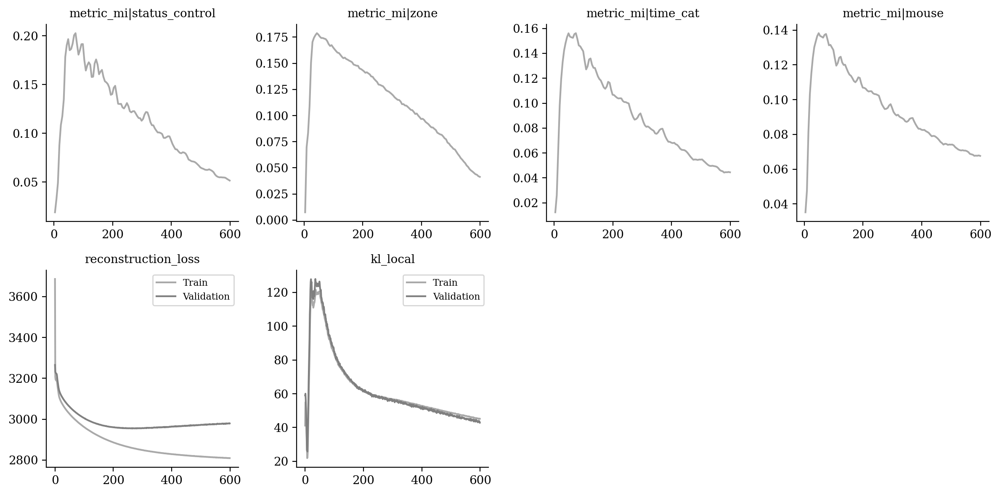

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

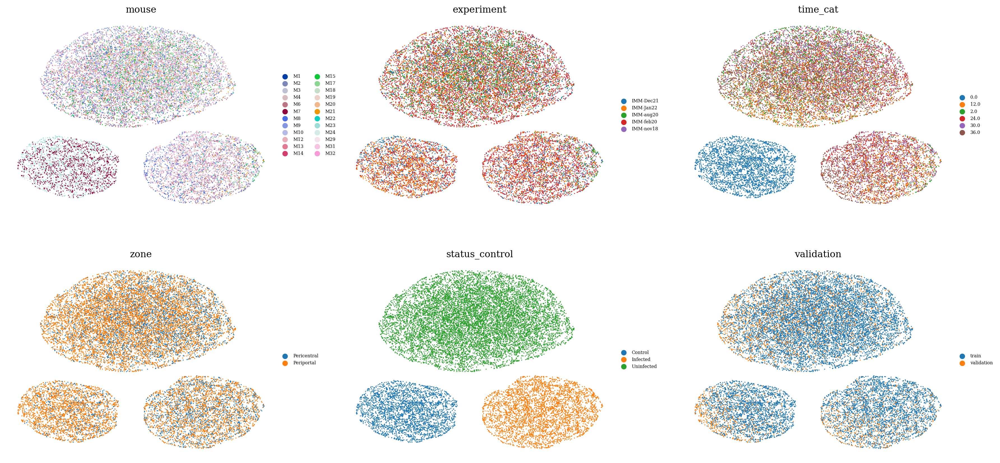

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

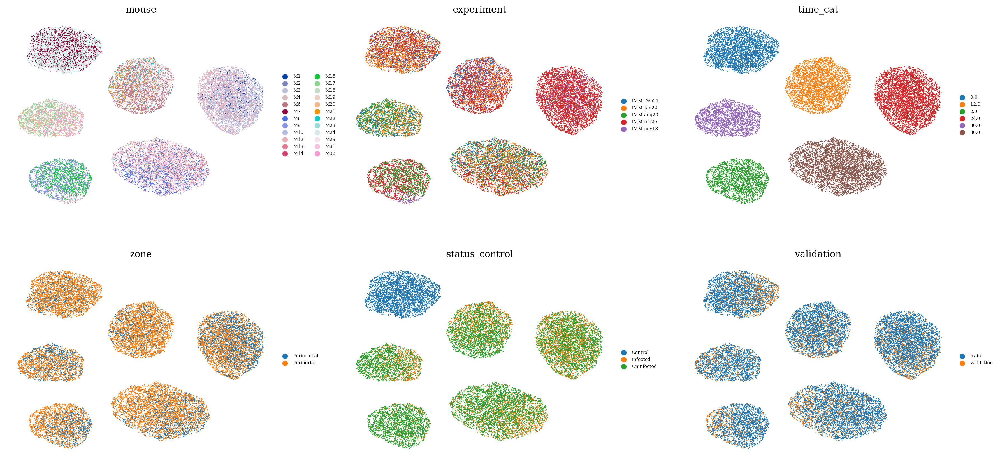

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

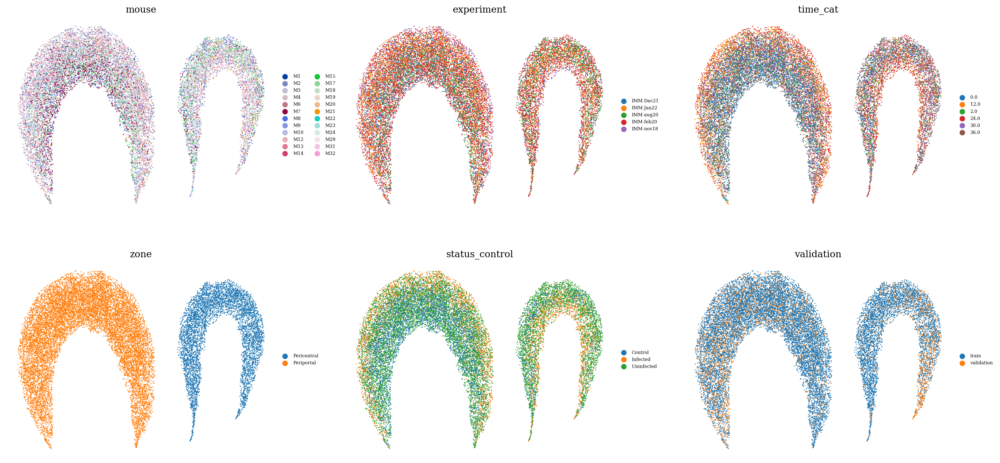

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

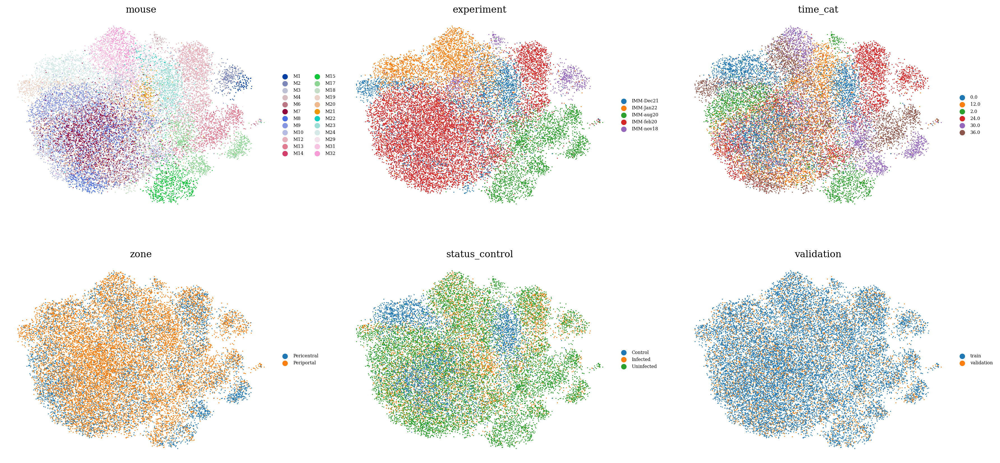

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

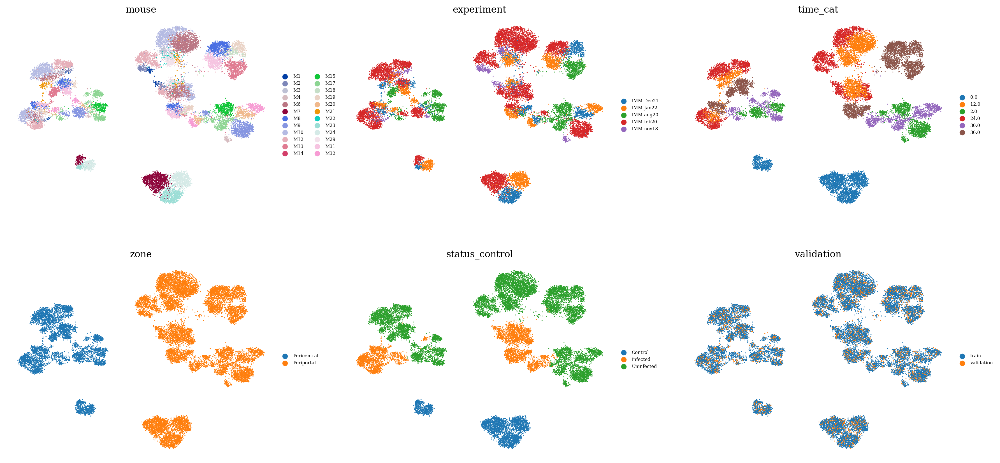

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

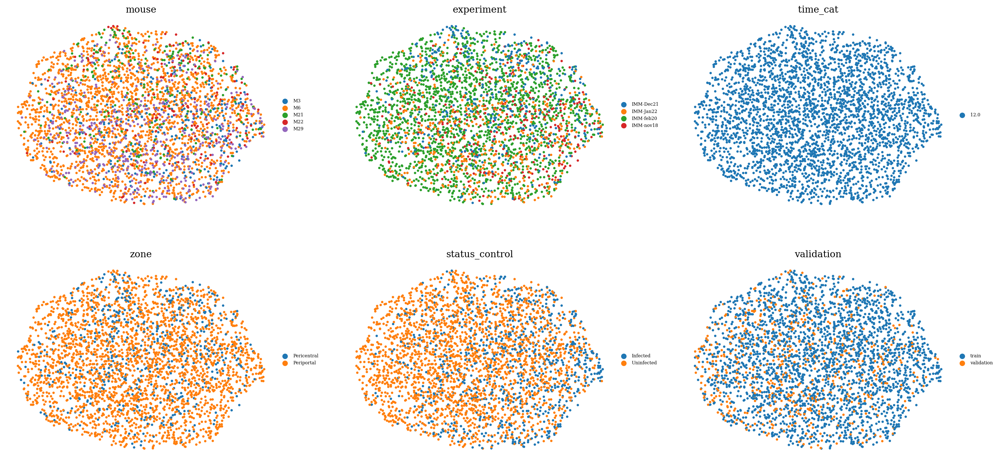

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )